# DESCRIÇÃO DO NOTEBOOK:

Este notebook foi construído para a realização do Trabalho de Conclusão de Curso da Especialização em Ciência de Dados da PUC-MINAS. 
O objetivo principal da pesquisa é na construção de algoritmos de inteligência artificial, principalmente modelos supervisionados de aprendizado de máquina e aprendizado profundo para conseguir estimar a concentração de parâmetros de qualidade da água por meio de informações de sensoriamento remoto.
Para o presente caso, serão utilizadas informações disponibilizadas:

1. No site do NOAA sobre a qualidade da água do Lago Erie e Lago Huron (USA).

•	Physical, chemical, and biological water quality data collected from a small boat in western Lake Erie, Great Lakes from 2012-05-15 to 2018-10-09;

•	Physical, chemical, and biological water quality data collected from a small boat in western Lake Erie, Great Lakes from 2019-04-30 to 2019-10-07;

•	Physical, chemical, and biological water quality data collected from a small boat in western Lake Erie, Great Lakes from 2020-06-16 to 2021-10-27;

•	Physical, chemical, and biological water quality data collected from a small boat in Saginaw Bay, Lake Huron, Great Lakes from 2012-06-07 to 2018-10-03;

•	Physical, chemical, and biological water quality data collected from a small boat in Saginaw Bay, Lake Huron, Great Lakes from 2019-05-30 to 2019-10-03;


2. Na plataforma de computação em nuvem sobre os registros radiométricos (reflectância).

https://code.earthengine.google.com/

# 1. IMPORTANDO MÓDULOS E BIBLIOTECAS

In [1]:
# manipulação de dados
import json
import numpy as np
import pandas as pd

# visualização geoespacial
import folium
from folium import Choropleth, Circle, Marker, Icon, Popup
from folium.plugins import HeatMap, MarkerCluster
from folium.features import GeoJsonPopup, GeoJsonTooltip

# plotagem (gráficos)
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import patches

#análise geospacial
import ee
import collections
import geopandas as gpd
import geemap
import geemap.colormaps as colormaps

#manipulação de datas
from datetime import datetime

#manipulação de pastas do windows
import os

#estatística
import statistics
from statistics import mean
import scipy
from scipy.optimize import curve_fit
from scipy.stats import spearmanr
from scipy.stats import zscore

#regressões, métricas e modelos
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split #split database in training and testing data
from sklearn.metrics import * #accuracy_metrics
from sklearn.ensemble import RandomForestRegressor #randomforest regression
from sklearn.linear_model import LinearRegression #linear regression or multiple linear regression
from sklearn.linear_model import Lasso
from sklearn.neural_network import MLPRegressor #neural network
from sklearn.preprocessing import PolynomialFeatures
from sklearn.svm import SVR #svm regression
from sklearn.model_selection import cross_validate
from sklearn.model_selection import GridSearchCV, RepeatedKFold
from sklearn.dummy import DummyRegressor
from sklearn.metrics import r2_score, make_scorer
from xgboost import XGBRegressor

# 2. IMPORTANDO OS DADOS DE QUALIDADE DA ÁGUA

## 2.1 Importando os arquivos no formato separados por vírgula

In [93]:
dis = r'E:\PUC-MINAS\CIENCIA DE DADOS\16 - TCC - Ciência de Dados e Big Data (2021)\Dados'

df_1 = pd.read_csv(os.path.join(dis, 'lake_erie_habs_field_sampling_results_2012_2018_v2.csv'), encoding="ISO-8859-1")
df_2 = pd.read_csv(os.path.join(dis, 'lake_erie_habs_field_sampling_results_2019.csv'), encoding="ISO-8859-1")
df_3 = pd.read_csv(os.path.join(dis, 'saginaw_bay_habs_2012_2018_v2.csv'), encoding="ISO-8859-1")
df_4 = pd.read_csv(os.path.join(dis, 'saginaw_bay_habs_field_sampling_results_2019.csv'), encoding="ISO-8859-1")
df_5 = pd.read_csv(os.path.join(dis, 'noaa-glerl-erie-habs-field-sampling-results-2020-2021.csv'), encoding="ISO-8859-1")


## 2.2 Imprimindo os dataframes

In [94]:
df_1.head()

,Date,Site,Station Depth (m),Sample Depth (m),Sample Depth (category),Local Time (Eastern Time Zone),Latitude (decimal deg),Longitude (decimal deg),Wind speed (knots),Wave Height (ft),...,Soluble Reactive Phosphorus (µg P/L),Ammonia (µg N/L),Nitrate + Nitrite (mg N/L),Urea (µg N/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Dissolved Organic Carbon (mg/L),Colored Dissolved Organic Material absorbance (m-1) at 400nm,Total Suspended Solids (mg/L),Volatile Suspended Solids (mg/L)
0,5/15/2012,WE2,5.1,0.75,Surface,10:40,41.0127,-83.0055,NaN,NaN,...,3.23,10.22,0.459,NaN,NaN,NaN,2.88,NaN,3.47,1.11
1,5/15/2012,WE4,10.0,0.75,Surface,10:08,41.8267,-83.1933,NaN,NaN,...,2.02,28.79,0.325,NaN,0.34,0.05,1.80,NaN,3.15,1.01
2,5/15/2012,WE6,2.7,0.75,Surface,11:02,41.7052,-83.3853,NaN,NaN,...,2.97,35.7,0.515,NaN,0.40,0.08,4.35,NaN,2.90,0.98
3,5/15/2012,WE8,4.5,0.75,Surface,11:31,41.8339,-83.3640,NaN,NaN,...,3.02,11.28,0.513,NaN,0.49,0.12,2.53,NaN,4.32,1.06
4,5/31/2012,WE2,8.2,0.75,Surface,11:15,41.7625,-83.3286,NaN,NaN,...,5.15,14.68,0.466,NaN,0.50,0.07,2.80,NaN,21.42,2.40


In [95]:
df_2.head()

,Date,Site,Station Depth (m),Sample Depth (m),Sample Depth (category),Local Time (Eastern Time Zone),Latitude (decimal deg),Longitude (decimal deg),Wind speed (knots),Wave Height (ft),...,Total Phosphorus (µg P/L),Total Dissolved Phosphorus (µg P/L),Soluble Reactive Phosphorus (µg P/L),Ammonia (µg N/L),Nitrate + Nitrite (mg N/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Colored Dissolved Organic Material absorbance (m-1) at 400nm,Total Suspended Solids (mg/L),Volatile Suspended Solids (mg/L)
0,4/30/2019,WE2,5.90,0.75,Surface,11:41,41.7634,-83.3302,NaN,NaN,...,330.67,81.72,77.04,54.25,2.55,5.53,0.77,4.48,172.40,20.60
1,4/30/2019,WE2,NaN,5.50,Bottom,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,4/30/2019,WE4,8.95,0.75,Surface,9:57,41.8275,-83.1931,NaN,NaN,...,19.94,6.48,5.05,62.40,0.446,0.81,0.08,0.43,8.96,1.48
3,4/30/2019,WE8,5.19,0.75,Surface,9:01,41.8343,-83.3594,NaN,NaN,...,86.72,23.51,19.12,12.73,1.817,2.66,0.27,1.40,38.37,4.53
4,4/30/2019,WE8,NaN,4.60,Bottom,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [96]:
df_3.head()

,Date,Site,Station\nDepth\n(m),Sample\nDepth\n(m),Sample Depth (category),Time,Latitude\n(decimal degrees),Longitude\n(decimal degrees),Sky,Secchi\nDepth\n(m),...,Soluble Reactive Phosphorus (µg/L),Ammonia (µg/L),Nitrate + Nitrite (mg/L),Urea (µg/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Dissolved Organic Carbon (mg/L),Colored Dissolved Organic Material absorbance (m-1) at 400nm,Total Suspended Solids (mg/L),Volatile Suspended Solids (mg/L)
0,6/7/2012,SB1,3.0,0.75,Surface,10:45,43.6400,-83.6614,clear,2.5,...,0.33,14,6.327,NaN,0.359,0.050,6.03,NaN,2.58,0.85
1,6/7/2012,SB2,3.1,0.75,Surface,11:18,43.6672,-83.8045,NaN,1.3,...,4.88,81.57,11.69,NaN,0.849,0.131,8.96,NaN,6.17,1.57
2,6/7/2012,SB5,2.8,0.75,Surface,12:10,43.8955,-83.8606,clear,2.8,...,<0.25,24.49,1.3,NaN,0.170,0.023,3.66,NaN,1.03,0.29
3,6/7/2012,SB14,3.5,0.75,Surface,10:13,43.7377,-83.6411,clear,2.5,...,0.37,3.38,2.307,NaN,0.775,0.091,5.10,NaN,3.43,1.52
4,8/2/2012,SB1,3.1,0.75,Surface,10:39,43.6400,-83.6599,cloudy,0.7,...,0.5,1.2,0.388,NaN,2.438,0.378,5.40,NaN,18.30,9.70


In [97]:
df_4.head()

,Date,Site,Station\nDepth\n(m),Sample\nDepth\n(m),Sample Depth (category),Time,Latitude\n(decimal degrees),Longitude\n(decimal degrees),Sky,Secchi\nDepth\n(m),...,Total Phosphorus (µg/L),Total Dissolved Phosphorus (µg/L),Soluble Reactive Phosphorus (µg/L),Ammonia (µg/L),Nitrate + Nitrite (mg/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Colored Dissolved Organic Material absorbance (m-1) at 400nm,Total Suspended Solids (mg/L),Volatile Suspended Solids (mg/L)
0,5/30/2019,SB1,3.8,0.75,Surface,12:14,43.6402,-83.6616,overcast,3.50,...,18.65,1.50,0.69,9.33,0.489,0.40,0.06,0.84,2.10,0.49
1,5/30/2019,SB2,4.0,0.75,Surface,12:49,43.6675,-83.8071,hazy,0.75,...,46.54,17.36,17.19,81.08,1.988,0.51,0.07,5.12,7.36,1.09
2,5/30/2019,SB4,6.0,0.75,Surface,8:26,43.7378,-83.8771,overcast,1.00,...,24.59,7.50,2.77,36.33,0.777,0.60,0.09,2.22,8.02,1.55
3,5/30/2019,SB5,4.0,0.75,Surface,9:14,43.8952,-83.8605,overcast,4.00,...,7.70,5.29,1.00,35.17,0.501,0.26,0.05,1.16,1.40,0.33
4,5/30/2019,SB14,3.7,0.75,Surface,11:32,43.7388,-83.6405,hazy,3.50,...,4.34,4.18,0.35,13.22,0.355,0.22,0.02,0.43,1.60,0.83


In [98]:
df_5.head()

,date,station_name,station_depth_m,sample_depth_m,sample_depth_category,time,lat,lon,wind_speed,wave_height,...,total_p,total_dissolved_p,soluble_reactive_p,ammonia,nitrate_nitrite,particulate_organic_c,particulate_organic_n,cdom,tss,vss
0,6/16/2020,WE2,6.18,0.75,Surface,8:45,41.7637,-83.3286,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,6/16/2020,WE2,NaN,5.50,Bottom,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,6/16/2020,WE6,3.45,0.75,Surface,9:58,41.7054,-83.3864,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,6/16/2020,WE8,5.45,0.75,Surface,8:14,41.8349,-83.3587,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,6/16/2020,WE8,NaN,4.80,Bottom,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [99]:
columns_rename = {}

for i in df_3.columns:
    columns_rename[i] = i.replace("\n", " ")
df_3.rename(columns = columns_rename, inplace=True)

In [100]:
columns_rename = {}

for i in df_4.columns:
    columns_rename[i] = i.replace("\n", " ")
df_4.rename(columns = columns_rename, inplace=True)

In [101]:
df_3.head()

,Date,Site,Station Depth (m),Sample Depth (m),Sample Depth (category),Time,Latitude (decimal degrees),Longitude (decimal degrees),Sky,Secchi Depth (m),...,Soluble Reactive Phosphorus (µg/L),Ammonia (µg/L),Nitrate + Nitrite (mg/L),Urea (µg/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Dissolved Organic Carbon (mg/L),Colored Dissolved Organic Material absorbance (m-1) at 400nm,Total Suspended Solids (mg/L),Volatile Suspended Solids (mg/L)
0,6/7/2012,SB1,3.0,0.75,Surface,10:45,43.6400,-83.6614,clear,2.5,...,0.33,14,6.327,NaN,0.359,0.050,6.03,NaN,2.58,0.85
1,6/7/2012,SB2,3.1,0.75,Surface,11:18,43.6672,-83.8045,NaN,1.3,...,4.88,81.57,11.69,NaN,0.849,0.131,8.96,NaN,6.17,1.57
2,6/7/2012,SB5,2.8,0.75,Surface,12:10,43.8955,-83.8606,clear,2.8,...,<0.25,24.49,1.3,NaN,0.170,0.023,3.66,NaN,1.03,0.29
3,6/7/2012,SB14,3.5,0.75,Surface,10:13,43.7377,-83.6411,clear,2.5,...,0.37,3.38,2.307,NaN,0.775,0.091,5.10,NaN,3.43,1.52
4,8/2/2012,SB1,3.1,0.75,Surface,10:39,43.6400,-83.6599,cloudy,0.7,...,0.5,1.2,0.388,NaN,2.438,0.378,5.40,NaN,18.30,9.70


In [102]:
df_4.head()

,Date,Site,Station Depth (m),Sample Depth (m),Sample Depth (category),Time,Latitude (decimal degrees),Longitude (decimal degrees),Sky,Secchi Depth (m),...,Total Phosphorus (µg/L),Total Dissolved Phosphorus (µg/L),Soluble Reactive Phosphorus (µg/L),Ammonia (µg/L),Nitrate + Nitrite (mg/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Colored Dissolved Organic Material absorbance (m-1) at 400nm,Total Suspended Solids (mg/L),Volatile Suspended Solids (mg/L)
0,5/30/2019,SB1,3.8,0.75,Surface,12:14,43.6402,-83.6616,overcast,3.50,...,18.65,1.50,0.69,9.33,0.489,0.40,0.06,0.84,2.10,0.49
1,5/30/2019,SB2,4.0,0.75,Surface,12:49,43.6675,-83.8071,hazy,0.75,...,46.54,17.36,17.19,81.08,1.988,0.51,0.07,5.12,7.36,1.09
2,5/30/2019,SB4,6.0,0.75,Surface,8:26,43.7378,-83.8771,overcast,1.00,...,24.59,7.50,2.77,36.33,0.777,0.60,0.09,2.22,8.02,1.55
3,5/30/2019,SB5,4.0,0.75,Surface,9:14,43.8952,-83.8605,overcast,4.00,...,7.70,5.29,1.00,35.17,0.501,0.26,0.05,1.16,1.40,0.33
4,5/30/2019,SB14,3.7,0.75,Surface,11:32,43.7388,-83.6405,hazy,3.50,...,4.34,4.18,0.35,13.22,0.355,0.22,0.02,0.43,1.60,0.83


## Adjusting dataframe columns

In [103]:
columns_rename = {'Latitude (decimal degrees)': 'Latitude (decimal deg)',
                  'Longitude (decimal degrees)': 'Longitude (decimal deg)',
                  'Extracted Chlorophyll ? (µg/L)': 'Extracted Chlorophyll a (µg/L)', 
                  'Time': 'Local Time (Eastern Time Zone)', 
                  'CTD Transmission (%)': 'CTD Tramission (%)', 
                  'Total Phosphorus (µg/L)': 'Total Phosphorus (µg P/L)',
                  'Total Dissolved Phosphorus (µg/L)': 'Total Dissolved Phosphorus (µg P/L)',
                  'Soluble Reactive Phosphorus (µg/L)': 'Soluble Reactive Phosphorus (µg P/L)',
                  'Ammonia (µg/L)': 'Ammonia (µg N/L)',
                  'Nitrate + Nitrite (mg/L)': 'Nitrate + Nitrite (mg N/L)',
                  'Urea (µg/L)': 'Urea (µg N/L)'
                  }
df_3.rename(columns = columns_rename, inplace=True)
df_4.rename(columns = columns_rename, inplace=True)

In [104]:
##as colunas no df_2 são iguais ao df_5, portando renomeando as colunas no df_5.
df_5.columns = df_2.columns
df_5.head(1)

,Date,Site,Station Depth (m),Sample Depth (m),Sample Depth (category),Local Time (Eastern Time Zone),Latitude (decimal deg),Longitude (decimal deg),Wind speed (knots),Wave Height (ft),...,Total Phosphorus (µg P/L),Total Dissolved Phosphorus (µg P/L),Soluble Reactive Phosphorus (µg P/L),Ammonia (µg N/L),Nitrate + Nitrite (mg N/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Colored Dissolved Organic Material absorbance (m-1) at 400nm,Total Suspended Solids (mg/L),Volatile Suspended Solids (mg/L)
0,6/16/2020,WE2,6.18,0.75,Surface,8:45,41.7637,-83.3286,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## 2.3 Juntando dataframes

In [105]:
df_m = pd.concat([df_1, df_2, df_3, df_4, df_5], axis = 0).reset_index(drop=True)
df_m

,Date,Site,Station Depth (m),Sample Depth (m),Sample Depth (category),Local Time (Eastern Time Zone),Latitude (decimal deg),Longitude (decimal deg),Wind speed (knots),Wave Height (ft),...,Soluble Reactive Phosphorus (µg P/L),Ammonia (µg N/L),Nitrate + Nitrite (mg N/L),Urea (µg N/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Dissolved Organic Carbon (mg/L),Colored Dissolved Organic Material absorbance (m-1) at 400nm,Total Suspended Solids (mg/L),Volatile Suspended Solids (mg/L)
0,5/15/2012,WE2,5.10,0.75,Surface,10:40,41.0127,-83.0055,NaN,NaN,...,3.23,10.22,0.459,NaN,NaN,NaN,2.88,NaN,3.47,1.11
1,5/15/2012,WE4,10.00,0.75,Surface,10:08,41.8267,-83.1933,NaN,NaN,...,2.02,28.79,0.325,NaN,0.34,0.05,1.80,NaN,3.15,1.01
2,5/15/2012,WE6,2.70,0.75,Surface,11:02,41.7052,-83.3853,NaN,NaN,...,2.97,35.7,0.515,NaN,0.40,0.08,4.35,NaN,2.90,0.98
3,5/15/2012,WE8,4.50,0.75,Surface,11:31,41.8339,-83.3640,NaN,NaN,...,3.02,11.28,0.513,NaN,0.49,0.12,2.53,NaN,4.32,1.06
4,5/31/2012,WE2,8.20,0.75,Surface,11:15,41.7625,-83.3286,NaN,NaN,...,5.15,14.68,0.466,NaN,0.50,0.07,2.80,NaN,21.42,2.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2179,10/27/2021,WE2,5.70,0.75,Surface,8:50,41.7629,-83.3305,7.97,1.31,...,15.63,31.91,0.661,NaN,1.17,0.12,NaN,1.32,16.12,1.96
2180,10/27/2021,WE2,NaN,5.10,Bottom,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2181,10/27/2021,WE6,2.88,0.75,Surface,9:16,41.7067,-83.3840,5.83,1.31,...,122.11,89.94,4.165,NaN,1.93,0.21,NaN,7.01,38.40,4
2182,10/27/2021,WE8,4.99,0.75,Surface,8:26,41.8330,-83.3614,9.91,1.31,...,23.61,55.62,1.805,NaN,0.60,0.09,NaN,2.13,6.44,1.08


## 2.4 Filtrando apenas valores medidos na superfície

In [106]:
# filtering only surface data
df_s = df_m.copy(deep=True)

df_s = df_s.loc[df_s['Sample Depth (category)'] == 'Surface', :]
df_s

,Date,Site,Station Depth (m),Sample Depth (m),Sample Depth (category),Local Time (Eastern Time Zone),Latitude (decimal deg),Longitude (decimal deg),Wind speed (knots),Wave Height (ft),...,Soluble Reactive Phosphorus (µg P/L),Ammonia (µg N/L),Nitrate + Nitrite (mg N/L),Urea (µg N/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Dissolved Organic Carbon (mg/L),Colored Dissolved Organic Material absorbance (m-1) at 400nm,Total Suspended Solids (mg/L),Volatile Suspended Solids (mg/L)
0,5/15/2012,WE2,5.10,0.75,Surface,10:40,41.0127,-83.0055,NaN,NaN,...,3.23,10.22,0.459,NaN,NaN,NaN,2.88,NaN,3.47,1.11
1,5/15/2012,WE4,10.00,0.75,Surface,10:08,41.8267,-83.1933,NaN,NaN,...,2.02,28.79,0.325,NaN,0.34,0.05,1.80,NaN,3.15,1.01
2,5/15/2012,WE6,2.70,0.75,Surface,11:02,41.7052,-83.3853,NaN,NaN,...,2.97,35.7,0.515,NaN,0.40,0.08,4.35,NaN,2.90,0.98
3,5/15/2012,WE8,4.50,0.75,Surface,11:31,41.8339,-83.3640,NaN,NaN,...,3.02,11.28,0.513,NaN,0.49,0.12,2.53,NaN,4.32,1.06
4,5/31/2012,WE2,8.20,0.75,Surface,11:15,41.7625,-83.3286,NaN,NaN,...,5.15,14.68,0.466,NaN,0.50,0.07,2.80,NaN,21.42,2.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2176,10/18/2021,WE13,9.02,0.75,Surface,9:05,41.7433,-83.1357,6.03,0.66,...,5.91,21.77,0.319,NaN,0.42,0.08,NaN,0.38,6.60,0.26
2178,10/18/2021,WE16,5.99,0.75,Surface,9:34,41.6579,-83.1387,7.78,0.98,...,15.09,26.22,0.14,NaN,0.99,0.18,NaN,1.04,10.44,1.74
2179,10/27/2021,WE2,5.70,0.75,Surface,8:50,41.7629,-83.3305,7.97,1.31,...,15.63,31.91,0.661,NaN,1.17,0.12,NaN,1.32,16.12,1.96
2181,10/27/2021,WE6,2.88,0.75,Surface,9:16,41.7067,-83.3840,5.83,1.31,...,122.11,89.94,4.165,NaN,1.93,0.21,NaN,7.01,38.40,4


## 2.5 Renomeando colunas e ajustando dtypes do dataframe

In [107]:
df_s.rename(columns = {'Colored Dissolved Organic Material absorbance (m-1) at 400nm ': 'CDOM 400 nm (m-1)', 
                       'Extracted Chlorophyll a (µg/L)': 'Chla (µg/L)', 
                       'Total Suspended Solids (mg/L)': 'TSS (mg/L)', 
                       'Secchi Depth (m)': 'SDD (m)'}, inplace=True)

In [108]:
df_s.dtypes

Date                                                  object
Site                                                  object
Station Depth (m)                                    float64
Sample Depth (m)                                     float64
Sample Depth (category)                               object
Local Time (Eastern Time Zone)                        object
Latitude (decimal deg)                               float64
Longitude (decimal deg)                              float64
Wind speed (knots)                                    object
Wave Height (ft)                                     float64
Sky                                                   object
SDD (m)                                               object
Sample Temperature (°C)                              float64
CTD Temperature (°C)                                 float64
CTD Specific Conductivity (µS/cm)                    float64
CTD Beam Attenuation (m-1)                            object
CTD Tramission (%)      

In [109]:
for col in df_s.columns[11:]:
    lista_temp=[]
    for item in df_s[col]:
        i=str(item)
        a=i.replace('<', '').replace(',','.').replace('-', '')
        lista_temp.append(a)
    df_s[col]=lista_temp
    df_s[col]=pd.to_numeric(df_s[col], errors='coerce')
    
df_s.iloc[:, 11:].dtypes

SDD (m)                                              float64
Sample Temperature (°C)                              float64
CTD Temperature (°C)                                 float64
CTD Specific Conductivity (µS/cm)                    float64
CTD Beam Attenuation (m-1)                           float64
CTD Tramission (%)                                   float64
CTD Dissolved Oxygen (mg/L)                          float64
CTD Photosynthetically Active Radiation (µE/m2/s)    float64
Turbidity (NTU)                                      float64
Particulate Microcystin (µg/L)                       float64
Dissolved Microcystin (µg/L)                         float64
Extracted Phycocyanin (µg/L)                         float64
Chla (µg/L)                                          float64
Total Phosphorus (µg P/L)                            float64
Total Dissolved Phosphorus (µg P/L)                  float64
Soluble Reactive Phosphorus (µg P/L)                 float64
Ammonia (µg N/L)        

In [110]:
df_s.head()

,Date,Site,Station Depth (m),Sample Depth (m),Sample Depth (category),Local Time (Eastern Time Zone),Latitude (decimal deg),Longitude (decimal deg),Wind speed (knots),Wave Height (ft),...,Soluble Reactive Phosphorus (µg P/L),Ammonia (µg N/L),Nitrate + Nitrite (mg N/L),Urea (µg N/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Dissolved Organic Carbon (mg/L),CDOM 400 nm (m-1),TSS (mg/L),Volatile Suspended Solids (mg/L)
0,5/15/2012,WE2,5.1,0.75,Surface,10:40,41.0127,-83.0055,NaN,NaN,...,3.23,10.22,0.459,NaN,NaN,NaN,2.88,NaN,3.47,1.11
1,5/15/2012,WE4,10.0,0.75,Surface,10:08,41.8267,-83.1933,NaN,NaN,...,2.02,28.79,0.325,NaN,0.34,0.05,1.80,NaN,3.15,1.01
2,5/15/2012,WE6,2.7,0.75,Surface,11:02,41.7052,-83.3853,NaN,NaN,...,2.97,35.70,0.515,NaN,0.40,0.08,4.35,NaN,2.90,0.98
3,5/15/2012,WE8,4.5,0.75,Surface,11:31,41.8339,-83.3640,NaN,NaN,...,3.02,11.28,0.513,NaN,0.49,0.12,2.53,NaN,4.32,1.06
4,5/31/2012,WE2,8.2,0.75,Surface,11:15,41.7625,-83.3286,NaN,NaN,...,5.15,14.68,0.466,NaN,0.50,0.07,2.80,NaN,21.42,2.40


In [111]:
df_s.loc[:, 'Date'] = pd.to_datetime(df_s['Date'] + " " + df_s['Local Time (Eastern Time Zone)'], format='%m/%d/%Y %H:%M')

## 2.6 Removendo valores nulos de Latitude e Longitude

In [112]:
## dropping null latitude or longitude rows
df_s.dropna(axis = 0, subset=['Longitude (decimal deg)', 'Latitude (decimal deg)'], inplace=True)
df_s.loc[:, ['Longitude (decimal deg)', 'Latitude (decimal deg)']].isnull().sum()

Longitude (decimal deg)    0
Latitude (decimal deg)     0
dtype: int64

## 2.7 Reinicializando o índice

In [113]:
df_s.reset_index(inplace=True, drop=True)
df_s.head()

,Date,Site,Station Depth (m),Sample Depth (m),Sample Depth (category),Local Time (Eastern Time Zone),Latitude (decimal deg),Longitude (decimal deg),Wind speed (knots),Wave Height (ft),...,Soluble Reactive Phosphorus (µg P/L),Ammonia (µg N/L),Nitrate + Nitrite (mg N/L),Urea (µg N/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Dissolved Organic Carbon (mg/L),CDOM 400 nm (m-1),TSS (mg/L),Volatile Suspended Solids (mg/L)
0,2012-05-15 10:40:00,WE2,5.1,0.75,Surface,10:40,41.0127,-83.0055,NaN,NaN,...,3.23,10.22,0.459,NaN,NaN,NaN,2.88,NaN,3.47,1.11
1,2012-05-15 10:08:00,WE4,10.0,0.75,Surface,10:08,41.8267,-83.1933,NaN,NaN,...,2.02,28.79,0.325,NaN,0.34,0.05,1.80,NaN,3.15,1.01
2,2012-05-15 11:02:00,WE6,2.7,0.75,Surface,11:02,41.7052,-83.3853,NaN,NaN,...,2.97,35.70,0.515,NaN,0.40,0.08,4.35,NaN,2.90,0.98
3,2012-05-15 11:31:00,WE8,4.5,0.75,Surface,11:31,41.8339,-83.3640,NaN,NaN,...,3.02,11.28,0.513,NaN,0.49,0.12,2.53,NaN,4.32,1.06
4,2012-05-31 11:15:00,WE2,8.2,0.75,Surface,11:15,41.7625,-83.3286,NaN,NaN,...,5.15,14.68,0.466,NaN,0.50,0.07,2.80,NaN,21.42,2.40


## 2.8 Dataset size

In [114]:
df_s.shape

(1574, 36)

# 3. CONSTRUÇÃO DO DATAFRAME DE REFLECTÂNCIAS

- Para a construção desse dataframe, ressalta-se a relevância da API em Python com o Google Earth Engine que permite acessar o sistema de computação em nuvem que possui diversos datasets de informações de sensoriamento remoto disponíveis.

- O acesso é realizado por meio da autenticação e inicialização com identificação. 

- Para saber mais, sugiro a leitura dos seguintes referenciais:

https://earthengine.google.com/

https://developers.google.com/earth-engine/tutorials/community/intro-to-python-api

## 3.1 Inicialização e autenticação do GEE

In [71]:
collections.Callable = collections.abc.Callable
#ee.Authenticate()
ee.Initialize()

Enter verification code:  4/1AdQt8qj_HsUwxJS2aHdAkzAZDllJKSjSYoaoliG3LE7pYKNjve043uM6BBI



Successfully saved authorization token.


## 3.2 Construção de métodos no GEE

### 3.2.1 Método de obtenção de estatísticas zonais

In [25]:
def zonal_statistics(ic, fc, params):
    '''
    Reduce region of a image and reduce that region to the statistics metrics desired
    
    Parameters
    ----------
    ic: ee.image.ImageCollection
        image collection (GEE)
    fc: ee.Feature.FeatureCollection
        feature collection (GEE)
    params: dict
        Main parameters for the function
    
    Returns
    ---------
    results: ee.feature.FeatureCollection
        Feature with the reduce information for each point
    '''
    
    _params = {
        'reducer': ee.Reducer.mean(),
        'scale': None,
        'crs': None,
        'bands': None,
        'bandsRename': None,
        'imgProps': None,
        'imgPropsRename': None,
        'datetimeName': 'datetime',
        'datetimeFormat': 'YYYY-MM-dd HH:mm:ss'
  } 
    
    if params: #if params are entered
        for param in params: #iterate over params
            _params[param] = params[param] #assign to the params values the param attribute


    def func_cwj(img):
        '''
        Desinging reduced regions array. 
        
        Parameters
        ----------
        img: ee.image.Image
        
        Returns
        ---------
        img.reduceRegions: ee.image.ImageCollection
            Return images with reduced regions
        '''
        # Select bands (optionally rename), set a datetime & timestamp property.
        #rename bands
        #set the datetime key and value by retrieving the img date
        #set the time stamp by retrieving the timestamp in the image
        img = ee.Image(img.select(_params['bands'], _params['bandsRename'])) \
        .set(_params['datetimeName'], img.date().format(_params['datetimeFormat'])) \
        .set('timestamp', img.get('system:time_start')) 

        propsFrom = ee.List(_params['imgProps']) \
        .cat(ee.List([_params['datetimeName'], 'timestamp']))
        propsTo = ee.List(_params['imgPropsRename']) \
        .cat(ee.List([_params['datetimeName'], 'timestamp']))
        imgProps = img.toDictionary(propsFrom).rename(propsFrom, propsTo) 
        # Subset points that intersect the given image.
        fcSub = fc.filterBounds(img.geometry()) #check what points are in the image
        # Reduce the image by regions.
        return img.reduceRegions(**{ 
            'collection': fcSub,
            'reducer': _params['reducer'],
            'scale': _params['scale'],
            'crs': _params['crs']            
        }).map(lambda f: f.set(imgProps))
    results = ic.map(func_cwj).flatten() \
    .filter(ee.Filter.notNull(_params['bandsRename'])) 
    ##store in the variable results the feature collection with the reduced regions that has values
    return results

### 3.2.2 Método de filtragem de nuvens e escala das informações de reflectância

In [80]:
def maskl8clouds(image):
    '''
    Create mask for cloudy pixels and scale pixels to 
    respective reflectance (%) values for Landsat-8
    SR images.
    
    Parameters
    -----------
    image: ee.image.Image
        Google Earth Engine Image

        
    Returns
    -----------
    image: ee.image.Image
        Google Earth Engine Image
    
    '''
    
    cloudShadowBitMask = 1 << 3
    cloudsBitMask = 1 << 5
    
    
    qa_mask = image.select("QA_PIXEL").bitwise_and(cloudShadowBitMask).eq(0)
    saturation_mask = image.select("QA_PIXEL").bitwise_and(cloudsBitMask).eq(0)
    
    opticalBands = image.select('SR_B.').multiply(0.0000275).add(-0.2)
    thermalBands = image.select('ST_B.*').multiply(0.00341802).add(149.0)
    
    
    return image.addBands(opticalBands, None, True) \
                .addBands(thermalBands, None, True) \
                .updateMask(qa_mask) \
                .updateMask(saturation_mask) \
                .copyProperties(image, ['LANDSAT_PRODUCT_ID', 'SPACECRAFT_ID', 'system:time_start'])

### 3.2.3 Método para visualização de informações geospaciais

In [79]:
def Mapdisplay(center, dicc, Tiles="OpensTreetMap",zoom_start=10, vis_params={}, tooltip_column={}):
    '''
    Display Google Earth Engine features and images in Folium library maps
    
    Parameters
    ----------
    center: list of coordinates or variable with coordinates
        Center of the map (Latitude and Longitude).
    dicc: ee.feature or ee.image
        Earth Engine Geometries or Tiles dictionary
    Tiles: Folium.tiles
        Example of tiles: Mapbox Bright,Mapbox Control Room,Stamen Terrain,Stamen Toner,stamenwatercolor,cartodbpositron.
    zoom_start: int
        Initial zoom level for the map.
    vis_params: dict
        Satellite visualization settings.
    tooltip_column: str 
        Column name to show in the tooltip. Normally the ID of points
        
    Returns
    ---------
    mapViz: folium.Map
         A folium.Map object.
    '''
    mapViz = folium.Map(location=center,tiles=Tiles, zoom_start=zoom_start, vis_params=vis_params)
    for k,v in dicc.items():
        if v.getInfo().get('type') == 'Image':
            map_id_dict = ee.Image(v).getMapId(vis_params)
            folium.TileLayer(
                tiles = map_id_dict["tile_fetcher"].url_format,
                attr  = 'Google Earth Engine',
                overlay =True,
                name  = k
            ).add_to(mapViz)
            
            
        else:
            folium.GeoJson(
                data = v.getInfo(),
                name = k,
                #popup = GeoJsonPopup(list(v.getInfo()['columns'].keys())[:-1], style='text-align:center'), to show popup, uncomment this line
                tooltip = GeoJsonTooltip(fields = [tooltip_column], labels = False)
            ).add_to(mapViz)
            
    #mapViz.add_child(folium.LayerControl())
    
    return mapViz


def add_ee_layer(self, ee_image_object, vis_params, name):
    """Adds a method for displaying Earth Engine image tiles to folium map."""
    map_id_dict = ee.Image(ee_image_object).getMapId(vis_params)
    folium.raster_layers.TileLayer(
        tiles=map_id_dict['tile_fetcher'].url_format,
        attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
        name=name,
        overlay=True,
        control=True
    ).add_to(self)

# Add Earth Engine drawing method to folium.
folium.Map.add_ee_layer = add_ee_layer

### 3.2.4 Método para construção de buffer

In [78]:
def createBuffer(feature, inner_size):
    '''
    Create squared (area) buffer around feature
    
    Parameters:
    -----------
    feature: ee.Feature,
        Google Earth Engine feature
    inner_size: int
        area to create a buffer on

    Returns
    -----------
    inner: ee.Feature 
        Google Earth Engine buffered feature
    '''
    inner = feature.buffer(ee.Number(inner_area).sqrt().divide(2), 1).bounds()
    return inner

### 3.2.5 Converter dataframe para FeatureCollection

In [76]:
def gdf_to_fc(gdf, latitude, longitude, props):
    '''
    Convert a geodataframe or dataframe to feature collection in GEE. 
    The method initiate dropping duplicates according to the name of the WQ stations.
    Then, it will iterate over the dataframe to create geometry points. 
    Finally, it will put all together and create the feature collection
    
    Parameters:
    -----------
    gdf - dataframe,
        the dataframe with the points
    latitude: str
        column name with latitude values
    longitude: str
        column name with longitude values
    *props: list
        list with columns to be passed as properties

    Returns
    -----------
    GEE Feature Collection
    '''
    
    #main variables
    df_wqp = gdf
        
    df_wqp = df_wqp.drop_duplicates(subset=[latitude, longitude])

    
## CONVERTING DATAFRAME TO FEATURE COLLECTION GEE
    lista_fc=[]
    for idx, row in df_wqp.iterrows():
        feature=ee.Feature(ee.Geometry.Point(json.loads("[{0}, {1}]".format(row[longitude], row[latitude]))))
        
        for num, i in enumerate(props):
            if type(row[i]) != float and type(row[i]) != int or np.isnan(row[i]):
                feature = feature.set(i, str(row[i]))
            else:
                feature = feature.set(i, row[i])
        lista_fc.append(feature)
    
    pts_mon = ee.FeatureCollection(lista_fc)
    
    del df_wqp, lista_fc
    
    return pts_mon

### 3.2.6 Converter timestamp para data

In [77]:
def timestamp(time):
    date = datetime.fromtimestamp(time/1000)
    return date

## 3.3 Utilizando os métodos construídos anteriormente para obter informações de reflectância para os pontos de monitoramento

### 3.3.1 Convertendo dataframe para FC

In [115]:
params = list(df_s.columns)
pts_mon = gdf_to_fc(df_s, 'Latitude (decimal deg)', 'Longitude (decimal deg)', params)

### 3.3.2 Criando buffer na região dos pontos de interesse

In [116]:
inner_area = (30*3)**2 #pixel size by number of pixels in row, squred to get area

pts_mon_buffer = pts_mon.map(lambda x: createBuffer(x, inner_area))

### 3.3.3 Plotando pontos e buffer criados

In [33]:
centroid = pts_mon.geometry().centroid().getInfo()['coordinates']
centroid.reverse()

map1 = folium.Map(location=centroid, zoom_start=9, tiles="OpensTreetMap")

df_temp = df_s.copy(deep=True)
df_temp = df_temp.astype(str).replace('nan',np.nan)

gdf = gpd.GeoDataFrame(df_temp, geometry=gpd.points_from_xy(df_temp['Longitude (decimal deg)'], df_temp['Latitude (decimal deg)']))
gdf.crs = "EPSG:4326"

popup = GeoJsonPopup(
    fields=list(gdf.columns)[:-1],
    localize=True,
    labels=True,
    style="""
        height:300px;
        background-color: #F0EFEF;
        border: 2px solid black;
        border-radius: 1px;
        box-shadow: 1px;
    """
)

tooltip = GeoJsonTooltip(
    fields=["Site"],
    localize=True,
    sticky=False,
    labels=False,
    style="""
        background-color: #F0EFEF;
        border: 2px solid black;
        border-radius: 1px;
        box-shadow: 1px;
    """,
    max_width=800,
)

marker = folium.CircleMarker(radius = 5,
                             weight = 0,
                             fill_color = '#000000',
                             fill_opacity = 1)

monitoring_points = folium.GeoJson(
    data=gdf,
    marker=marker,
    tooltip=tooltip,
    popup=popup,
    name = 'Pontos Monitoramento',
    zoom_on_click = True 
).add_to(map1)

buffer_geojson = folium.GeoJson(
    data = pts_mon_buffer.getInfo(),
    name = 'Buffer Pontos de Monitoramento',
    #popup = GeoJsonPopup(list(v.getInfo()['columns'].keys())[:-1], style='text-align:center'), to show popup, uncomment this line
    #tooltip = GeoJsonTooltip(fields = [tooltip_column], labels = False)
).add_to(map1)

l8_col = ee.ImageCollection("LANDSAT/LC08/C02/T1_L2") \
                            .filterBounds(pts_mon) \
                            .filterDate('2013-01-01', '2020-01-01') \
                            .filter(ee.Filter.calendarRange(4, 10, 'month')) \
                            .map(maskl8clouds)

l8_image_vis_params = {
    'min': 0.0,
    'max': 0.2,
    'bands': ['SR_B4', 'SR_B3', 'SR_B2']
}



map1.add_ee_layer(l8_col.median(), l8_image_vis_params, 'Imagem Landsat-8')

map1.add_child(folium.LayerControl())

map1



- Há a presença de pixels fora da água, que deverão ser removidos posteriormente

### 3.3.4 Reduzindo regiões para extrair as informações de reflectância por pixel.

In [34]:
l8_col = ee.ImageCollection("LANDSAT/LC08/C02/T1_L2") \
                            .filterBounds(pts_mon) \
                            .filterDate('2013-01-01', '2020-01-01') \
                            .filter(ee.Filter.calendarRange(4, 10, 'month')) \
                            .map(maskl8clouds)

print('Quantidade de imagens: {}'.format(l8_col.size().getInfo()))
# Define parameters for the zonalStats function.
params_l8 = {
  'reducer': ee.Reducer.mean(),
  'scale': 30,
  'crs': 'EPSG:4326',
  'bands': ['SR_B2', 'SR_B3', 'SR_B4', 'SR_B5', 'SR_B6', 'SR_B7', 'ST_B10', 'SR_QA_AEROSOL', 'QA_PIXEL'],
  'bandsRename': ['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'l8_temp', 'l8_aerosol', 'l8_pixel_qa'],
  'imgProps': ['LANDSAT_PRODUCT_ID', 'SPACECRAFT_ID'],
  'imgPropsRename': ['img_id', 'satellite'],
  'datetimeName': 'date',
  'datetimeFormat': 'YYYY-MM-dd'
}

data_l8 = zonal_statistics(l8_col, pts_mon_buffer, params_l8)

Quantidade de imagens: 611


## 3.5 Manipulando os dados obtidos para a construção de um dataframe

In [35]:
import math
df_pull = pd.DataFrame()

size = data_l8.size().getInfo()

n = math.ceil(size/5000)

k = 5000
m=0
for i in range(0, n+1):
    
    temp = data_l8.toList(k, m)
    
    info = temp.getInfo()
    
    for z in info:
        
        df_temp = pd.Series(z['properties']).to_frame().T       
        df_pull = pd.concat([df_pull, df_temp], axis = 0)
    
    print("Extracting {} of {}\n".format(i, n))
    try:
        print(" {} % complete\n".format(round((m/size) * (100),2)))
    except:
        print("first round")
              
    
    m += 5000
    
df_pull.head()

Extracting 0 of 25

 0.0 % complete

Extracting 1 of 25

 4.13 % complete

Extracting 2 of 25

 8.27 % complete

Extracting 3 of 25

 12.4 % complete

Extracting 4 of 25

 16.54 % complete

Extracting 5 of 25

 20.67 % complete

Extracting 6 of 25

 24.8 % complete

Extracting 7 of 25

 28.94 % complete

Extracting 8 of 25

 33.07 % complete

Extracting 9 of 25

 37.2 % complete

Extracting 10 of 25

 41.34 % complete

Extracting 11 of 25

 45.47 % complete

Extracting 12 of 25

 49.61 % complete

Extracting 13 of 25

 53.74 % complete

Extracting 14 of 25

 57.87 % complete

Extracting 15 of 25

 62.01 % complete

Extracting 16 of 25

 66.14 % complete

Extracting 17 of 25

 70.27 % complete

Extracting 18 of 25

 74.41 % complete

Extracting 19 of 25

 78.54 % complete

Extracting 20 of 25

 82.68 % complete

Extracting 21 of 25

 86.81 % complete

Extracting 22 of 25

 90.94 % complete

Extracting 23 of 25

 95.08 % complete

Extracting 24 of 25

 99.21 % complete

Extracting 25 of 

,Ammonia (µg N/L),CDOM 400 nm (m-1),CTD Beam Attenuation (m-1),CTD Dissolved Oxygen (mg/L),CTD Photosynthetically Active Radiation (µE/m2/s),CTD Specific Conductivity (µS/cm),CTD Temperature (°C),CTD Tramission (%),Chla (µg/L),Date,...,l8_blue,l8_green,l8_nir,l8_pixel_qa,l8_red,l8_swir1,l8_swir2,l8_temp,satellite,timestamp
0,28.79,nan,nan,nan,nan,nan,nan,nan,3.05,2012-05-15 10:08:00,...,0.078782,0.11574,0.002478,21952,0.087718,0.004508,0.006463,279.335943,LANDSAT_8,1366215131086
0,15.38,nan,nan,nan,nan,nan,nan,nan,4.86,2012-05-31 11:50:00,...,0.079016,0.116043,0.002733,21952,0.088027,0.004712,0.006626,279.35556,LANDSAT_8,1366215131086
0,1.91,nan,nan,nan,nan,nan,nan,nan,5.3,2012-06-11 11:59:00,...,0.078578,0.115368,0.002546,21952,0.087494,0.004476,0.006446,279.302906,LANDSAT_8,1366215131086
0,2.28,nan,nan,nan,nan,nan,nan,nan,17.57,2012-06-22 11:55:00,...,0.078608,0.115362,0.002407,21952,0.08747,0.004432,0.006405,279.306643,LANDSAT_8,1366215131086
0,4.77,nan,nan,nan,nan,nan,nan,nan,4.2,2012-07-12 11:05:00,...,0.078958,0.115506,0.002608,21952,0.087433,0.004637,0.006586,279.308822,LANDSAT_8,1366215131086


## Salvando em um pickle

In [36]:
#saving in a pickle to not have to run this again
df_pull.to_pickle('dados_extraidos_l8_col.pkl')

In [66]:
df_pull = pd.read_pickle('dados_extraidos_l8_col.pkl')

In [67]:
df_pull.shape

(120955, 49)

## 3.6 Ajustando os tipos das colunas do dataframe criado

In [68]:
##adjusting columns dtypes

df_pull = df_pull.apply(lambda x: pd.to_numeric(x, errors='ignore'))

df_pull['date']=pd.to_datetime(df_pull['date'])

df_pull['timestamp'] = df_pull['timestamp'].apply(timestamp)
df_pull.dtypes

Ammonia (µg N/L)                                             object
CDOM 400 nm (m-1)                                            object
CTD Beam Attenuation (m-1)                                   object
CTD Dissolved Oxygen (mg/L)                                  object
CTD Photosynthetically Active Radiation (µE/m2/s)            object
CTD Specific Conductivity (µS/cm)                            object
CTD Temperature (°C)                                         object
CTD Tramission (%)                                           object
Chla (µg/L)                                                  object
Date                                                         object
Dissolved Microcystin (µg/L)                                 object
Dissolved Organic Carbon (mg/L)                              object
Extracted Phycocyanin (µg/L)                                 object
Latitude (decimal deg)                                      float64
Local Time (Eastern Time Zone)                  

## 3.7 Reorganizando as colunas

In [69]:
df_pull.reset_index(inplace=True)

cols = ['img_id', 'satellite', 'Site', 'Latitude (decimal deg)', 'Longitude (decimal deg)', 'date', 'timestamp', 'l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'l8_temp', 'l8_aerosol', 'l8_pixel_qa']

df_pull = df_pull.loc[:, cols]

In [70]:
df_pull.head()

,img_id,satellite,Site,Latitude (decimal deg),Longitude (decimal deg),date,timestamp,l8_blue,l8_green,l8_red,l8_nir,l8_swir1,l8_swir2,l8_temp,l8_aerosol,l8_pixel_qa
0,LC08_L2SP_019031_20130417_20200912_02_T1,LANDSAT_8,WE4,41.8267,-83.1933,2013-04-17,2013-04-17 13:12:11.086,0.078782,0.115740,0.087718,0.002478,0.004508,0.006463,279.335943,218.677104,21952.0
1,LC08_L2SP_019031_20130417_20200912_02_T1,LANDSAT_8,WE4,41.8265,-83.1934,2013-04-17,2013-04-17 13:12:11.086,0.079016,0.116043,0.088027,0.002733,0.004712,0.006626,279.355560,218.628422,21952.0
2,LC08_L2SP_019031_20130417_20200912_02_T1,LANDSAT_8,WE4,41.8272,-83.1931,2013-04-17,2013-04-17 13:12:11.086,0.078578,0.115368,0.087494,0.002546,0.004476,0.006446,279.302906,218.612724,21952.0
3,LC08_L2SP_019031_20130417_20200912_02_T1,LANDSAT_8,WE4,41.8271,-83.1932,2013-04-17,2013-04-17 13:12:11.086,0.078608,0.115362,0.087470,0.002407,0.004432,0.006405,279.306643,218.612724,21952.0
4,LC08_L2SP_019031_20130417_20200912_02_T1,LANDSAT_8,WE4,41.8271,-83.1936,2013-04-17,2013-04-17 13:12:11.086,0.078958,0.115506,0.087433,0.002608,0.004637,0.006586,279.308822,218.675367,21952.0


## 3.8 Adicionando +- 7 dias para as datas de amostragem no dataframe de dados de qualidade água

In [137]:
# Adding +-7 days to the data amostragem columns
lista_dates_sup=[]
lista_dates_inf=[]
for i in range(0, df_s.shape[0]):
    a = pd.to_datetime(df_s.loc[i, 'Date'] - pd.DateOffset(days=int(7)))
    b = pd.to_datetime(df_s.loc[i, 'Date'] + pd.DateOffset(days=int(7)))
    lista_dates_inf.append(a)
    lista_dates_sup.append(b)

df_s.loc[:, 'd_0'] = lista_dates_inf
df_s.loc[:, 'd_1'] = lista_dates_sup

#printing dataframe to check resuçts
df_s.loc[:, ('Date', 'd_0', 'd_1')].head()

,Date,d_0,d_1
0,2012-05-15 10:40:00,2012-05-08 10:40:00,2012-05-22 10:40:00
1,2012-05-15 10:08:00,2012-05-08 10:08:00,2012-05-22 10:08:00
2,2012-05-15 11:02:00,2012-05-08 11:02:00,2012-05-22 11:02:00
3,2012-05-15 11:31:00,2012-05-08 11:31:00,2012-05-22 11:31:00
4,2012-05-31 11:15:00,2012-05-24 11:15:00,2012-06-07 11:15:00


## 3.9 Juntando dataframes com base em condições

1. As datas de passagem do satélite devem estar entre o intervalo de +-7 dias da data de amostragem
2. O nome do ponto de amostragem tem que ser o mesmo extraído na informação de satélite
3. A latitude e longitude deve coincidir

In [144]:
#definição de variáveis

#df_pull.reset_index(inplace=True)

a = df_pull.timestamp.values
bh = df_s.d_1.values
bl = df_s.d_0.values

c = df_pull.Site.values
d = df_s.Site.values

e = df_pull['Latitude (decimal deg)'].values
f = df_s['Latitude (decimal deg)'].values

g = df_pull['Longitude (decimal deg)'].values
h = df_s['Longitude (decimal deg)'].values

#condição acontece aqui
i, j = np.where((a[:, None] >= bl) & (a[:, None] <= bh) & (c[:, None] == d) & (e[:, None] == f) & (g[:, None] == h))

#operação de junção
df_matchups_l8=pd.concat([
    df_pull.loc[i, :].reset_index(drop=True),
    df_s.loc[j, :].reset_index(drop=True)
], axis=1)
df_matchups_l8 = df_matchups_l8.loc[:,~df_matchups_l8.columns.duplicated()].copy()
df_matchups_l8.head()

,img_id,satellite,Site,Latitude (decimal deg),Longitude (decimal deg),date,timestamp,l8_blue,l8_green,l8_red,...,Nitrate + Nitrite (mg N/L),Urea (µg N/L),Particulate Organic Carbon (mg/L),Particulate Organic Nitrogen (mg/L),Dissolved Organic Carbon (mg/L),CDOM 400 nm (m-1),TSS (mg/L),Volatile Suspended Solids (mg/L),d_0,d_1
0,LC08_L2SP_019031_20130604_20200912_02_T1,LANDSAT_8,WE2,41.7640,-83.3275,2013-06-04,2013-06-04 13:12:25.190,0.026069,0.054145,0.022437,...,0.919,NaN,0.60,0.10,NaN,NaN,18.70,2.10,2013-05-22 10:27:00,2013-06-05 10:27:00
1,LC08_L2SP_019031_20130604_20200912_02_T1,LANDSAT_8,WE2,41.7640,-83.3275,2013-06-04,2013-06-04 13:12:25.190,0.026069,0.054145,0.022437,...,4.524,NaN,1.10,0.17,5.86,NaN,30.07,3.87,2013-06-03 12:05:00,2013-06-17 12:05:00
2,LC08_L2SP_019031_20130604_20200912_02_T1,LANDSAT_8,WE4,41.8267,-83.1930,2013-06-04,2013-06-04 13:12:25.190,0.017435,0.037827,0.009182,...,0.902,NaN,0.32,0.06,NaN,NaN,5.47,1.00,2013-05-22 09:50:00,2013-06-05 09:50:00
3,LC08_L2SP_019031_20130604_20200912_02_T1,LANDSAT_8,WE4,41.8272,-83.1935,2013-06-04,2013-06-04 13:12:25.190,0.017266,0.037216,0.008908,...,0.650,NaN,0.54,0.09,2.70,NaN,8.95,1.58,2013-06-03 12:37:00,2013-06-17 12:37:00
4,LC08_L2SP_019031_20130620_20200912_02_T1,LANDSAT_8,WE4,41.8282,-83.1951,2013-06-20,2013-06-20 13:12:17.670,0.014115,0.023858,0.002416,...,0.483,NaN,0.34,0.05,2.21,NaN,2.01,0.67,2013-06-10 10:58:00,2013-06-24 10:58:00


In [145]:
df_matchups_l8.shape

(1175, 51)

In [146]:
df_matchups_l8.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1175 entries, 0 to 1174
Data columns (total 51 columns):
 #   Column                                             Non-Null Count  Dtype         
---  ------                                             --------------  -----         
 0   img_id                                             1175 non-null   object        
 1   satellite                                          1175 non-null   object        
 2   Site                                               1175 non-null   object        
 3   Latitude (decimal deg)                             1175 non-null   float64       
 4   Longitude (decimal deg)                            1175 non-null   float64       
 5   date                                               1175 non-null   datetime64[ns]
 6   timestamp                                          1175 non-null   datetime64[ns]
 7   l8_blue                                            1175 non-null   float64       
 8   l8_green          

In [147]:
columns = list(df_matchups_l8.columns[:25]) + list(df_matchups_l8.columns[32:33]) + list(df_matchups_l8.columns[36:37]) + list(df_matchups_l8.columns[46:48])
df_matchups_l8 = df_matchups_l8.loc[:, columns]
df_matchups_l8.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1175 entries, 0 to 1174
Data columns (total 29 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   img_id                          1175 non-null   object        
 1   satellite                       1175 non-null   object        
 2   Site                            1175 non-null   object        
 3   Latitude (decimal deg)          1175 non-null   float64       
 4   Longitude (decimal deg)         1175 non-null   float64       
 5   date                            1175 non-null   datetime64[ns]
 6   timestamp                       1175 non-null   datetime64[ns]
 7   l8_blue                         1175 non-null   float64       
 8   l8_green                        1175 non-null   float64       
 9   l8_red                          1175 non-null   float64       
 10  l8_nir                          1175 non-null   float64       
 11  l8_s

- Tudo aparentemente nos conformes. Iremos agora verificar os dados

## 3.10 Salvando o trabalho feito até o momento em um pickle

In [148]:
df_matchups_l8.to_pickle('dados_PUC_TCC_Item3_v1.pkl')

# 4. PROCESSAMENTO E TRANSFORMAÇÃO DOS DADOS

## 4.1 Descrição dos dados

In [3]:
df_matchups_l8 = pd.read_pickle('dados_PUC_TCC_Item3_v1.pkl')

In [4]:
df_matchups_l8.shape

(1175, 29)

In [5]:
df_matchups_l8.drop_duplicates(subset=['img_id', 'satellite', 'Site', 'Latitude (decimal deg)', 'Longitude (decimal deg)', 'timestamp'], inplace=True)

In [6]:
df_matchups_l8.describe()

,Latitude (decimal deg),Longitude (decimal deg),l8_blue,l8_green,l8_red,l8_nir,l8_swir1,l8_swir2,l8_temp,l8_aerosol,l8_pixel_qa,Station Depth (m),Sample Depth (m),Wave Height (ft),SDD (m),Turbidity (NTU),Chla (µg/L),CDOM 400 nm (m-1),TSS (mg/L)
count,1173.000000,1173.000000,1173.000000,1173.000000,1173.000000,1173.000000,1173.000000,1173.000000,1173.000000,1173.000000,1173.000000,1166.000000,1173.000000,521.000000,1118.000000,1166.000000,1164.000000,1017.000000,1168.000000
mean,42.603118,-83.460270,0.019971,0.055889,0.029375,0.013505,0.016928,0.015616,294.678285,198.258221,22340.744538,5.466244,0.748721,0.855509,1.332804,12.859348,30.213634,1.249026,12.973596
std,0.994689,0.280438,0.027791,0.027297,0.029031,0.042146,0.031040,0.024014,4.655040,38.489143,2302.949722,2.123917,0.030956,0.552760,0.937447,45.208319,201.776375,1.164201,25.634166
min,41.194100,-83.908700,-0.191220,-0.054628,-0.109565,-0.061603,-0.003047,-0.000177,266.925108,90.616237,21788.013083,2.100000,0.000000,0.030000,0.000000,0.590000,0.430000,0.110000,0.450000
25%,41.717900,-83.663600,0.011905,0.039908,0.014126,-0.001601,0.001327,0.002225,291.896581,161.504078,21952.000000,3.900000,0.750000,0.450000,0.750000,3.162500,7.310000,0.530000,4.640000
50%,41.828300,-83.383800,0.020191,0.053461,0.024579,0.001812,0.007423,0.008277,295.838675,221.014812,21952.000000,4.625000,0.750000,0.710000,1.000000,6.260000,14.110000,0.870000,8.200000
75%,43.676800,-83.195100,0.029150,0.068260,0.038447,0.016738,0.021528,0.021084,297.942219,221.642531,21952.000000,6.825000,0.750000,1.170000,1.600000,11.300000,25.677500,1.550000,13.030000
max,43.985900,-82.896100,0.297507,0.313514,0.311241,0.473356,0.392361,0.292805,310.846027,228.000000,56630.949686,13.420000,0.750000,2.970000,6.500000,1148.000000,6784.000000,8.380000,540.800000


## 4.2 Checando a quantidade de pares de dados (matchups)

In [7]:
# checking the amount of parameters that are null
print("Valores nulos e respectivas percentagens em relação ao dataframe:")

for col, i in zip(df_matchups_l8.columns, df_matchups_l8.iloc[:, :].notna().sum()):
    print(col, "----------", i, "----------", round(i/df_matchups_l8.shape[0]*100,2), "%")

Valores nulos e respectivas percentagens em relação ao dataframe:
img_id ---------- 1173 ---------- 100.0 %
satellite ---------- 1173 ---------- 100.0 %
Site ---------- 1173 ---------- 100.0 %
Latitude (decimal deg) ---------- 1173 ---------- 100.0 %
Longitude (decimal deg) ---------- 1173 ---------- 100.0 %
date ---------- 1173 ---------- 100.0 %
timestamp ---------- 1173 ---------- 100.0 %
l8_blue ---------- 1173 ---------- 100.0 %
l8_green ---------- 1173 ---------- 100.0 %
l8_red ---------- 1173 ---------- 100.0 %
l8_nir ---------- 1173 ---------- 100.0 %
l8_swir1 ---------- 1173 ---------- 100.0 %
l8_swir2 ---------- 1173 ---------- 100.0 %
l8_temp ---------- 1173 ---------- 100.0 %
l8_aerosol ---------- 1173 ---------- 100.0 %
l8_pixel_qa ---------- 1173 ---------- 100.0 %
Date ---------- 1173 ---------- 100.0 %
Station Depth (m) ---------- 1166 ---------- 99.4 %
Sample Depth (m) ---------- 1173 ---------- 100.0 %
Sample Depth (category) ---------- 1173 ---------- 100.0 %
Local T

## 4.3 Histogramas

### 4.3.1 Histogramas de reflectância

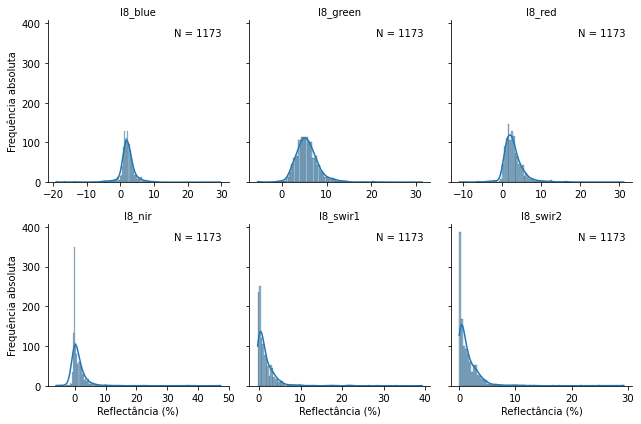

In [8]:
a = pd.melt(df_matchups_l8, id_vars= 'img_id', value_vars = list(df_matchups_l8.columns[7:13]), value_name='Reflectance')

a['Reflectance'] = a['Reflectance']*100

def annotate(data, **kws):
    n = len(data)
    ax = plt.gca()
    ax.text(.7, .9, f"N = {n}", transform=ax.transAxes)

g = sns.FacetGrid(a, col="variable", height=3, aspect=1, col_wrap = 3, sharex=False)

g.map(sns.histplot, "Reflectance", kde=True)
g.map_dataframe(annotate)

# Adjust title and axis labels directly

g.set_axis_labels(x_var="Reflectância (%)", y_var="Frequência absoluta")

axes = g.axes.flatten()

for ax in axes:
    title = ax.get_title().split('=')[1].strip()
    ax.set_title(title, fontsize = 10)

#g.set_titles("")

### 4.3.2 Histogramas dos principais parâmetros de qualidade da água

In [9]:
main_wqp = ['TSS (mg/L)', 'Chla (µg/L)', 'Turbidity (NTU)', 'SDD (m)', 'CDOM 400 nm (m-1)']

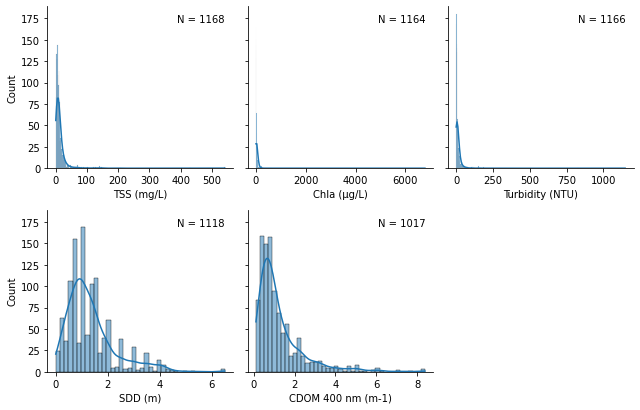

In [10]:
a = pd.melt(df_matchups_l8, id_vars= 'img_id', value_vars = main_wqp, value_name='WQP').dropna()

def annotate(data, **kws):
    n = len(data)
    ax = plt.gca()
    ax.text(.7, .9, f"N = {n}", transform=ax.transAxes)
    
     
g = sns.FacetGrid(a, col="variable", height=3, aspect=1, col_wrap = 3, sharex=False, margin_titles=True)

g.map(sns.histplot, "WQP", kde=True)
g.map_dataframe(annotate)


# Adjust title and axis labels directly
axes = g.axes.flatten()

for ax in axes:
    x_label = ax.get_title().split('=')[1].strip()
    ax.set_xlabel(x_label)

g.set_titles("")

## 4.4 BOXPLOT

### 4.4.1 Reflectância

Text(0.5, 0, 'Bandas Landsat - 8')

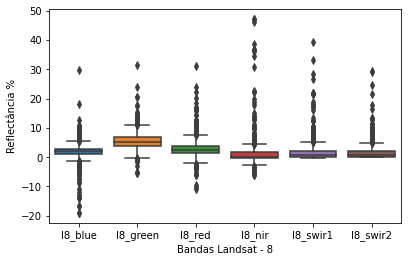

In [11]:
a = pd.melt(df_matchups_l8, id_vars= 'img_id', value_vars = list(df_matchups_l8.columns[7:13]), value_name='Reflectance')

a['Reflectance'] = a['Reflectance']*100

def annotate(data, **kws):
    n = len(data)
    ax = plt.gca()
    ax.text(.7, .9, f"N = {n}", transform=ax.transAxes)
    
cm=1/2.54
fig, ax = plt.subplots(figsize=(16*cm, 10*cm))    
ax = sns.boxplot(data = a, y="Reflectance", x="variable")
ax.set_ylabel("Reflectância %")
ax.set_xlabel("Bandas Landsat - 8")

- Presença de valores negativos que não fazem sentido

### 4.4.2 Principais WQP

C:\ProgramData\Anaconda3\envs\geo_env\lib\site-packages\seaborn\axisgrid.py:670: UserWarning: Using the boxplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


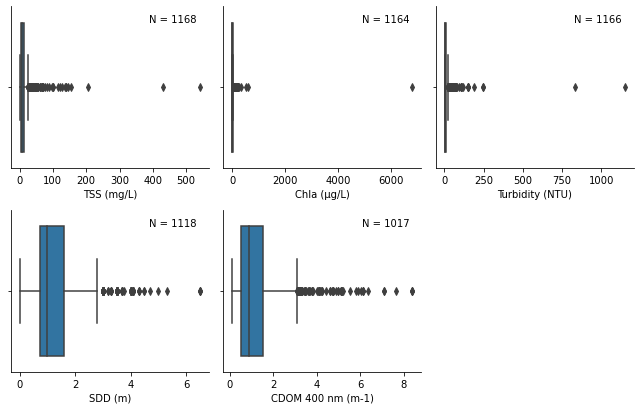

In [12]:
a = pd.melt(df_matchups_l8, id_vars= 'img_id', value_vars = main_wqp, value_name='WQP').dropna()

def annotate(data, **kws):
    n = len(data)
    ax = plt.gca()
    ax.text(.7, .9, f"N = {n}", transform=ax.transAxes)
    
     
g = sns.FacetGrid(a, col="variable", height=3, aspect=1, col_wrap = 3, sharex=False, margin_titles=True)

g.map(sns.boxplot, "WQP")
g.map_dataframe(annotate)


# Adjust title and axis labels directly
axes = g.axes.flatten()

for ax in axes:
    x_label = ax.get_title().split('=')[1].strip()
    ax.set_xlabel(x_label)

g.set_titles("")

- Existem outliers que precisam ser removidos

## 4.5 Plotting points location

In [117]:
import folium
from folium import Choropleth, Circle, Marker, Icon, Popup
from folium.plugins import HeatMap, MarkerCluster

# MAPA
# Create a map

map1 = folium.Map(location=[42.4, -83.2], tiles='cartodbpositron', zoom_start=8)

vis_params_l8 = {
    'bands': ['SR_B4', 'SR_B3', 'SR_B2'],
    'min': 0,
    'max': 0.3,
}

# Add the land cover to the map object.
map1.add_ee_layer(l8_col.median(), vis_params_l8, 'L8')

mc = MarkerCluster()
# Add points to the map
for idx, row in df_matchups_l8.iterrows():
    #print(idx)

    # info on popup
    popup_info = 'ID: ' + str(idx) + '<br>' + 'Chl: ' + str(row['Chla (µg/L)']) + '<br>' + 'Turbidity (NTU): ' + str(row['Turbidity (NTU)']) + '<br>' + 'Date: ' + str(row['Date'])

    mc.add_child(Marker(
        location=[row['Latitude (decimal deg)'], row['Longitude (decimal deg)']],
        popup=folium.Popup(max_width=400,html=popup_info),
        icon=folium.Icon(color='blue', icon=''))
          )

    

map1.add_child(mc)
# Add a layer control panel to the map.
map1.add_child(folium.LayerControl())

# Display the map.    
map1

## 4.6 Ajustando o dataframe

### 4.6.1 Excluindo valores que não são localizados nos lagos

C:\ProgramData\Anaconda3\envs\geo_env\lib\site-packages\pyproj\crs\crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\alex_\AppData\Local\Temp\ipykernel_18048\414604300.py:16: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg:4326 +type=crs
Right CRS: EPSG:4326

  gdf_matchups_l8 = gpd.clip(gdf_matchups_l8, lakes, keep_geom_type=True)


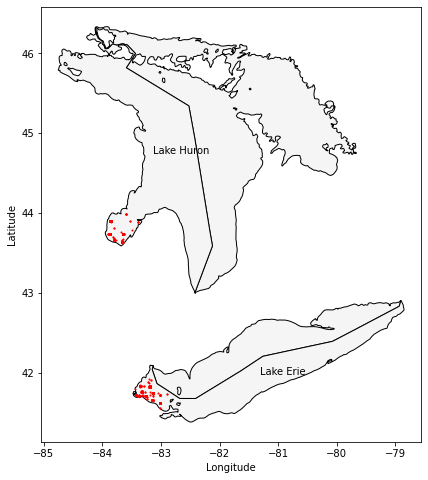

In [14]:
lake_erie_boundary = gpd.read_file("Dados/hydro_p_LakeErie.shp").to_crs(epsg = 4326)

lake_huron_boundary = gpd.read_file("Dados/hydro_p_LakeHuron.shp").to_crs(epsg = 4326)

lakes = pd.concat([lake_erie_boundary, lake_huron_boundary])

gdf_matchups_l8 = gpd.GeoDataFrame(df_matchups_l8, \
                                   geometry=gpd.points_from_xy(df_matchups_l8['Longitude (decimal deg)'], \
                                                               df_matchups_l8['Latitude (decimal deg)']
                                                              )
                                  )

gdf_matchups_l8.crs = {'init': 'epsg:4326'}


gdf_matchups_l8 = gpd.clip(gdf_matchups_l8, lakes, keep_geom_type=True)


ax = lakes.plot(figsize=(8,8), color='whitesmoke', linestyle='-', edgecolor='black')
gdf_matchups_l8.plot(markersize=1, color = 'red', ax=ax)
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
lakes_label = lakes.loc[lakes['COUNTRY']=='USA']
lakes_label.apply(lambda x: ax.annotate(text=x['NAMEEN'], xy=x.geometry.centroid.coords[0], ha='left'), axis=1);

In [15]:
df_matchups_l8 = pd.DataFrame(gdf_matchups_l8)
df_matchups_l8.head()

,img_id,satellite,Site,Latitude (decimal deg),Longitude (decimal deg),date,timestamp,l8_blue,l8_green,l8_red,...,Local Time (Eastern Time Zone),Wind speed (knots),Wave Height (ft),Sky,SDD (m),Turbidity (NTU),Chla (µg/L),CDOM 400 nm (m-1),TSS (mg/L),geometry
512,LC08_L2SP_020031_20151007_20200908_02_T1,LANDSAT_8,WE14,41.5541,-83.0146,2015-10-07,2015-10-07 13:16:34.471,0.039944,0.094840,0.064445,...,11:19,0.81,0.89,sunny,1.5,5.39,15.37,0.230,6.60,POINT (-83.01460 41.55410)
86,LC08_L2SP_019031_20150930_20200908_02_T1,LANDSAT_8,WE14,41.5541,-83.0146,2015-09-30,2015-09-30 13:10:23.371,0.097869,0.206135,0.239032,...,11:19,0.81,0.89,sunny,1.5,5.39,15.37,0.230,6.60,POINT (-83.01460 41.55410)
641,LC08_L2SP_020031_20170809_20200903_02_T1,LANDSAT_8,WE15,41.6158,-83.0119,2017-08-09,2017-08-09 13:16:34.464,0.006095,0.052892,0.011693,...,10:25,4.35,0.65,sunny,2.0,2.93,17.16,0.721,4.68,POINT (-83.01190 41.61580)
617,LC08_L2SP_020031_20170606_20201015_02_T1,LANDSAT_8,WE15,41.6163,-83.0134,2017-06-06,2017-06-06 13:16:12.227,0.022206,0.091790,0.067281,...,10:42,7.3,0.75,mostly sunny,1.5,4.08,1.28,2.512,2.72,POINT (-83.01340 41.61630)
60,LC08_L2SP_019031_20150813_20200908_02_T1,LANDSAT_8,WE15,41.6165,-83.0107,2015-08-13,2015-08-13 13:10:04.286,0.029830,0.095967,0.046481,...,11:03,1.78,0.29,cloudy,NaN,19.00,91.52,1.320,16.31,POINT (-83.01070 41.61650)


In [16]:
df_matchups_l8.shape

(1155, 30)

### 4.6.2 Lidando com os valores negativos de reflectância

In [17]:
# counting negative values
print("Quantidade de valores negativos por banda")
df_matchups_l8[df_matchups_l8.iloc[:, 7:13] < 0].count()[7:13]

Quantidade de valores negativos por banda


l8_blue      93
l8_green     11
l8_red       35
l8_nir      501
l8_swir1    111
l8_swir2      1
dtype: int64

- Devido a quantidade de valores negativos na banda do infravermelho, um modelo de imputação de informações será utilizado para a estimativa do valor na banda NIR a partir das outras bandas

#### 4.6.2.1 Removendo registros com valores nulos nas outras bandas

In [18]:
#df_non_negative = 
df_non_negative = df_matchups_l8.loc[(df_matchups_l8['l8_blue']>=0) \
                                     & (df_matchups_l8['l8_green']>=0) \
                                     & (df_matchups_l8['l8_red']>=0) \
                                     & (df_matchups_l8['l8_swir1']>=0) \
                                     & (df_matchups_l8['l8_swir2']>=0), :]

#### 4.6.2.2 Checando quantidade de valores negativos que permanecem

In [19]:
df_non_negative[df_non_negative.iloc[:, 7:13] < 0].count()[7:13]

l8_blue       0
l8_green      0
l8_red        0
l8_nir      354
l8_swir1      0
l8_swir2      0
dtype: int64

#### 4.6.2.3 Modelagem de 354 valores "nulos" na banda NIR

 - Convertendo valores negativos para nulo

In [20]:
df_non_negative.loc[:, 'l8_nir'] = df_non_negative.loc[:, 'l8_nir'].map(lambda x: x if (x>= 0) else np.nan)

C:\Users\alex_\AppData\Local\Temp\ipykernel_18048\1762719761.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_non_negative.loc[:, 'l8_nir'] = df_non_negative.loc[:, 'l8_nir'].map(lambda x: x if (x>= 0) else np.nan)


- Copiando dataframe para a modelagem de apenas valores não nulos

In [21]:
df_model_nir = df_non_negative.copy(deep=True)

df_model_nir.dropna(subset='l8_nir', axis = 0, inplace=True)
df_model_nir.shape

(596, 30)

- Implementando random forest model

R² de Treinamento:  0.9790547196539604
RMSE de Teste:  0.01
nRMSE de Teste:  0.49


Text(0.20700348422302456, 0, 'n = 120\nRMSE: 0.01 \nnRMSE: 49.00 %')

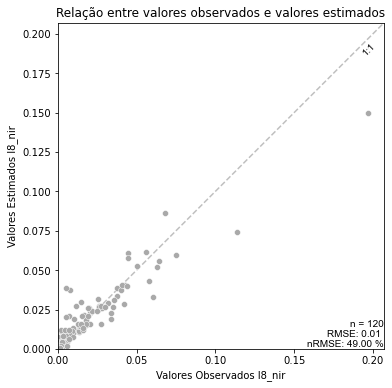

In [22]:
from statistics import mean

def nrmse(y_obs, y_pred):
    rmse = (sum((np.subtract(y_obs, y_pred))**2)/len(y_obs))**0.5
    nrmse = round(rmse/mean(y_obs),2)
    return nrmse

def rmse(y_obs, y_pred):
    rmse = round((sum((np.subtract(y_obs, y_pred))**2)/len(y_obs))**0.5,2)
    return rmse

X = df_model_nir.loc[:, ['l8_blue', 'l8_green', 'l8_red', 'l8_swir1', 'l8_swir2']]
y = df_model_nir.loc[:, 'l8_nir']


X_train, X_test,y_train,y_test = train_test_split(X,y,test_size=0.2, random_state=8)

lr = RandomForestRegressor()

model = lr.fit(X_train, y_train)

y_pred = model.predict(X_test)


val_r2 = model.score(X_train, y_train)
val_rmse = rmse(y_test, y_pred)
val_nrmse = nrmse(y_test, y_pred)


print("R² de Treinamento: ", val_r2)
print("RMSE de Teste: ", val_rmse)
print("nRMSE de Teste: ", val_nrmse)


fig, ax = plt.subplots(figsize=(6,6))

h = sns.scatterplot(ax=ax, x = y_test, y=y_pred, color='darkgrey')


h.spines['right'].set_visible(True)
h.spines['left'].set_visible(True)
h.spines['top'].set_visible(True)
h.spines['bottom'].set_visible(True)
h.set_ylabel('Valores Estimados '+ h.get_xlabel())
h.set_xlabel('Valores Observados '+ h.get_xlabel())
h.set_title('Relação entre valores observados e valores estimados')

lims = [
    np.min([h.get_xlim(), h.get_ylim()]),  # min of both axes
    np.max([h.get_xlim(), h.get_ylim()]),  # max of both axes
]


if lims[0]<0:
    lims[0]=0
else:
    pass

# now plot both limits against eachother
h.plot(lims, lims, '--', alpha=0.5, zorder=0, color='gray')
h.text(lims[1]*0.93, lims[1]*0.9,'1:1', fontdict={'family': 'arial', 'color':  'black', 'weight': 'light', 'size': 10, 'rotation': '45'})

h.set_xticks(h.get_yticks())
h.set_xlim(lims)
h.set_ylim(lims)
h.set_aspect('equal')
h.text(lims[1],
       lims[0],
       "n = {}".format(y_test.shape[0]) + "\nRMSE: " + "{:.2f}".format(val_rmse) + ' '  + "\nnRMSE: " + "{:.2f}".format(val_nrmse*100) + " %",
       fontdict={'ha': 'right', 
                 'va': 'bottom', 
                 'family': 'arial', 
                 'color':  'black', 
                 'weight': 'light', 
                 'size': 10, 
                 'rotation': '0'})

- Separando valores para a predição

In [23]:
X_predict = df_non_negative[df_non_negative['l8_nir'].isnull()].loc[:, ['l8_blue', 'l8_green', 'l8_red', 'l8_swir1', 'l8_swir2']]

- Predizindo o valor da banda l8_nir

In [24]:
X_predict['l8_nir'] = model.predict(X_predict)
X_predict['l8_nir']

513     0.012254
582     0.006722
687     0.001632
77      0.013893
144     0.012720
          ...   
1138    0.001653
974     0.001771
314     0.000574
303     0.004462
908     0.000996
Name: l8_nir, Length: 354, dtype: float64

- Retornando os valores para o dataframe original

In [25]:
df_non_negative.loc[X_predict.index, 'l8_nir'] = X_predict['l8_nir']

- Checando a quantidade de valores negativos

In [26]:
df_non_negative.iloc[:, 7:13].isnull().sum()

l8_blue     0
l8_green    0
l8_red      0
l8_nir      0
l8_swir1    0
l8_swir2    0
dtype: int64

### 4.6.3 Salvando o dataframe corrigido

In [27]:
df_matchups_l8 = df_non_negative.copy(deep=True)

In [28]:
df_matchups_l8.shape

(950, 30)

### 4.6.4 Removendo outliers dos atributos de qualidade da água

In [29]:
df_matchups_l8[main_wqp] = df_matchups_l8[main_wqp][(np.abs(zscore(df_matchups_l8[main_wqp].dropna())) < 3)].dropna()
df_matchups_l8.dropna(subset = main_wqp, inplace=True, axis = 0)

In [30]:
df_matchups_l8.shape

(721, 30)

## 4.7 Salvando pickle

In [31]:
df_matchups_l8.to_pickle("df_matchups_l8_prov")

## 4.7 Constuindo histogramas e mapas novamente para ver os resultados 

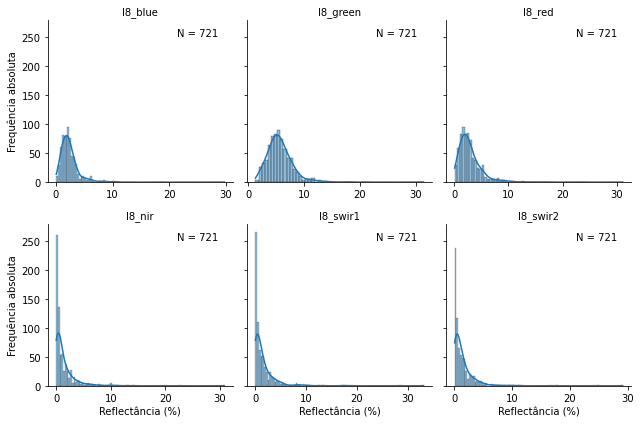

In [32]:
a = pd.melt(df_matchups_l8, id_vars= 'img_id', value_vars = list(df_matchups_l8.columns[7:13]), value_name='Reflectance')

a['Reflectance'] = a['Reflectance']*100

def annotate(data, **kws):
    n = len(data)
    ax = plt.gca()
    ax.text(.7, .9, f"N = {n}", transform=ax.transAxes)

g = sns.FacetGrid(a, col="variable", height=3, aspect=1, col_wrap = 3, sharex=False)

g.map(sns.histplot, "Reflectance", kde=True)
g.map_dataframe(annotate)

# Adjust title and axis labels directly

g.set_axis_labels(x_var="Reflectância (%)", y_var="Frequência absoluta")

axes = g.axes.flatten()

for ax in axes:
    title = ax.get_title().split('=')[1].strip()
    ax.set_title(title, fontsize = 10)

#g.set_titles("")


C:\ProgramData\Anaconda3\envs\geo_env\lib\site-packages\seaborn\axisgrid.py:670: UserWarning: Using the boxplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


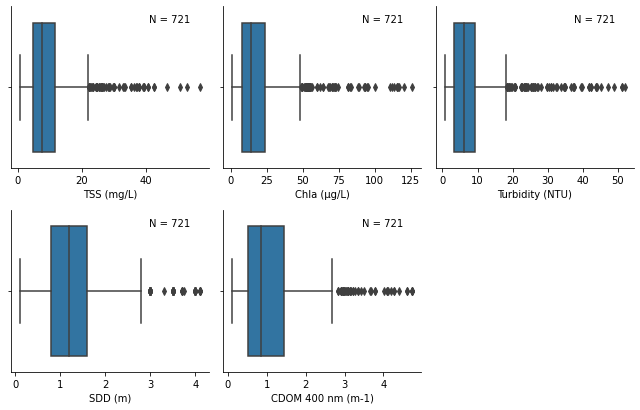

In [33]:
a = pd.melt(df_matchups_l8, id_vars= 'img_id', value_vars = main_wqp, value_name='WQP').dropna()

def annotate(data, **kws):
    n = len(data)
    ax = plt.gca()
    ax.text(.7, .9, f"N = {n}", transform=ax.transAxes)
    
     
g = sns.FacetGrid(a, col="variable", height=3, aspect=1, col_wrap = 3, sharex=False, margin_titles=True)

g.map(sns.boxplot, "WQP")
g.map_dataframe(annotate)


# Adjust title and axis labels directly
axes = g.axes.flatten()

for ax in axes:
    x_label = ax.get_title().split('=')[1].strip()
    ax.set_xlabel(x_label)

g.set_titles("")

In [34]:
# MAPA
# Create a map
map1 = folium.Map(location=[42.4, -83.2], tiles='cartodbpositron', zoom_start=8)

vis_params_l8 = {
    'bands': ['SR_B4', 'SR_B3', 'SR_B2'],
    'min': 0,
    'max': 0.2,
}

# Add the land cover to the map object.
map1.add_ee_layer(l8_col.median(), vis_params_l8, 'L8')

mc = MarkerCluster()
# Add points to the map
for idx, row in df_matchups_l8.iterrows():
    #print(idx)

    # info on popup
    popup_info = 'ID: ' + str(idx) + '<br>' + 'Chl: ' + str(row['Chla (µg/L)']) + '<br>' + 'Turbidity (NTU): ' + str(row['Turbidity (NTU)']) + '<br>' + 'Date: ' + str(row['Date'])

    mc.add_child(Marker(
        location=[row['Latitude (decimal deg)'], row['Longitude (decimal deg)']],
        popup=folium.Popup(max_width=400,html=popup_info),
        icon=folium.Icon(color='blue', icon=''))
          )

    
for _, r in lake_erie_boundary.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'gray', 'edgecolor': 'black', 'linewidth': 2, 'color': '#00000000'})
    folium.Popup(r['NAMEEN']).add_to(geo_j)
    geo_j.add_to(map1)

map1.add_child(mc)
# Add a layer control panel to the map.
map1.add_child(folium.LayerControl())

# Display the map.    
map1

AttributeError: 'Map' object has no attribute 'add_ee_layer'

# 5. ANÁLISE E EXPLORAÇÃO DOS DADOS

In [6]:
df_matchups_l8=pd.read_pickle("df_matchups_l8_prov")

## 5.1 Gráfico de correlação de Spearman

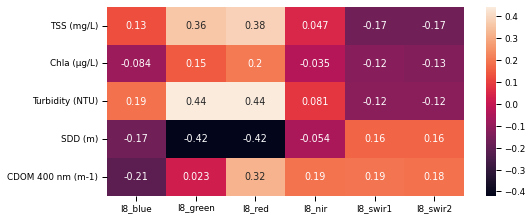

In [4]:
main_wqp = ['TSS (mg/L)', 'Chla (µg/L)', 'Turbidity (NTU)', 'SDD (m)', 'CDOM 400 nm (m-1)']
cm=1/2.54
sns.set_context("paper")
corr = df_matchups_l8.corr(method='spearman')

fig, ax = plt.subplots(figsize=(20*cm,8*cm))

#corr = corr[(abs(corr['TSS (mg/L)'])>0.4) | (abs(corr['Turbidity (NTU)'])>0.4) | (abs(corr['Chla (µg/L)'])>0.4) | (abs(corr['CDOM 400 nm (m-1)'])>0.4) | (abs(corr['SDD (m)'])>0.4)][main_wqp]

rrs_columns = ['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2']

wqp = main_wqp


ax = sns.heatmap(corr.loc[wqp, rrs_columns], annot=True)

plt.tight_layout()

## 5.2 Gráfico de Correlação

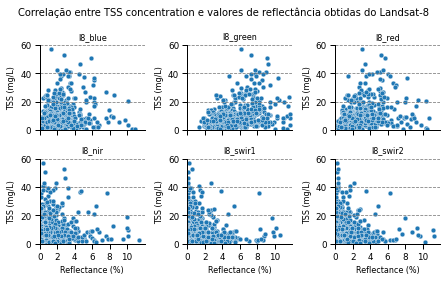

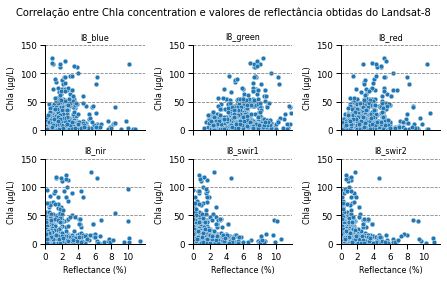

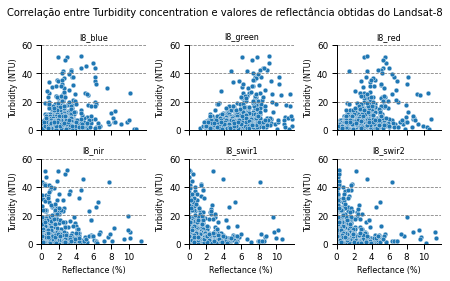

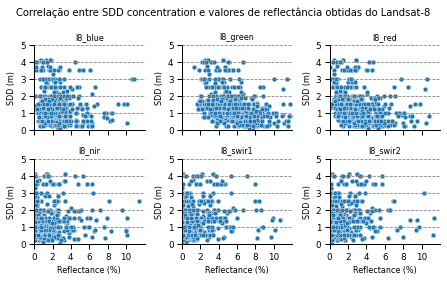

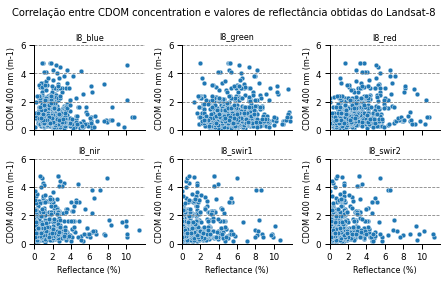

In [5]:
df = df_matchups_l8.copy(deep=True)

cm = 1/2.54
sns.set_context("paper")
columns_params = main_wqp
columns_plot = df.iloc[:, 7:13]


for param in columns_params:
    fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(16*cm, 10*cm), 
                            sharex=True)
    row=0
    col=0
    for num, i in enumerate(columns_plot):
        ax = sns.scatterplot(ax=axs[row, col], data = df, x = df[i]*100, y = df.loc[:, param], palette='crest', legend=False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_visible(True)
        ax.spines['top'].set_visible(False)
        ax.spines['bottom'].set_visible(True)
        ax.yaxis.grid(color='gray', linestyle='dashed')
        ax.set_title(ax.get_xlabel(), fontsize=8)
        ax.set_xlabel('Reflectance (%)', fontsize=8)
        ax.set_ylabel(ax.get_ylabel(), fontsize=8)
        ax.set_xticks([0, 2, 4, 6, 8, 10], fontsize= 8)
        ax.set_yticks(ax.get_yticks(), fontsize= 8)
        ax.set_xlim(0, 12)
        ax.set_ylim(0, ax.get_yticks()[-1])
        col +=1
        
        if col == 3:
            row +=1
            col=0
    #sns.scatterplot(data = df, x = df[i]*100, y = 'TSM (mg/L)', hue='Fonte', palette='crest', legend='brief')
    plt.suptitle("Correlação entre {} concentration e valores de reflectância obtidas do Landsat-8".format(param.split()[0]), fontsize=10)
    #plt.legend(bbox_to_anchor=(1.1, 1), loc='center left', borderaxespad=1)
    plt.tight_layout()

## 5.3 Tabela R2

In [59]:
def r2(y_obs, y_pred):
    
    y_obs = np.array(y_obs)
    y_pred = np.array(y_pred)
    y_hat = (1/len(y_obs))*sum(y_obs)
    TSS = sum((y_obs-y_hat)**2)
    RSS = sum((y_obs - y_pred)**2)
    r2 = round(1 - RSS/TSS,2)
    return r2

def adj_r2(estimator, X, y_true):
    n, p = X.shape
    pred = estimator.predict(X)
    adj_r2 = round(1 - ((1 - r2(y_true, pred)) * (n - 1))/(n-p-1), 2)
    return adj_r2

def mae(y_obs, y_pred):
    mae = round((np.sum(abs(y_obs - y_pred))/len(y_pred)), 2)
    return mae

def mape(y_obs, y_pred):
    mape = round((np.sum(abs((y_obs - y_pred)/y_obs))/len(y_pred)), 2)
    return mape*100

def rmse(y_obs, y_pred):
    rmse = round((sum((np.subtract(y_obs, y_pred))**2)/len(y_obs))**0.5,2)
    return rmse

def nrmse(y_obs, y_pred):
    rmse = (sum((np.subtract(y_obs, y_pred))**2)/len(y_obs))**0.5
    nrmse = round(rmse/mean(y_obs),2)
    return nrmse*100


def table_metrics(df, pos_wqp, pos_rs):
    '''This method calculate an accuracy table with the 
    R2, RMSE, NRMSE metrics using all data as calibration
    and validation for one WQP
    The parameters are:
    - df: dataframe
    - pos_param: position parameter for the WQP - integer value ex: 22
    - i_dep_var: the begining of dependent variables in df.columns - List ex:[4, 14]'''
    
    
    columns_params = df.columns[pos_wqp]
    columns_rs = df.columns[pos_rs[0]:pos_rs[1]]
    
    
    
    my_index = pd.MultiIndex(levels=[[],[]], codes = [[],[]], names=('WQP', 'Metric'))
    
    
    df_metrics = pd.DataFrame(index = my_index, columns = columns_rs)

    data1 = df[df[columns_params].notna()][columns_params].values
        #print(type(data1))
    #print(data1)
    
    for col_rs in columns_rs:
        data2 = df[df[columns_params].notna()][col_rs].values
        data2 = data2.reshape((-1, 1))
        try:
            lr = LinearRegression().fit(data2, data1)
            y_pred = lr.predict(data2)

            r2_var = r2(data1, y_pred)
            rmse_var = rmse(data1, y_pred)
            nrmse_var = nrmse(data1, y_pred)
        except:
            r2_var = np.nan
            rmse_var = np.nan
            nrmse_var = np.nan
        
        df_metrics.loc[(columns_params, 'R2'), col_rs] = r2_var
        df_metrics.loc[(columns_params, 'RMSE'), col_rs] = rmse_var
        df_metrics.loc[(columns_params, 'NRMSE'), col_rs] = nrmse_var
        


    return df_metrics

In [13]:
metrics = pd.DataFrame()
for i in range(24, 29, 1):
    a = table_metrics(df_matchups_l8, i, [7, 13])
    metrics = pd.concat([metrics, a], axis = 0)
metrics

l8_blue l8_green l8_red l8_nir l8_swir1 l8_swir2
WQP               Metric                                                 
SDD (m)           R2        0.02     0.12   0.07    0.0     0.01     0.01
                  RMSE      0.84     0.79   0.82   0.84     0.84     0.84
                  NRMSE     62.0     59.0   60.0   62.0     62.0     62.0
Turbidity (NTU)   R2        0.05     0.15   0.13   0.01      0.0      0.0
                  RMSE      8.32     7.87   7.97   8.49     8.53     8.53
                  NRMSE    100.0     94.0   96.0  102.0    102.0    102.0
Chla (µg/L)       R2         0.0     0.03   0.02    0.0     0.01     0.01
                  RMSE     20.45     20.2  20.28  20.43    20.38    20.36
                  NRMSE    101.0    100.0  100.0  101.0    101.0    101.0
CDOM 400 nm (m-1) R2        0.01      0.0   0.06   0.01     0.01     0.01
                  RMSE      0.86     0.87   0.84   0.86     0.87     0.87
                  NRMSE     78.0     78.0   76.0   77.0     78.0     78.0
TSS (mg/L)        R2        0.03     0.11    0.1    0.0      0.0      0.0
                  RMSE      7.92     7.59   7.66   8.04     8.05     8.05
                  NRMSE     81.0     78.0   78.0   82.0     82.0     82.0

## 5.4 DROPANDO IMAGENS COM INTERFERÊNCIA

In [7]:
list_drop = [86, 505, 589, 140, 596, 486, 46, 484, 460, 588, 116, 663, 681, 787, 727, 735, \
             108, 615, 187, 151, 104, 107, 84, 191, 44, 81, 55, 785, 82, 837, 51, 45, 105, \
             592, 585, 614, 736, 522, 445, 495, 590, 536, 593, 618, 1173, 1172, 363, 311, \
             255, 998, 483, 484, 1110, 247, 265, 361, 278, 1159, 983, 902, 1067, 1083, 919, \
             1149, 986, 309, 975, 1139, 912, 379, 1158, 995, 262, 287]

df_matchups_l8.drop(axis=0, index = list_drop, inplace=True)

## 5.5 DERIVAÇÃO DE ATRIBUTOS

In [8]:
class WQP:
    def __init__(self, df, i_wqp, e_wqp, i_rs, e_rs):
        
        self.df = df
        self.i_wqp = i_wqp
        self.e_wqp = e_wqp
        self.wqp_columns = df.columns[self.i_wqp:self.e_wqp]
        
        self.i_rs = i_rs
        self.e_rs = e_rs
        self.rs_columns = df.columns[self.i_rs:self.e_rs]
        
    
    
    def band_mult(self, df):
        
        for i in range(0, len(self.rs_columns)):
            for k in range(i, len(self.rs_columns)):
                if i == k:
                    pass
                else:
                    name_column = '{} x {}'.format(self.rs_columns[i], self.rs_columns[k])
                    df[name_column]= df[self.rs_columns[i]] * df[self.rs_columns[k]]
                    
        return df
    
    def band_ratio(self, df):
        for i in range(0, len(self.rs_columns)):
            for k in range(0, len(self.rs_columns)):
                if i == k:
                    pass
                else:
                    name_column = '{} / {}'.format(self.rs_columns[i], self.rs_columns[k])
                    df[name_column]= df[self.rs_columns[i]]/df[self.rs_columns[k]]
                    
        return df
    
    
    def index_sum_difference(self, df):
        
        for i in range(0, len(self.rs_columns)):
            
            for j in range(0, len(self.rs_columns)):
                if i == j:
                    pass
                for k in range(0, len(self.rs_columns)):
                    if j == k:
                        pass
                    for l in range(0, len(self.rs_columns)):
                        df_temp = pd.DataFrame()
                        if k == l or i == j:
                            pass
                        else:
                            name_column = '{} + {} / {} - {}'.format(self.rs_columns[i], self.rs_columns[j], self.rs_columns[k], self.rs_columns[l])
                            #print(name_column)
                            df_temp.loc[:, name_column]= (df.loc[:, self.rs_columns[i]]+df.loc[:, self.rs_columns[j]]) / \
                                            (df.loc[:, self.rs_columns[k]]-df.loc[:, self.rs_columns[l]])
                        df = pd.concat([df, df_temp], axis=1)            
        return df
    
    def index_difference_sum(self, df):
        
        for i in range(0, len(self.rs_columns)):
            
            for j in range(0, len(self.rs_columns)):
                if i == j:
                    pass
                for k in range(0, len(self.rs_columns)):
                    if j == k:
                        pass
                    for l in range(0, len(self.rs_columns)):
                        df_temp = pd.DataFrame()
                        if k == l or i == j:
                            pass
                        else:
                            name_column = '{} - {} / {} + {}'.format(self.rs_columns[i], self.rs_columns[j], self.rs_columns[k], self.rs_columns[l])
                            #print(name_column)
                            df_temp.loc[:, name_column]= (df.loc[:, self.rs_columns[i]]-df.loc[:, self.rs_columns[j]]) / \
                                            (df.loc[:, self.rs_columns[k]]+df.loc[:, self.rs_columns[l]])
                        df = pd.concat([df, df_temp], axis=1)            
        return df
    
    
    #------------SEMI-EMPIRICAL MODELS--------------------------#
    
    #--------------------CHLA-----------------------------------#
    def ndci(self, df, red, nir):
        
        df.loc[:, 'NDCI'] = (df.loc[:, nir] - df.loc[:, red]) / (df.loc[:, nir] + df.loc[:, red])
        
        return df
    
    
    def sabi(self, df, blue, green, red, nir):
        
        df.loc[:, 'SABI'] = (df.loc[:, nir] - df.loc[:, red]) / (df.loc[:, nir] + df.loc[:, red])
        
        return df

    def two_three_band(self, df, green, red, nir):          
        
        df.loc[:, '2BDA']= df.loc[:, nir]/df.loc[:, red]
        
        df.loc[:, '3BDA']= df.loc[:, nir]*((1/df.loc[:, green])-(1/df.loc[:, red]))
        
        return df
    
    def flh(self, df, blue, green, red):          
        
        df.loc[:, 'FLH']= df.loc[:, green] - (df.loc[:, red] + (df.loc[:, blue] - df.loc[:, red]))
        
        return df

In [9]:
a = WQP(df_matchups_l8, 24, 29, 7, 13)

In [17]:
a.rs_columns

Index(['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2'], dtype='object')

In [18]:
a.wqp_columns

Index(['SDD (m)', 'Turbidity (NTU)', 'Chla (µg/L)', 'CDOM 400 nm (m-1)',
       'TSS (mg/L)'],
      dtype='object')

In [10]:
df_enh = df_matchups_l8.copy(deep=True)

In [13]:
#df_enh = a.band_mult(df_enh)
#df_enh = a.band_ratio(df_enh)
#df_enh = a.index_difference_sum(df_enh)
#df_enh = a.index_sum_difference(df_enh)

In [11]:
df_enh = a.ndci(df_enh, 'l8_red', 'l8_nir')
df_enh = a.sabi(df_enh, 'l8_blue', 'l8_green', 'l8_red', 'l8_nir')
df_enh = a.two_three_band(df_enh, 'l8_green', 'l8_red', 'l8_nir')
df_enh = a.flh(df_enh, 'l8_blue', 'l8_green', 'l8_red')

In [12]:
df_enh.shape

(648, 35)

## 5.6 Gráfico de correlação de Spearman

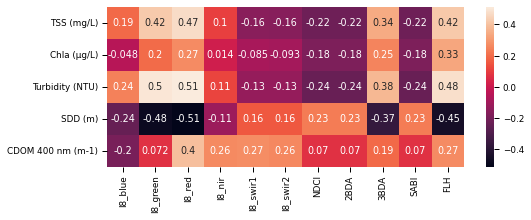

In [22]:
cm=1/2.54
sns.set_context("paper")
corr = df_enh.corr(method='spearman')

fig, ax = plt.subplots(figsize=(20*cm,8*cm))


rrs_columns = ['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'NDCI', '2BDA', '3BDA', 'SABI', 'FLH']
wqp = main_wqp


ax = sns.heatmap(corr.loc[wqp, rrs_columns], annot=True)

plt.tight_layout()

# 6. CRIAÇÃO, TREINAMENTO, APLICAÇÃO E AVALIAÇÃO DE MODELOS DE MACHINE LEARNING

## 6.1 REGRESSÕES UNIVARIADAS (1 VARIÁVEL INDEPENDENTE X 1 VARIÁVEL DEPENDENTE)

In [191]:
def model_exec(model, X_train, y_train, X_test, y_test):
    
    def func_linear(x, a, b):
        return a+x*b

    def func_poly(x, a, b, c):
        return a+ x**2*b+x**1*c
    
    def func_exp(x, a, b):
        return a*np.exp(b*x)
    
    def func_log(x, a, b):
        return a + np.log(x)*b
        
    if model == 'linear':
        
        model = func_linear
        
    elif model == 'polynomial':
        
        model = func_poly
        
    elif model == 'exp':
        
        model = func_exp
        
    elif model == 'log':
        
        model = func_log
    
    else: 
        print("No model {} available".format(model))
        
    popt, pcov = curve_fit(model, X_train, y_train)
    
    def r2(model, y):
        residuals = y - model(X_train, *popt)
        ss_res = np.sum(residuals**2)
        ss_tot = np.sum((y-np.mean(y))**2)
        r_squared = 1 - (ss_res / ss_tot)
        
        return r_squared
    
    def rmse(model, y):
        residuals = y - model(X_test, *popt)
        rmse = round((np.sum(residuals**2)/len(y))**0.5,2)
        return rmse
    
    def nrmse(model, y):
        residuals = y - model(X_test, *popt)
        nrmse = round(((np.sum(residuals**2)/len(y))**0.5)/mean(y),2)
        return nrmse
    
    
    y_pred_train = model(X_train, *popt)
    
    y_pred = model(X_test, *popt)
    
    val_r2 = r2(model, y_train)
    
    
    wqp_units = y_test.name.split(' ')
    if len(wqp_units)>3:
        wqp_units=wqp_units[3]#change if necessary
    else:
        wqp_units=wqp_units[1]

    print("\n#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#\n")
    print("\n#-------------------DADOS DE CALIBRAÇÃO-----------------------#\n")
    print("n: {:.0f}".format(y_train.shape[0]))
    print("R²: {:.4f}".format(r2(model, y_train)))
    print("Squared-Pearson: {:.4f}".format(scipy.stats.pearsonr(X_train, y_train)[0]**2))
    print("R² Sklearn (RSS/TSS): {:.4f}".format(r2_score(y_train, y_pred_train)))
    print("Coeficiente(s): {}".format(popt))
    print("\n#-------------------DADOS DE VALIDAÇÃO-----------------------#\n")
    print("n: {:.4f}".format(y_test.shape[0]))
    print("RMSE: {:.2f} {}".format(rmse(model, y_test), wqp_units))
    print("nRMSE: {:.2f} {}".format(nrmse(model, y_test)*100, '%'))

    
    
    
    
    cm = 1/2.54
    sns.set_context('paper')
    fig, axs = plt.subplots(nrows = 2, ncols = 1, figsize=(10*cm,22*cm), squeeze=True)
    
    x_vals = np.linspace(X_train.min(), X_train.max(), 100)
    y_vals = model(x_vals, *popt)
    #g = axs[0].scatter(x=x, y=y)
    g = sns.scatterplot(ax=axs[0], x=X_train, y=y_train)
    g.set_xlabel('Reflectância ' + g.get_xlabel())
    g.set_title('Gráfico com pontos de calibração e linha de regressão', pad=-20)
    


    g.text(1, 0, "n = {}".format(y_train.shape[0]) + "\nR²: " + "{:.2f}".format(val_r2), transform=g.transAxes, fontdict={'ha': 'right', 'va': 'bottom', 'family': 'arial', 'color':  'black', 'weight': 'light', 'size': 10, 'rotation': '0'})
    g = axs[0].plot(x_vals, y_vals, color='r')
    g = axs[0].errorbar(x=X_train, y=y_train, yerr= np.array(y_pred_train)-np.array(y_train), fmt='none', ecolor='gray', lolims=True, lw=0.2)
    

    
  
    
    h = sns.scatterplot(ax=axs[1], x = y_test, y=model(X_test, *popt), color='darkgrey')
    val_rmse = rmse(model, y_test)
    val_nrmse = nrmse(model, y_test)
    
    
    
    h.spines['right'].set_visible(True)
    h.spines['left'].set_visible(True)
    h.spines['top'].set_visible(True)
    h.spines['bottom'].set_visible(True)
    h.set_ylabel('Valores estimados de '+ h.get_xlabel())
    h.set_xlabel('Valores observados de '+ h.get_xlabel())
    h.set_title('Relação entre valores estimados e observados', pad=-20)
    
    lims = [
        np.min([h.get_xlim(), h.get_ylim()]),  # min of both axes
        np.max([h.get_xlim(), h.get_ylim()]),  # max of both axes
    ]
    
    
    
    if lims[0]<0:
        lims[0]=0
    else:
        pass
    
    # now plot both limits against eachother
    h.plot(lims, lims, '--', alpha=0.5, zorder=0, color='gray')
    h.text(lims[1]*0.93, lims[1]*0.9,'1:1', fontdict={'family': 'arial', 'color':  'black', 'weight': 'light', 'size': 10, 'rotation': '45'})
    
    h.set_xticks(h.get_yticks())
    h.set_xlim(lims)
    h.set_ylim(lims)
    h.set_aspect('equal')
    h.text(lims[1], lims[0],"n = {}".format(y_test.shape[0]) + "\nRMSE: " + "{:.2f}".format(val_rmse) + ' ' + wqp_units + "\nnRMSE: " + "{:.2f}".format(val_nrmse*100) + " %", fontdict={'ha': 'right', 'va': 'bottom', 'family': 'arial', 'color':  'black', 'weight': 'light', 'size': 10, 'rotation': '0'})

    plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.3, 
                    hspace=0.3)
    
    plt.show()

### 5.1.1 Variável dependente: Turbidez

In [192]:
df_turb = df_matchups_l8.dropna(axis = 0, subset=['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'Turbidity (NTU)'])

X = df_turb.iloc[:, 7:13]
y = df_turb.loc[:, 'Turbidity (NTU)']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

#printing information
print('Training Features Shape:', X_train.shape)
print('Training Labels Shape:', X_test.shape)
print('Testing Features Shape:', y_train.shape)
print('Testing Labels Shape:', y_test.shape)

Training Features Shape: (518, 6)
Training Labels Shape: (130, 6)
Testing Features Shape: (518,)
Testing Labels Shape: (130,)


#------------- l8_blue ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1126
Squared-Pearson: 0.1126
R² Sklearn (RSS/TSS): 0.1126
Coeficiente(s): [  3.13458608 233.08996324]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.28 (NTU)
nRMSE: 98.00 %


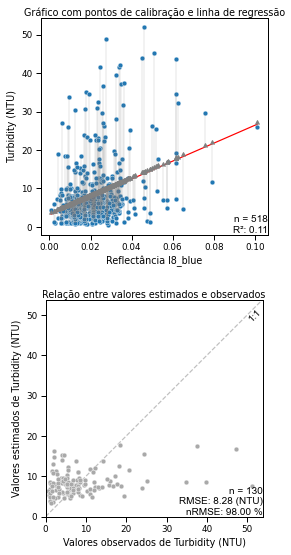


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1144
Squared-Pearson: 0.1126
R² Sklearn (RSS/TSS): 0.1144
Coeficiente(s): [   4.0223234  1103.41727659  161.2674233 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.26 (NTU)
nRMSE: 97.00 %


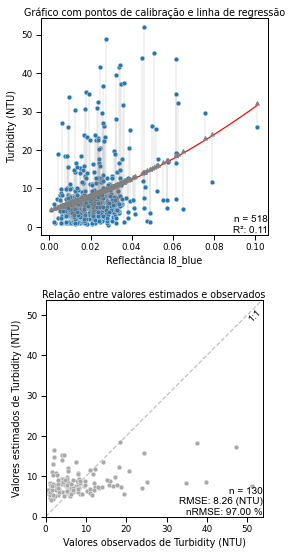


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0758
Squared-Pearson: 0.1126
R² Sklearn (RSS/TSS): 0.0758
Coeficiente(s): [24.4963017   4.09867407]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.36 (NTU)
nRMSE: 98.00 %


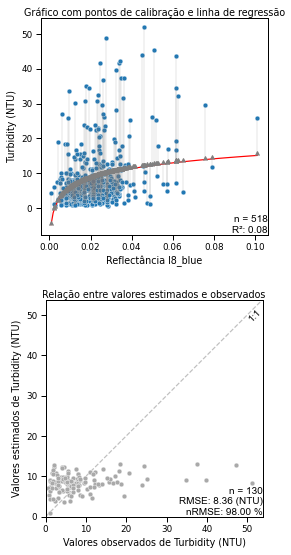


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1076
Squared-Pearson: 0.1126
R² Sklearn (RSS/TSS): 0.1076
Coeficiente(s): [ 5.2722761  19.31576277]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.24 (NTU)
nRMSE: 97.00 %


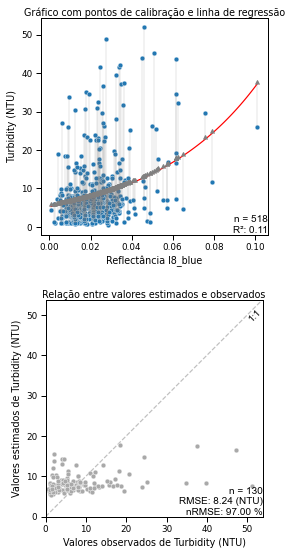

#------------- l8_green ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2358
Squared-Pearson: 0.2358
R² Sklearn (RSS/TSS): 0.2358
Coeficiente(s): [ -3.23246333 211.85246946]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 7.53 (NTU)
nRMSE: 89.00 %


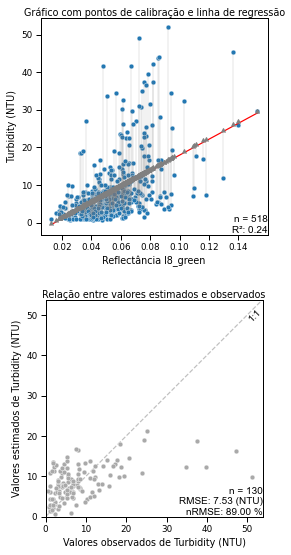


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2371
Squared-Pearson: 0.2358
R² Sklearn (RSS/TSS): 0.2371
Coeficiente(s): [ -1.64820392 439.53878196 155.83851313]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 7.50 (NTU)
nRMSE: 88.00 %


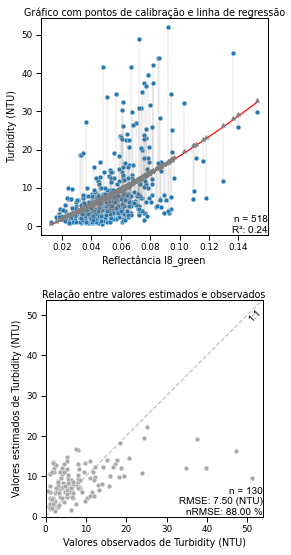


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2006
Squared-Pearson: 0.2358
R² Sklearn (RSS/TSS): 0.2006
Coeficiente(s): [38.96889478 10.31442562]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 7.71 (NTU)
nRMSE: 91.00 %


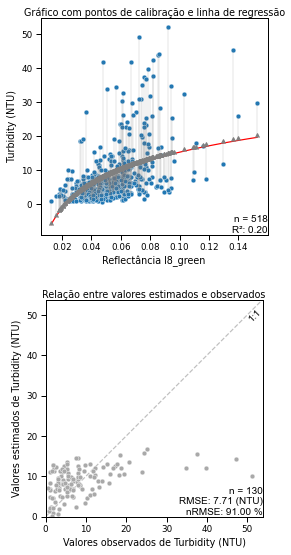


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2123
Squared-Pearson: 0.2358
R² Sklearn (RSS/TSS): 0.2123
Coeficiente(s): [ 3.20703993 16.72461145]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 7.57 (NTU)
nRMSE: 89.00 %


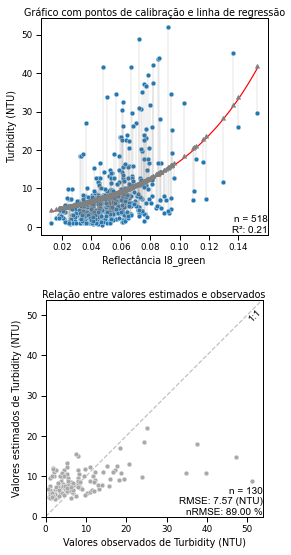

#------------- l8_red ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2511
Squared-Pearson: 0.2511
R² Sklearn (RSS/TSS): 0.2511
Coeficiente(s): [  2.32557899 227.07991498]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 7.61 (NTU)
nRMSE: 90.00 %


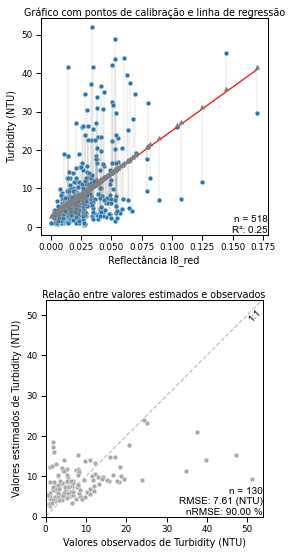


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2611
Squared-Pearson: 0.2511
R² Sklearn (RSS/TSS): 0.2611
Coeficiente(s): [   0.95165602 -875.49572721  313.81138919]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 7.62 (NTU)
nRMSE: 90.00 %


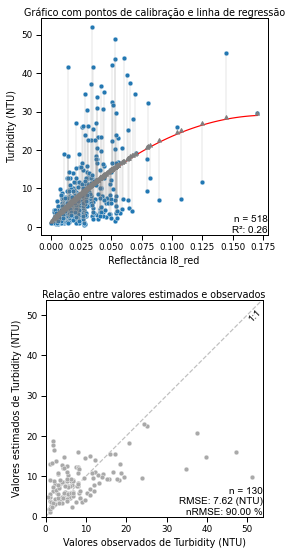


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2184
Squared-Pearson: 0.2511
R² Sklearn (RSS/TSS): 0.2184
Coeficiente(s): [29.39609723  5.46130338]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 7.81 (NTU)
nRMSE: 92.00 %


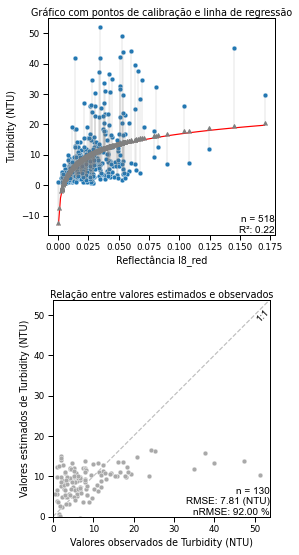


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1798
Squared-Pearson: 0.2511
R² Sklearn (RSS/TSS): 0.1798
Coeficiente(s): [ 5.92735595 12.41505337]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 7.87 (NTU)
nRMSE: 93.00 %


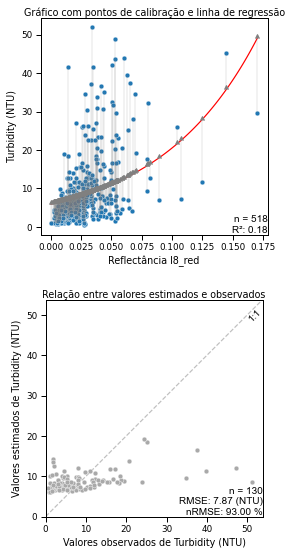

#------------- l8_nir ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0268
Squared-Pearson: 0.0268
R² Sklearn (RSS/TSS): 0.0268
Coeficiente(s): [  7.24408486 102.86056434]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.65 (NTU)
nRMSE: 102.00 %


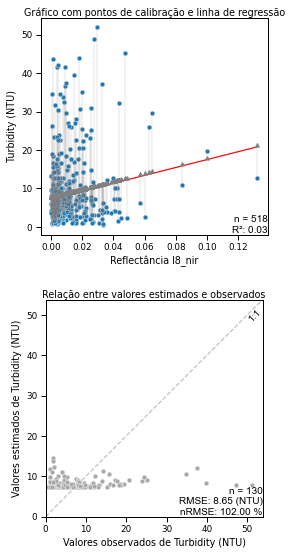


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0297
Squared-Pearson: 0.0268
R² Sklearn (RSS/TSS): 0.0297
Coeficiente(s): [   6.92770807 -816.71708791  156.81173704]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.62 (NTU)
nRMSE: 101.00 %


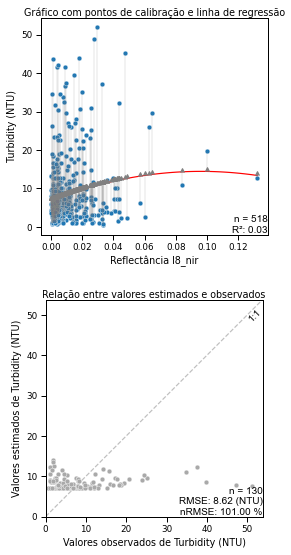


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0310
Squared-Pearson: 0.0268
R² Sklearn (RSS/TSS): 0.0310
Coeficiente(s): [14.39048486  1.15149336]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.54 (NTU)
nRMSE: 101.00 %


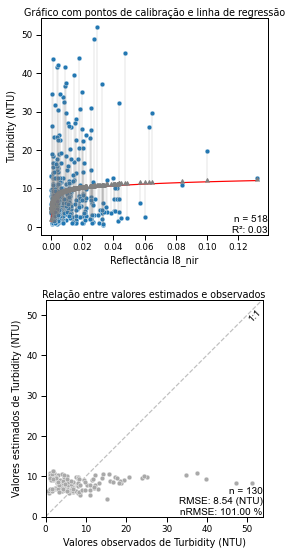


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0224
Squared-Pearson: 0.0268
R² Sklearn (RSS/TSS): 0.0224
Coeficiente(s): [7.58522173 8.21547322]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.66 (NTU)
nRMSE: 102.00 %


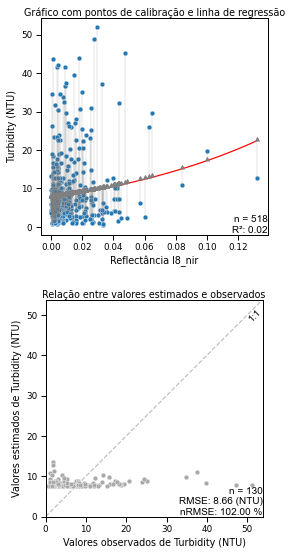

#------------- l8_swir1 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0080
Squared-Pearson: 0.0080
R² Sklearn (RSS/TSS): 0.0080
Coeficiente(s): [  8.93247669 -65.46393941]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.60 (NTU)
nRMSE: 101.00 %


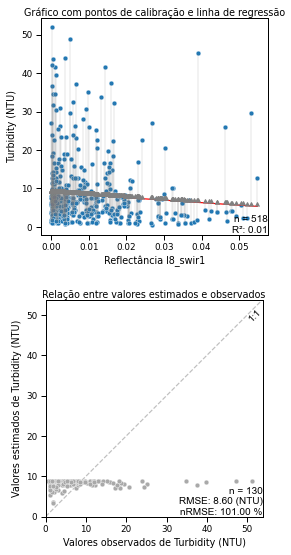


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0089
Squared-Pearson: 0.0080
R² Sklearn (RSS/TSS): 0.0089
Coeficiente(s): [   9.15562542 1472.33093344 -122.01759764]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.67 (NTU)
nRMSE: 102.00 %


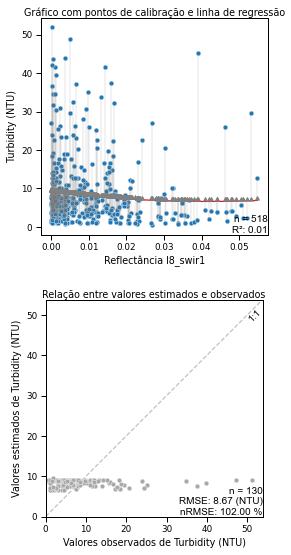


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0056
Squared-Pearson: 0.0080
R² Sklearn (RSS/TSS): 0.0056
Coeficiente(s): [ 6.1854511  -0.38004199]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.65 (NTU)
nRMSE: 102.00 %


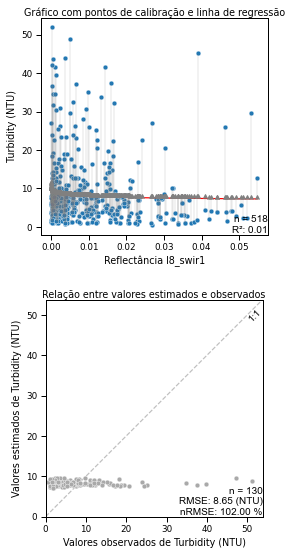


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0083
Squared-Pearson: 0.0080
R² Sklearn (RSS/TSS): 0.0083
Coeficiente(s): [ 8.99491558 -8.80690263]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.61 (NTU)
nRMSE: 101.00 %


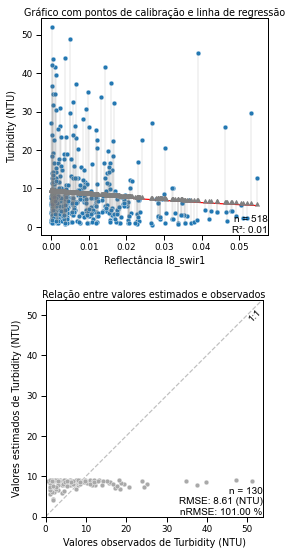

#------------- l8_swir2 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0076
Squared-Pearson: 0.0076
R² Sklearn (RSS/TSS): 0.0076
Coeficiente(s): [  8.98419693 -70.44003837]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.60 (NTU)
nRMSE: 101.00 %


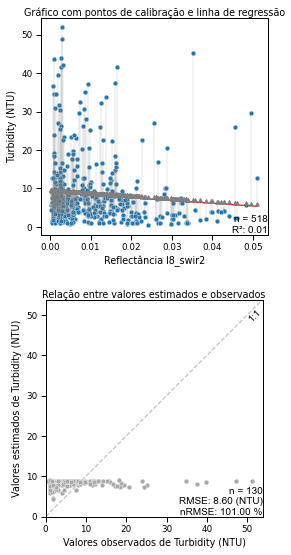


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0090
Squared-Pearson: 0.0076
R² Sklearn (RSS/TSS): 0.0090
Coeficiente(s): [   9.33297036 2271.08678341 -152.44452534]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.67 (NTU)
nRMSE: 102.00 %


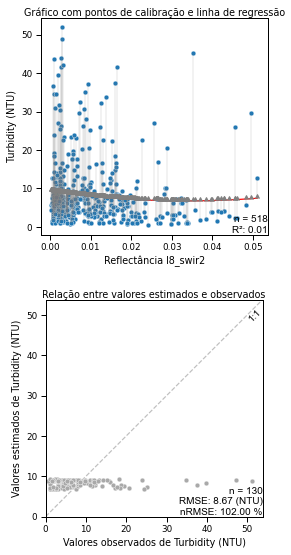


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0037
Squared-Pearson: 0.0076
R² Sklearn (RSS/TSS): 0.0037
Coeficiente(s): [ 6.00490243 -0.43855286]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.66 (NTU)
nRMSE: 102.00 %


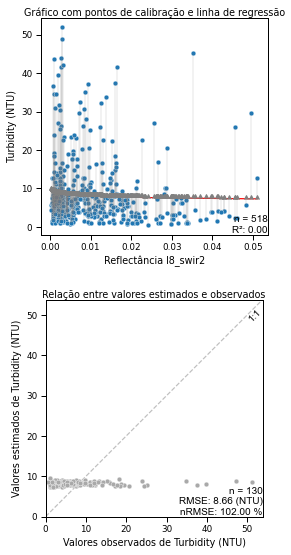


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0079
Squared-Pearson: 0.0076
R² Sklearn (RSS/TSS): 0.0079
Coeficiente(s): [ 9.06356216 -9.52229855]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 8.61 (NTU)
nRMSE: 101.00 %


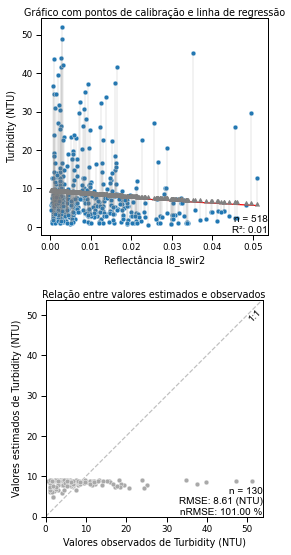

In [193]:
for x in X:
    X_train_temp = X_train.loc[:, x]
    X_test_temp = X_test.loc[:, x]
    print("#-------------", x, "---------------#")
    model_exec('linear', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('polynomial', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('log', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('exp', X_train_temp, y_train, X_test_temp, y_test)

### 5.1.2 Variável dependente: Chla

In [194]:
df_chla = df_matchups_l8.dropna(axis = 0, subset=['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'Chla (µg/L)'])

X = df_chla.iloc[:, 7:13]
y = df_chla.loc[:, 'Chla (µg/L)']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

#printing information
print('Training Features Shape:', X_train.shape)
print('Training Labels Shape:', X_test.shape)
print('Testing Features Shape:', y_train.shape)
print('Testing Labels Shape:', y_test.shape)

Training Features Shape: (518, 6)
Training Labels Shape: (130, 6)
Testing Features Shape: (518,)
Testing Labels Shape: (130,)


#------------- l8_blue ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0031
Squared-Pearson: 0.0031
R² Sklearn (RSS/TSS): 0.0031
Coeficiente(s): [ 18.51261149 102.47512011]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.70 (µg/L)
nRMSE: 91.00 %


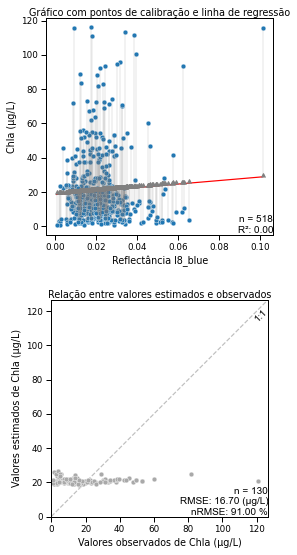


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0142
Squared-Pearson: 0.0031
R² Sklearn (RSS/TSS): 0.0142
Coeficiente(s): [  24.23676213 7651.08429966 -372.07114009]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 17.51 (µg/L)
nRMSE: 95.00 %


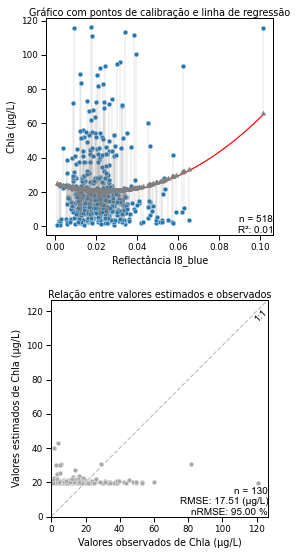


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0031
Squared-Pearson: 0.0031
R² Sklearn (RSS/TSS): 0.0031
Coeficiente(s): [29.01418068  2.08590786]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.59 (µg/L)
nRMSE: 90.00 %


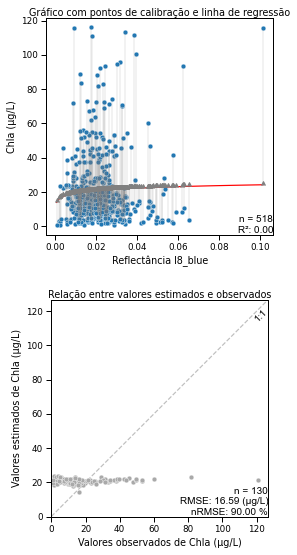


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0042
Squared-Pearson: 0.0031
R² Sklearn (RSS/TSS): 0.0042
Coeficiente(s): [18.00390529  6.32988258]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.76 (µg/L)
nRMSE: 91.00 %


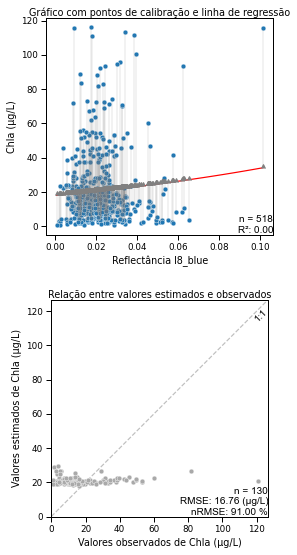

#------------- l8_green ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0749
Squared-Pearson: 0.0749
R² Sklearn (RSS/TSS): 0.0749
Coeficiente(s): [  4.14065517 305.44561382]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.55 (µg/L)
nRMSE: 90.00 %


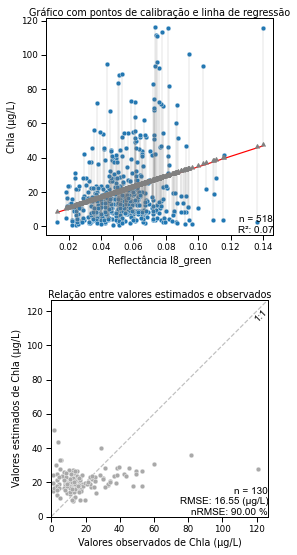


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0751
Squared-Pearson: 0.0749
R² Sklearn (RSS/TSS): 0.0751
Coeficiente(s): [   2.3969075  -524.00460003  369.43029217]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.44 (µg/L)
nRMSE: 89.00 %


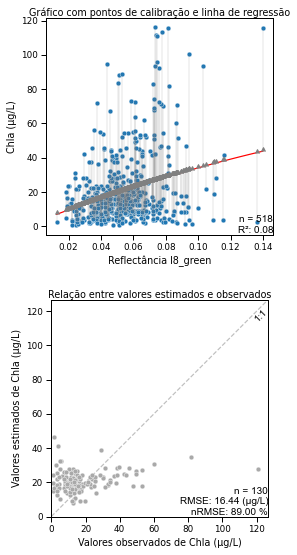


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0711
Squared-Pearson: 0.0749
R² Sklearn (RSS/TSS): 0.0711
Coeficiente(s): [66.75962456 15.46941835]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.37 (µg/L)
nRMSE: 89.00 %


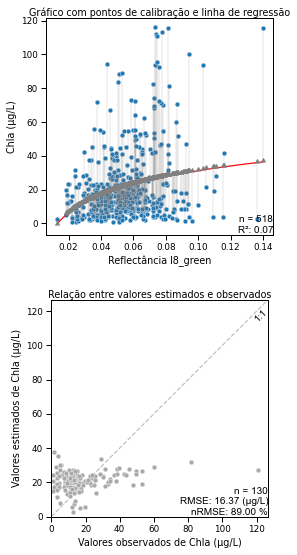


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0702
Squared-Pearson: 0.0749
R² Sklearn (RSS/TSS): 0.0702
Coeficiente(s): [10.47416318 12.12411031]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 17.08 (µg/L)
nRMSE: 93.00 %


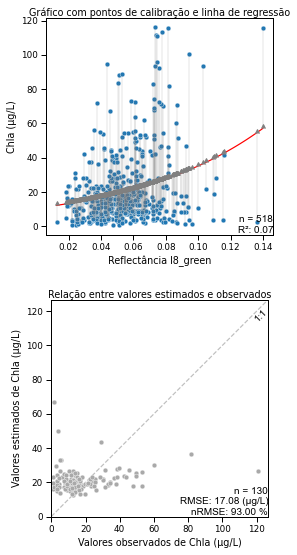

#------------- l8_red ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0784
Squared-Pearson: 0.0784
R² Sklearn (RSS/TSS): 0.0784
Coeficiente(s): [ 11.73967577 345.73903587]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 17.12 (µg/L)
nRMSE: 93.00 %


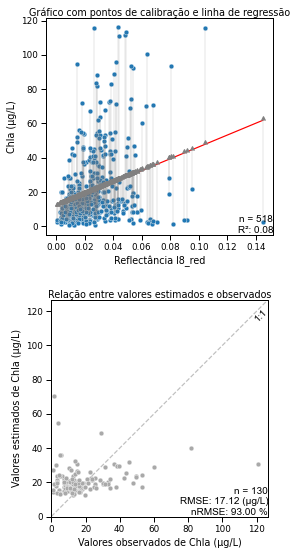


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1066
Squared-Pearson: 0.0784
R² Sklearn (RSS/TSS): 0.1066
Coeficiente(s): [ 5.39732330e+00 -5.45135664e+03  7.91759102e+02]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 15.65 (µg/L)
nRMSE: 85.00 %


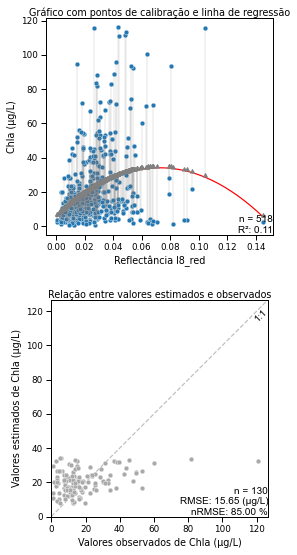


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0987
Squared-Pearson: 0.0784
R² Sklearn (RSS/TSS): 0.0987
Coeficiente(s): [56.13093002  9.14774948]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.23 (µg/L)
nRMSE: 88.00 %


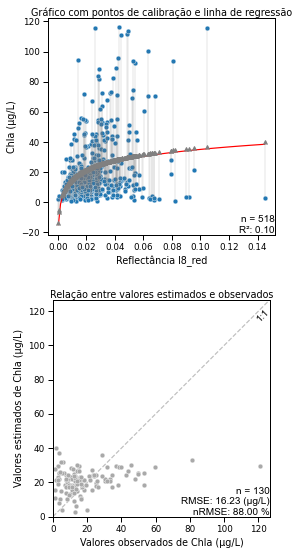


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0552
Squared-Pearson: 0.0784
R² Sklearn (RSS/TSS): 0.0552
Coeficiente(s): [16.04879315  9.62049032]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 17.69 (µg/L)
nRMSE: 96.00 %


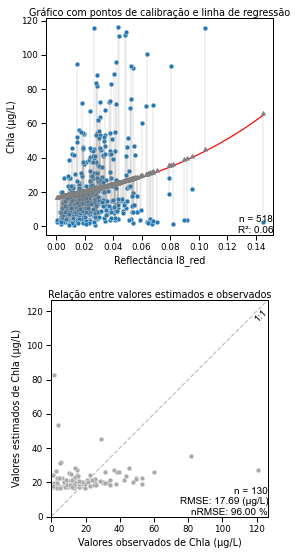

#------------- l8_nir ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0291
Squared-Pearson: 0.0291
R² Sklearn (RSS/TSS): 0.0291
Coeficiente(s): [ 17.90874422 291.74806137]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.37 (µg/L)
nRMSE: 89.00 %


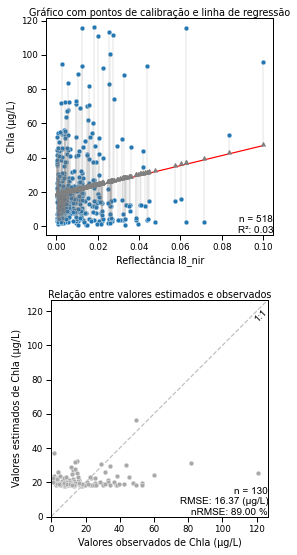


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0305
Squared-Pearson: 0.0291
R² Sklearn (RSS/TSS): 0.0305
Coeficiente(s): [  18.50540162 2239.08307824  174.14024814]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.60 (µg/L)
nRMSE: 90.00 %


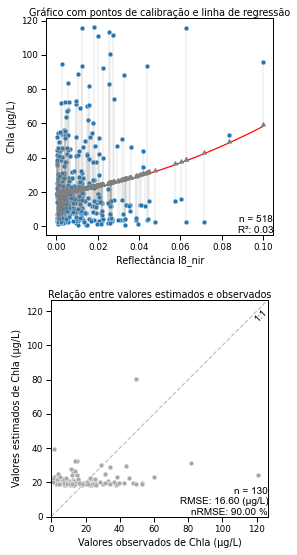


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0208
Squared-Pearson: 0.0291
R² Sklearn (RSS/TSS): 0.0208
Coeficiente(s): [33.50509323  2.3877303 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.59 (µg/L)
nRMSE: 90.00 %


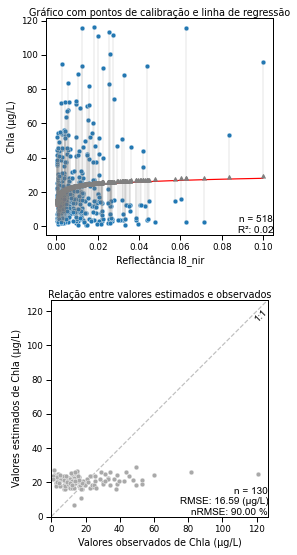


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0316
Squared-Pearson: 0.0291
R² Sklearn (RSS/TSS): 0.0316
Coeficiente(s): [18.22374351 11.94730194]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.73 (µg/L)
nRMSE: 91.00 %


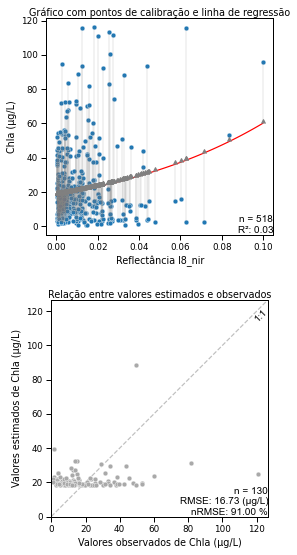

#------------- l8_swir1 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0096
Squared-Pearson: 0.0096
R² Sklearn (RSS/TSS): 0.0096
Coeficiente(s): [  22.47535275 -167.6436333 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.70 (µg/L)
nRMSE: 91.00 %


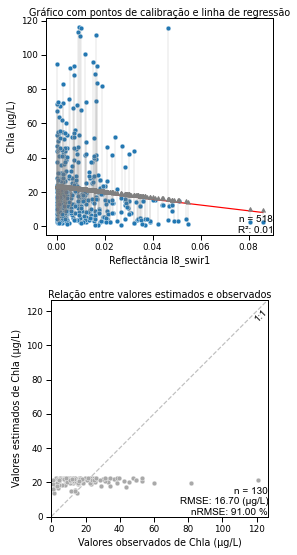


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0159
Squared-Pearson: 0.0096
R² Sklearn (RSS/TSS): 0.0159
Coeficiente(s): [   21.21451729 -5977.53433418   105.223951  ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.59 (µg/L)
nRMSE: 90.00 %


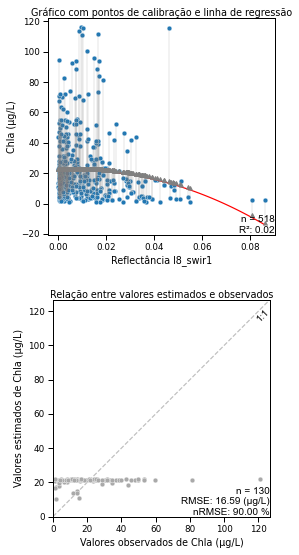


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0000
Squared-Pearson: 0.0096
R² Sklearn (RSS/TSS): 0.0000
Coeficiente(s): [2.08515673e+01 1.61358350e-02]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.72 (µg/L)
nRMSE: 91.00 %


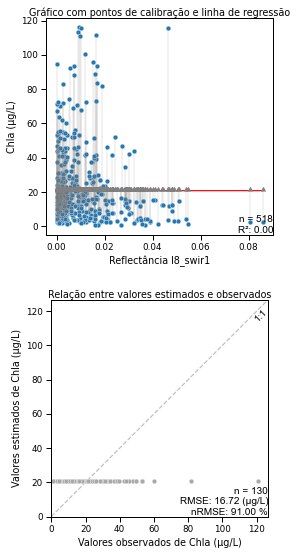


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0082
Squared-Pearson: 0.0096
R² Sklearn (RSS/TSS): 0.0082
Coeficiente(s): [22.32928114 -7.43805301]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.71 (µg/L)
nRMSE: 91.00 %


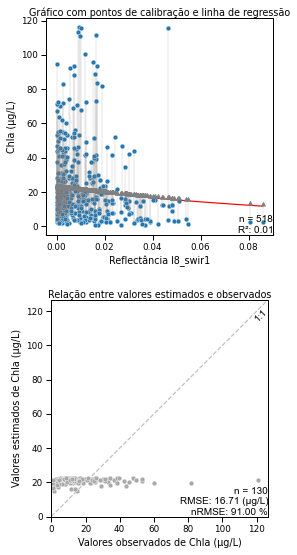

#------------- l8_swir2 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0133
Squared-Pearson: 0.0133
R² Sklearn (RSS/TSS): 0.0133
Coeficiente(s): [  23.05911003 -225.34187575]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.67 (µg/L)
nRMSE: 91.00 %


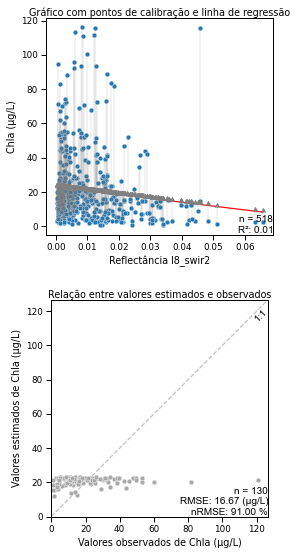


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0176
Squared-Pearson: 0.0133
R² Sklearn (RSS/TSS): 0.0176
Coeficiente(s): [   21.66114427 -7707.34681279    78.49294043]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.57 (µg/L)
nRMSE: 90.00 %


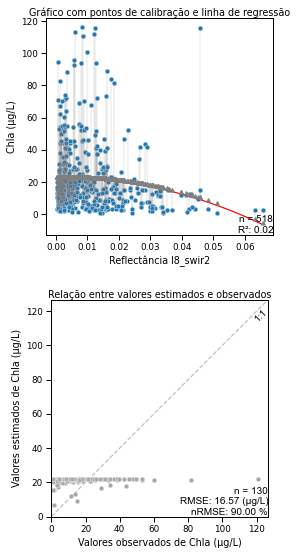


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0009
Squared-Pearson: 0.0133
R² Sklearn (RSS/TSS): 0.0009
Coeficiente(s): [17.8813228  -0.55769486]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.75 (µg/L)
nRMSE: 91.00 %


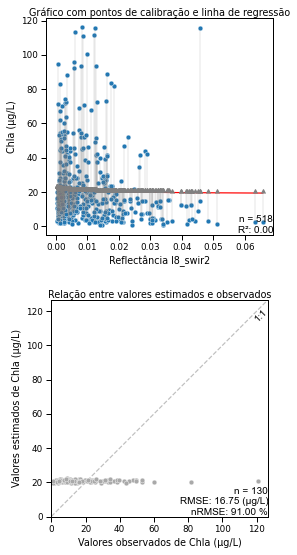


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0119
Squared-Pearson: 0.0133
R² Sklearn (RSS/TSS): 0.0119
Coeficiente(s): [ 22.98624038 -10.49684054]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 16.68 (µg/L)
nRMSE: 91.00 %


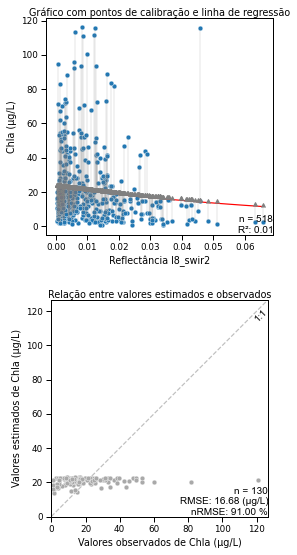

In [195]:
for x in X:
    X_train_temp = X_train.loc[:, x]
    X_test_temp = X_test.loc[:, x]
    print("#-------------", x, "---------------#")
    model_exec('linear', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('polynomial', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('log', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('exp', X_train_temp, y_train, X_test_temp, y_test)

### 5.1.3 Variável dependente: CDOM

In [196]:
df_CDOM = df_matchups_l8.dropna(axis = 0, subset=['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'CDOM 400 nm (m-1)'])

X = df_CDOM.iloc[:, 7:13]
y = df_CDOM.loc[:, 'CDOM 400 nm (m-1)']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

#printing information
print('Training Features Shape:', X_train.shape)
print('Training Labels Shape:', X_test.shape)
print('Testing Features Shape:', y_train.shape)
print('Testing Labels Shape:', y_test.shape)

Training Features Shape: (518, 6)
Training Labels Shape: (130, 6)
Testing Features Shape: (518,)
Testing Labels Shape: (130,)


#------------- l8_blue ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0147
Squared-Pearson: 0.0147
R² Sklearn (RSS/TSS): 0.0147
Coeficiente(s): [ 1.31664697 -8.99281558]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.83 (m-1)
nRMSE: 76.00 %


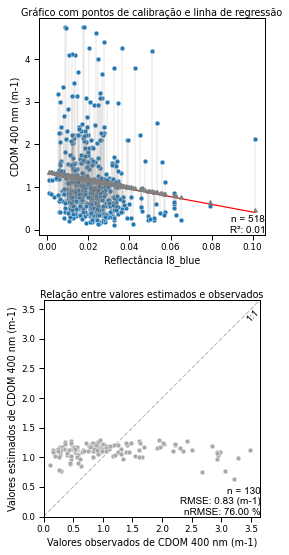


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0212
Squared-Pearson: 0.0147
R² Sklearn (RSS/TSS): 0.0212
Coeficiente(s): [  1.49840271 232.06269001 -23.86271021]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.82 (m-1)
nRMSE: 75.00 %


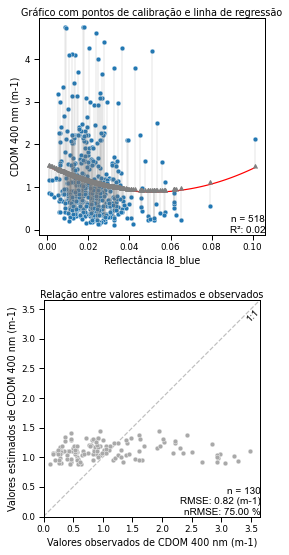


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0155
Squared-Pearson: 0.0147
R² Sklearn (RSS/TSS): 0.0155
Coeficiente(s): [ 0.35708986 -0.19231571]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.82 (m-1)
nRMSE: 75.00 %


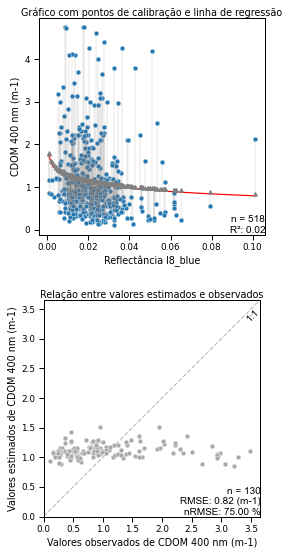


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0167
Squared-Pearson: 0.0147
R² Sklearn (RSS/TSS): 0.0167
Coeficiente(s): [ 1.37901931 -9.82602165]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.83 (m-1)
nRMSE: 76.00 %


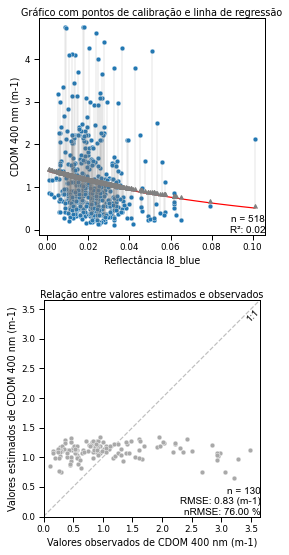

#------------- l8_green ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0044
Squared-Pearson: 0.0044
R² Sklearn (RSS/TSS): 0.0044
Coeficiente(s): [0.94847383 3.13186053]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.80 (m-1)
nRMSE: 73.00 %


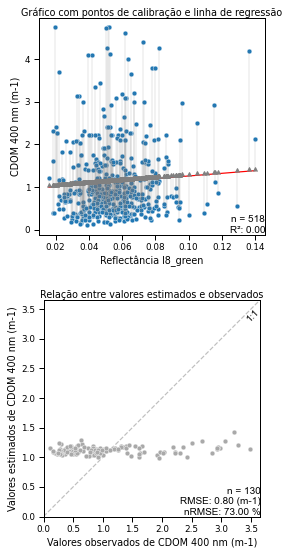


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0115
Squared-Pearson: 0.0044
R² Sklearn (RSS/TSS): 0.0115
Coeficiente(s): [  1.36991627 121.12676681 -11.9805087 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.78 (m-1)
nRMSE: 71.00 %


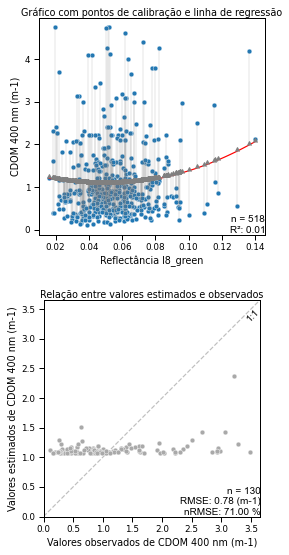


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0016
Squared-Pearson: 0.0044
R² Sklearn (RSS/TSS): 0.0016
Coeficiente(s): [1.41701439 0.10032009]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.80 (m-1)
nRMSE: 74.00 %


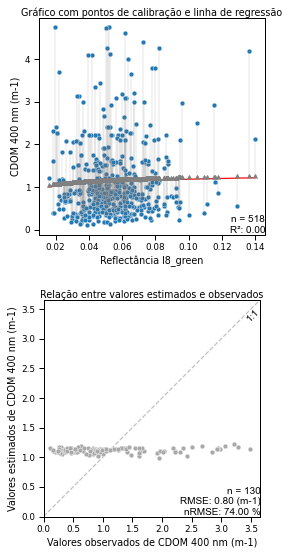


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0050
Squared-Pearson: 0.0044
R² Sklearn (RSS/TSS): 0.0050
Coeficiente(s): [0.9445186  3.07861994]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.79 (m-1)
nRMSE: 73.00 %


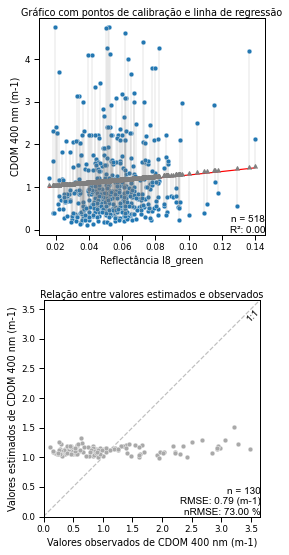

#------------- l8_red ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1371
Squared-Pearson: 0.1371
R² Sklearn (RSS/TSS): 0.1371
Coeficiente(s): [ 0.62283411 18.87862901]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.69 (m-1)
nRMSE: 64.00 %


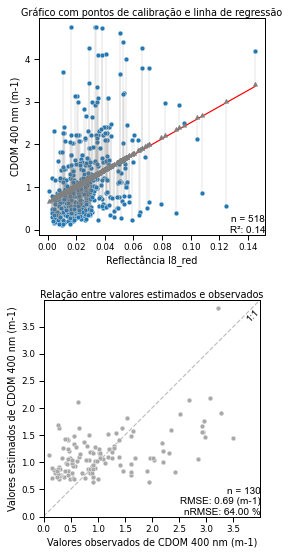


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1475
Squared-Pearson: 0.1371
R² Sklearn (RSS/TSS): 0.1475
Coeficiente(s): [   0.45296403 -126.84360367   30.12549403]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.70 (m-1)
nRMSE: 65.00 %


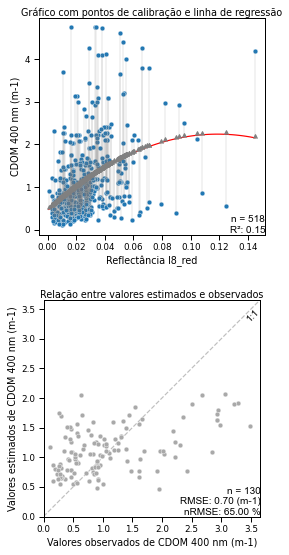


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1324
Squared-Pearson: 0.1371
R² Sklearn (RSS/TSS): 0.1324
Coeficiente(s): [2.95522084 0.47791071]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.75 (m-1)
nRMSE: 69.00 %


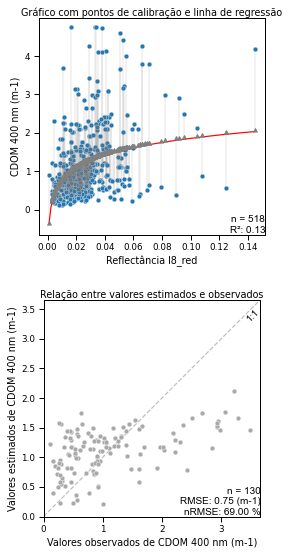


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1122
Squared-Pearson: 0.1371
R² Sklearn (RSS/TSS): 0.1122
Coeficiente(s): [ 0.83520947 10.63016049]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.72 (m-1)
nRMSE: 66.00 %


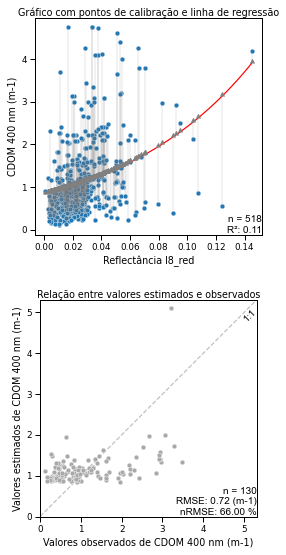

#------------- l8_nir ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0887
Squared-Pearson: 0.0887
R² Sklearn (RSS/TSS): 0.0887
Coeficiente(s): [ 0.91886516 20.5029641 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.76 (m-1)
nRMSE: 70.00 %


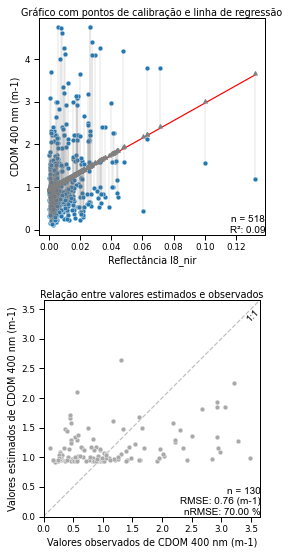


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1165
Squared-Pearson: 0.0887
R² Sklearn (RSS/TSS): 0.1165
Coeficiente(s): [   0.81679627 -268.39233085   38.1079613 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.76 (m-1)
nRMSE: 70.00 %


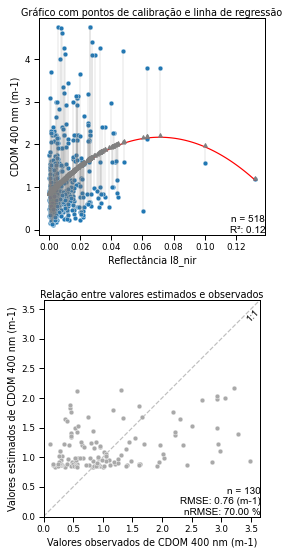


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0908
Squared-Pearson: 0.0887
R² Sklearn (RSS/TSS): 0.0908
Coeficiente(s): [2.2281346 0.2080342]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.76 (m-1)
nRMSE: 70.00 %


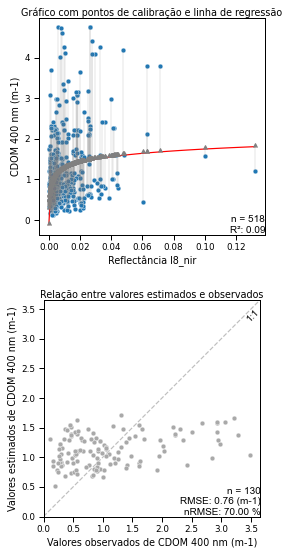


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0609
Squared-Pearson: 0.0887
R² Sklearn (RSS/TSS): 0.0609
Coeficiente(s): [1.01667872 9.51031807]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.77 (m-1)
nRMSE: 71.00 %


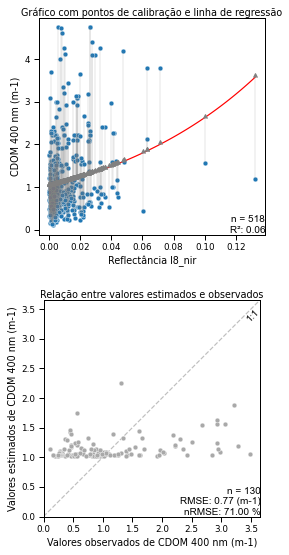

#------------- l8_swir1 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1112
Squared-Pearson: 0.1112
R² Sklearn (RSS/TSS): 0.1112
Coeficiente(s): [ 0.8699286 24.8574215]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.78 (m-1)
nRMSE: 71.00 %


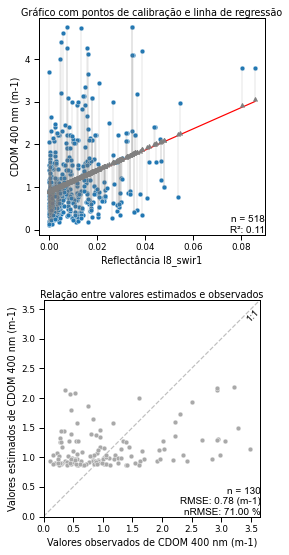


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1113
Squared-Pearson: 0.1112
R² Sklearn (RSS/TSS): 0.1113
Coeficiente(s): [ 0.8766493  32.46271973 23.40624795]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.78 (m-1)
nRMSE: 71.00 %


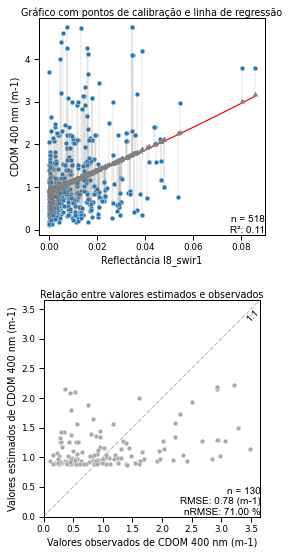


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0841
Squared-Pearson: 0.1112
R² Sklearn (RSS/TSS): 0.0841
Coeficiente(s): [1.98909039 0.15846674]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.78 (m-1)
nRMSE: 72.00 %


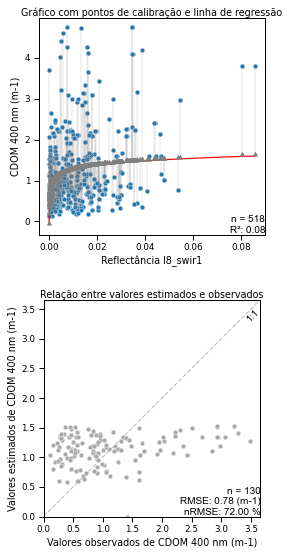


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1090
Squared-Pearson: 0.1112
R² Sklearn (RSS/TSS): 0.1090
Coeficiente(s): [ 0.92793488 16.60804877]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.78 (m-1)
nRMSE: 71.00 %


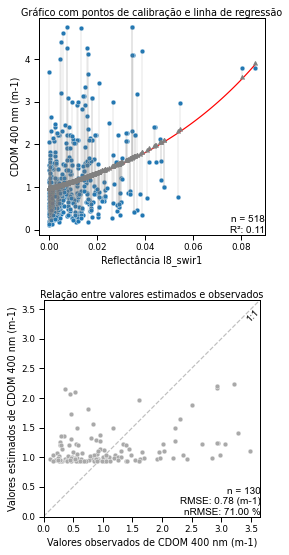

#------------- l8_swir2 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1033
Squared-Pearson: 0.1033
R² Sklearn (RSS/TSS): 0.1033
Coeficiente(s): [ 0.84510795 27.37422074]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.79 (m-1)
nRMSE: 72.00 %


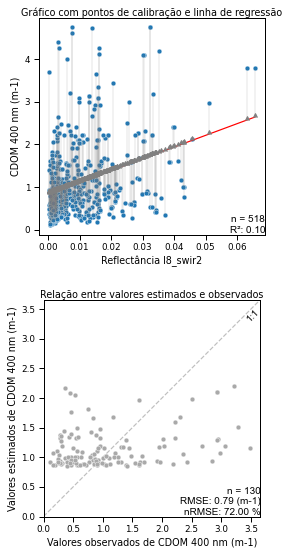


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1036
Squared-Pearson: 0.1033
R² Sklearn (RSS/TSS): 0.1036
Coeficiente(s): [ 0.86082323 90.26067688 23.92987232]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.79 (m-1)
nRMSE: 72.00 %


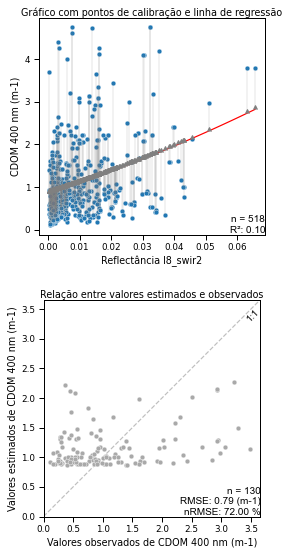


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0909
Squared-Pearson: 0.1033
R² Sklearn (RSS/TSS): 0.0909
Coeficiente(s): [2.31999888 0.23229083]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.78 (m-1)
nRMSE: 72.00 %


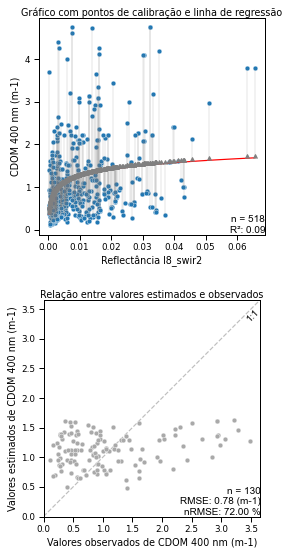


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1037
Squared-Pearson: 0.1033
R² Sklearn (RSS/TSS): 0.1037
Coeficiente(s): [ 0.89668195 19.79107718]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.79 (m-1)
nRMSE: 72.00 %


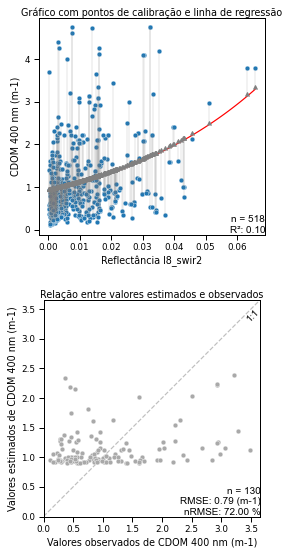

In [197]:
for x in X:
    X_train_temp = X_train.loc[:, x]
    X_test_temp = X_test.loc[:, x]
    print("#-------------", x, "---------------#")
    model_exec('linear', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('polynomial', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('log', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('exp', X_train_temp, y_train, X_test_temp, y_test)

### 5.1.4 Variável dependente: Profundidade do Disco de Secchi

In [198]:
df_SDD = df_matchups_l8.dropna(axis = 0, subset=['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'SDD (m)'])

X = df_SDD.iloc[:, 7:13]
y = df_SDD.loc[:, 'SDD (m)']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

#printing information
print('Training Features Shape:', X_train.shape)
print('Training Labels Shape:', X_test.shape)
print('Testing Features Shape:', y_train.shape)
print('Testing Labels Shape:', y_test.shape)

Training Features Shape: (518, 6)
Training Labels Shape: (130, 6)
Testing Features Shape: (518,)
Testing Labels Shape: (130,)


#------------- l8_blue ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0717
Squared-Pearson: 0.0717
R² Sklearn (RSS/TSS): 0.0717
Coeficiente(s): [  1.74596037 -17.69136639]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.81 (m)
nRMSE: 63.00 %


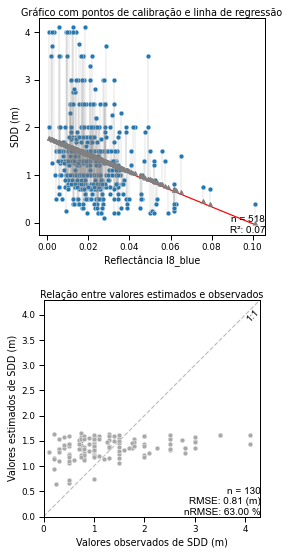


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0786
Squared-Pearson: 0.0717
R² Sklearn (RSS/TSS): 0.0786
Coeficiente(s): [  1.91962572 214.64343186 -31.73369835]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.80 (m)
nRMSE: 63.00 %


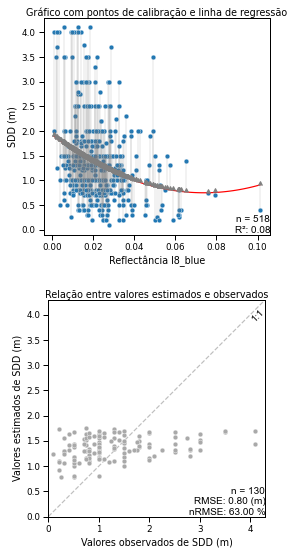


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0976
Squared-Pearson: 0.0717
R² Sklearn (RSS/TSS): 0.0976
Coeficiente(s): [-0.3571558  -0.43198297]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.81 (m)
nRMSE: 64.00 %


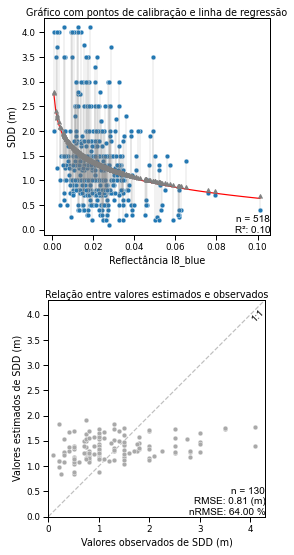


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0787
Squared-Pearson: 0.0717
R² Sklearn (RSS/TSS): 0.0787
Coeficiente(s): [  1.9066835  -16.30388215]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.80 (m)
nRMSE: 63.00 %


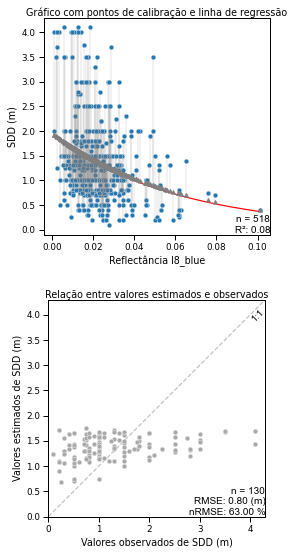

#------------- l8_green ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1955
Squared-Pearson: 0.1955
R² Sklearn (RSS/TSS): 0.1955
Coeficiente(s): [  2.35619406 -18.48968747]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.71 (m)
nRMSE: 56.00 %


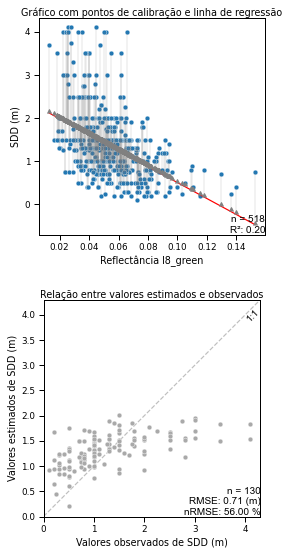


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2185
Squared-Pearson: 0.1955
R² Sklearn (RSS/TSS): 0.2185
Coeficiente(s): [  2.98228567 174.4801488  -40.72047516]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.70 (m)
nRMSE: 55.00 %


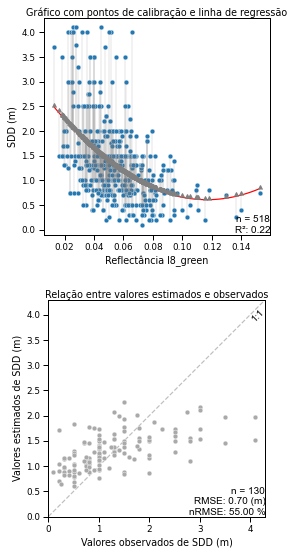


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2189
Squared-Pearson: 0.1955
R² Sklearn (RSS/TSS): 0.2189
Coeficiente(s): [-1.71989261 -1.03132657]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.70 (m)
nRMSE: 55.00 %


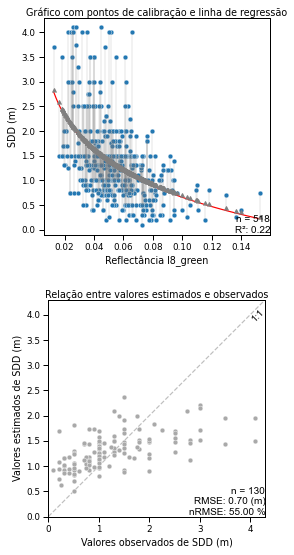


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2184
Squared-Pearson: 0.1955
R² Sklearn (RSS/TSS): 0.2184
Coeficiente(s): [  3.12228021 -16.29839404]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.70 (m)
nRMSE: 55.00 %


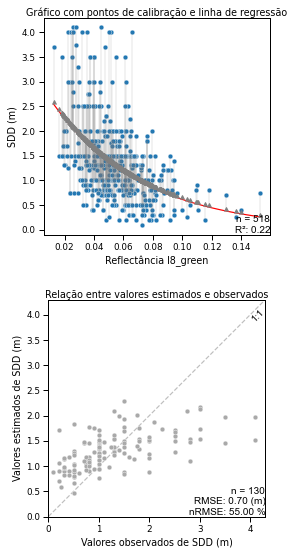

#------------- l8_red ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.1519
Squared-Pearson: 0.1519
R² Sklearn (RSS/TSS): 0.1519
Coeficiente(s): [  1.79570601 -16.8762163 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.75 (m)
nRMSE: 59.00 %


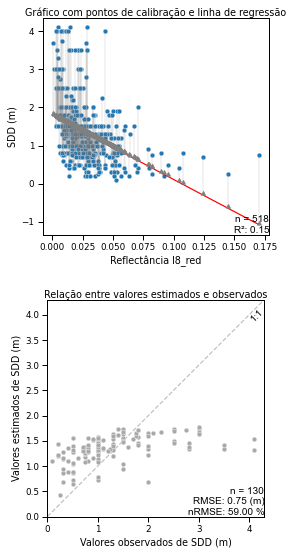


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2020
Squared-Pearson: 0.1519
R² Sklearn (RSS/TSS): 0.2020
Coeficiente(s): [  2.09970314 191.86535312 -36.06339714]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.72 (m)
nRMSE: 57.00 %


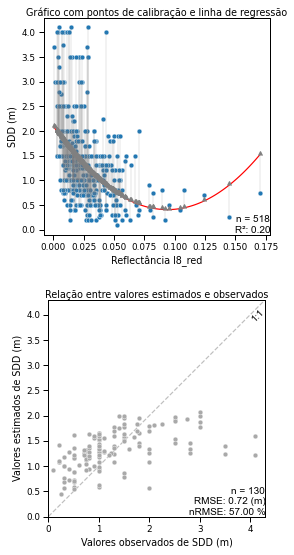


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2525
Squared-Pearson: 0.1519
R² Sklearn (RSS/TSS): 0.2525
Coeficiente(s): [-0.87722725 -0.57672823]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.71 (m)
nRMSE: 56.00 %


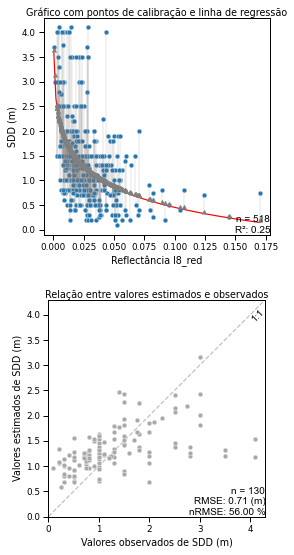


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.2102
Squared-Pearson: 0.1519
R² Sklearn (RSS/TSS): 0.2102
Coeficiente(s): [  2.25871947 -22.44052016]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.71 (m)
nRMSE: 56.00 %


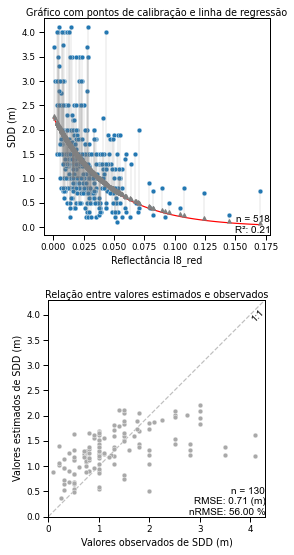

#------------- l8_nir ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0005
Squared-Pearson: 0.0005
R² Sklearn (RSS/TSS): 0.0005
Coeficiente(s): [ 1.36380563 -1.3197102 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.84 (m)
nRMSE: 66.00 %


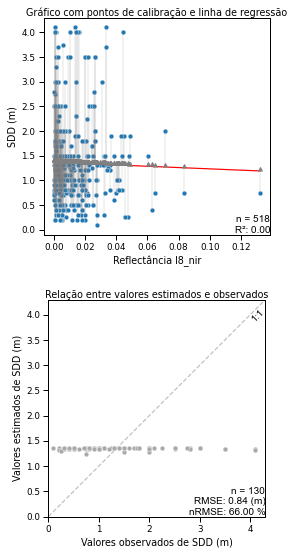


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0011
Squared-Pearson: 0.0005
R² Sklearn (RSS/TSS): 0.0011
Coeficiente(s): [  1.35001059 -39.68222436   1.14131709]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.84 (m)
nRMSE: 66.00 %


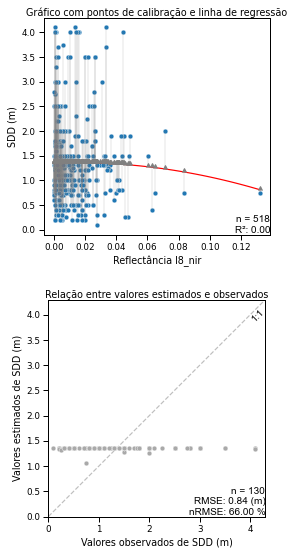


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0019
Squared-Pearson: 0.0005
R² Sklearn (RSS/TSS): 0.0019
Coeficiente(s): [ 1.20223699 -0.0278098 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.84 (m)
nRMSE: 66.00 %


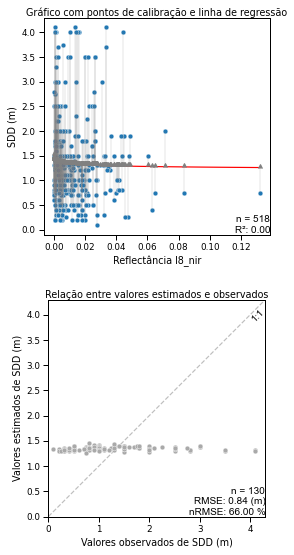


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0004
Squared-Pearson: 0.0005
R² Sklearn (RSS/TSS): 0.0004
Coeficiente(s): [ 1.36341598 -0.95125123]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.84 (m)
nRMSE: 66.00 %


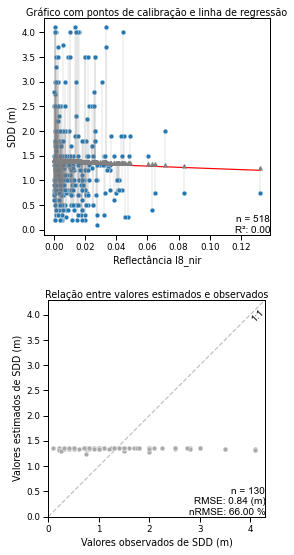

#------------- l8_swir1 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0402
Squared-Pearson: 0.0402
R² Sklearn (RSS/TSS): 0.0402
Coeficiente(s): [ 1.21297256 13.26000748]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.81 (m)
nRMSE: 64.00 %


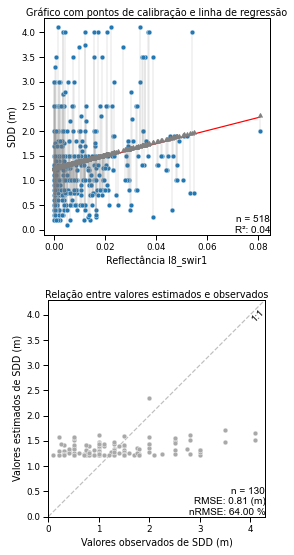


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0407
Squared-Pearson: 0.0402
R² Sklearn (RSS/TSS): 0.0407
Coeficiente(s): [  1.1978419  -81.15339979  16.75741895]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.81 (m)
nRMSE: 64.00 %


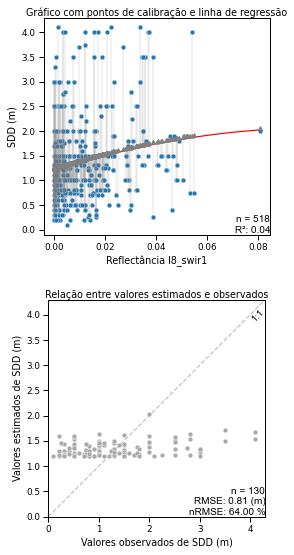


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0255
Squared-Pearson: 0.0402
R² Sklearn (RSS/TSS): 0.0255
Coeficiente(s): [1.79461222 0.08118904]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.83 (m)
nRMSE: 65.00 %


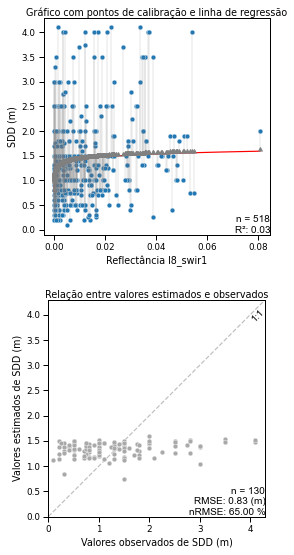


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0390
Squared-Pearson: 0.0402
R² Sklearn (RSS/TSS): 0.0390
Coeficiente(s): [1.22851479 8.57490113]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.81 (m)
nRMSE: 64.00 %


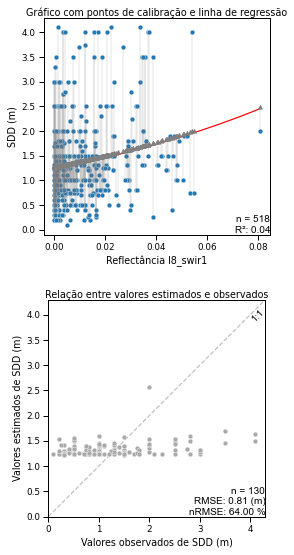

#------------- l8_swir2 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0395
Squared-Pearson: 0.0395
R² Sklearn (RSS/TSS): 0.0395
Coeficiente(s): [ 1.19751704 14.79330937]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.81 (m)
nRMSE: 64.00 %


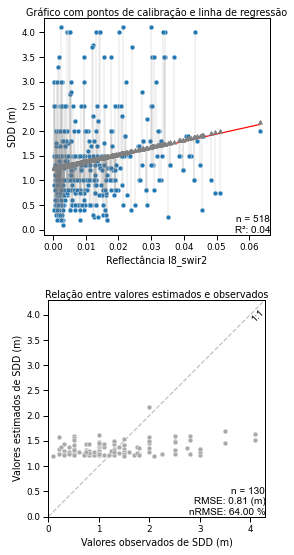


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0408
Squared-Pearson: 0.0395
R² Sklearn (RSS/TSS): 0.0408
Coeficiente(s): [   1.16573858 -182.85061782   21.89448567]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.81 (m)
nRMSE: 64.00 %


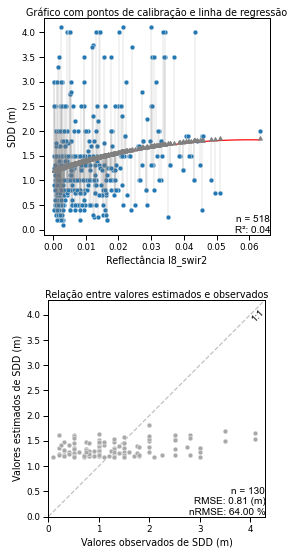


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0257
Squared-Pearson: 0.0395
R² Sklearn (RSS/TSS): 0.0257
Coeficiente(s): [1.92956174 0.11211749]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.82 (m)
nRMSE: 65.00 %


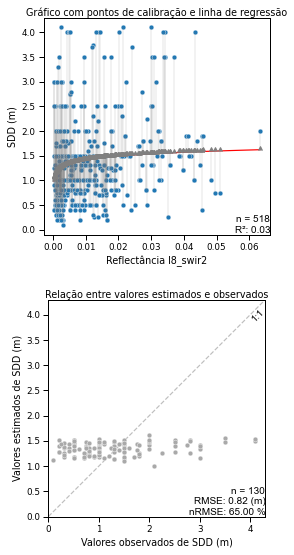


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 518
R²: 0.0381
Squared-Pearson: 0.0395
R² Sklearn (RSS/TSS): 0.0381
Coeficiente(s): [1.21583883 9.61310055]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 130.0000
RMSE: 0.81 (m)
nRMSE: 64.00 %


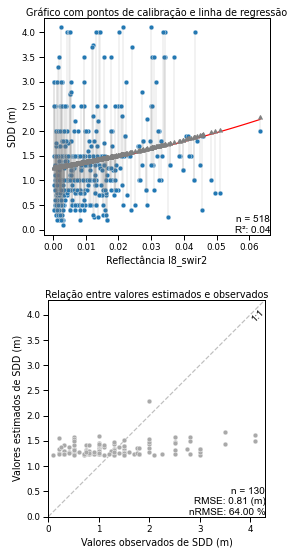

In [199]:
for x in X:
    X_train_temp = X_train.loc[:, x]
    X_test_temp = X_test.loc[:, x]
    print("#-------------", x, "---------------#")
    model_exec('linear', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('polynomial', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('log', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('exp', X_train_temp, y_train, X_test_temp, y_test)

### 5.1.5 Variável dependente: Sólidos suspensos totais

In [468]:
df_TSS = df_matchups_l8.dropna(axis = 0, subset=['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'TSS (mg/L)'])

X = df_TSS.iloc[:, 7:13]
y = df_TSS.loc[:, 'TSS (mg/L)']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

#printing information
print('Training Features Shape:', X_train.shape)
print('Training Labels Shape:', X_test.shape)
print('Testing Features Shape:', y_train.shape)
print('Testing Labels Shape:', y_test.shape)

Training Features Shape: (628, 6)
Training Labels Shape: (157, 6)
Testing Features Shape: (628,)
Testing Labels Shape: (157,)


#------------- l8_blue ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0236
Squared-Pearson: 0.0236
R² Sklearn (RSS/TSS): 0.0236
Coeficiente(s): [ 8.31228572 61.61524167]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.67 (mg/L)
nRMSE: 83.00 %


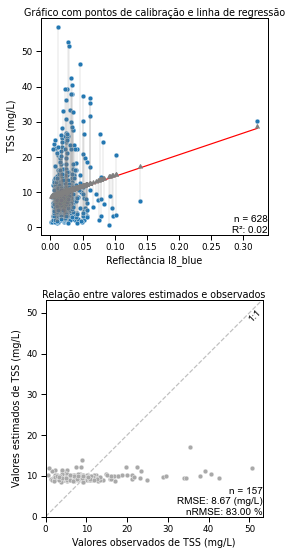


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0237
Squared-Pearson: 0.0236
R² Sklearn (RSS/TSS): 0.0237
Coeficiente(s): [  8.19029689 -36.09289434  68.0846518 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.67 (mg/L)
nRMSE: 83.00 %


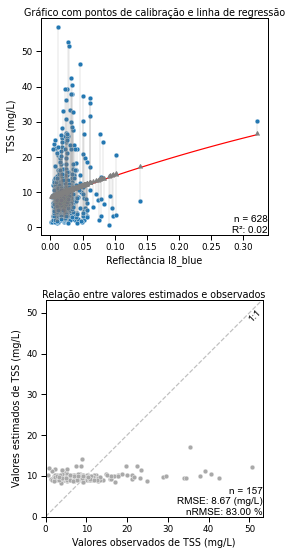


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0238
Squared-Pearson: 0.0236
R² Sklearn (RSS/TSS): 0.0238
Coeficiente(s): [17.52737568  1.97275693]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.70 (mg/L)
nRMSE: 84.00 %


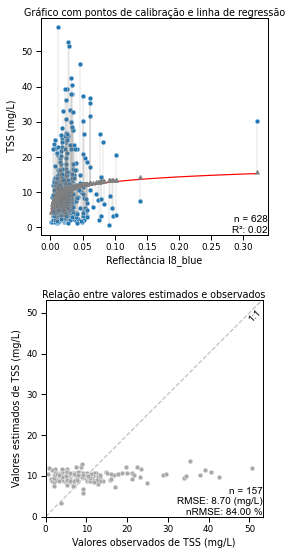


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0213
Squared-Pearson: 0.0236
R² Sklearn (RSS/TSS): 0.0213
Coeficiente(s): [8.8867195  3.94673467]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.72 (mg/L)
nRMSE: 84.00 %


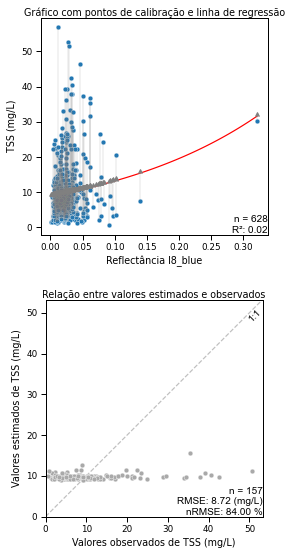

#------------- l8_green ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0934
Squared-Pearson: 0.0934
R² Sklearn (RSS/TSS): 0.0934
Coeficiente(s): [ 4.42363248 94.64906343]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.17 (mg/L)
nRMSE: 79.00 %


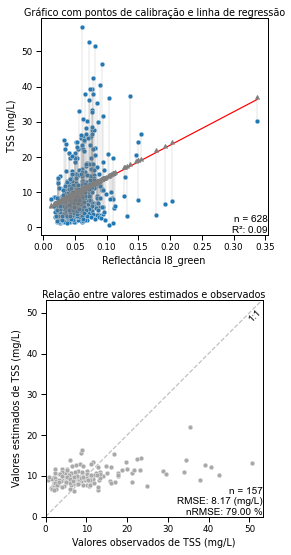


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.1041
Squared-Pearson: 0.0934
R² Sklearn (RSS/TSS): 0.1041
Coeficiente(s): [   2.22342516 -299.44358782  153.79447854]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.11 (mg/L)
nRMSE: 78.00 %


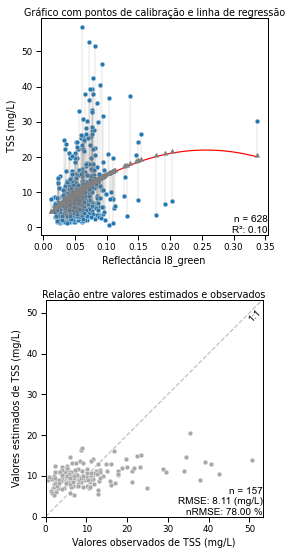


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.1020
Squared-Pearson: 0.0934
R² Sklearn (RSS/TSS): 0.1020
Coeficiente(s): [28.21085178  6.24060903]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.19 (mg/L)
nRMSE: 79.00 %


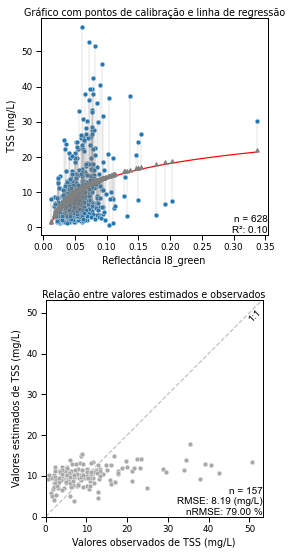


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0668
Squared-Pearson: 0.0934
R² Sklearn (RSS/TSS): 0.0668
Coeficiente(s): [7.35064554 5.0062615 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.41 (mg/L)
nRMSE: 81.00 %


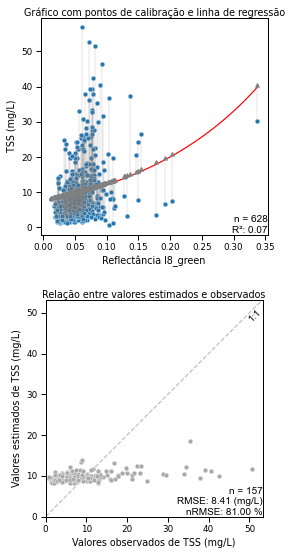

#------------- l8_red ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0868
Squared-Pearson: 0.0868
R² Sklearn (RSS/TSS): 0.0868
Coeficiente(s): [ 7.25047422 87.49334457]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.21 (mg/L)
nRMSE: 79.00 %


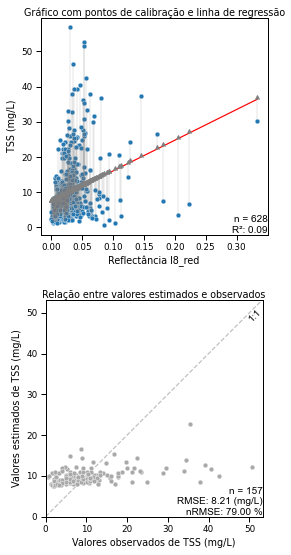


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.1151
Squared-Pearson: 0.0868
R² Sklearn (RSS/TSS): 0.1151
Coeficiente(s): [   5.56257361 -450.37284778  169.29723538]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.05 (mg/L)
nRMSE: 77.00 %


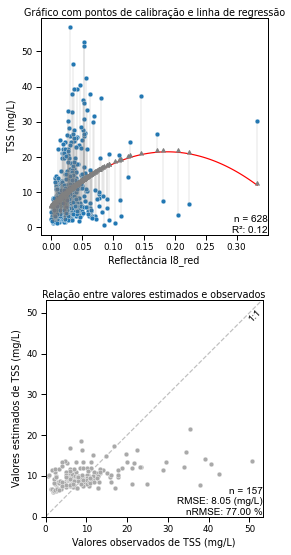


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.1372
Squared-Pearson: 0.0868
R² Sklearn (RSS/TSS): 0.1372
Coeficiente(s): [24.20995338  3.77660032]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.10 (mg/L)
nRMSE: 78.00 %


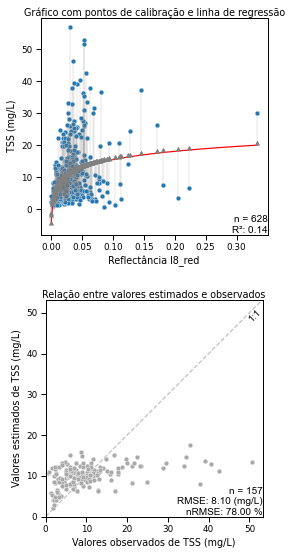


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0585
Squared-Pearson: 0.0868
R² Sklearn (RSS/TSS): 0.0585
Coeficiente(s): [8.61620942 4.33622843]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.47 (mg/L)
nRMSE: 81.00 %


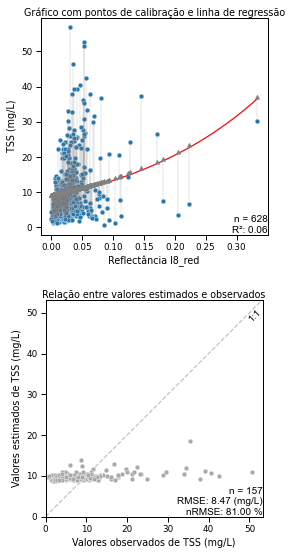

#------------- l8_nir ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0041
Squared-Pearson: 0.0041
R² Sklearn (RSS/TSS): 0.0041
Coeficiente(s): [ 9.54681566 20.85606419]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.86 (mg/L)
nRMSE: 85.00 %


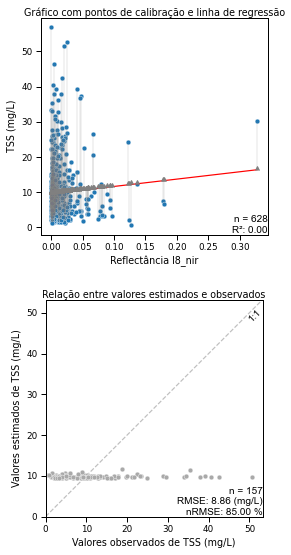


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0057
Squared-Pearson: 0.0041
R² Sklearn (RSS/TSS): 0.0057
Coeficiente(s): [  9.70750383 116.0417862    1.36066678]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.86 (mg/L)
nRMSE: 85.00 %


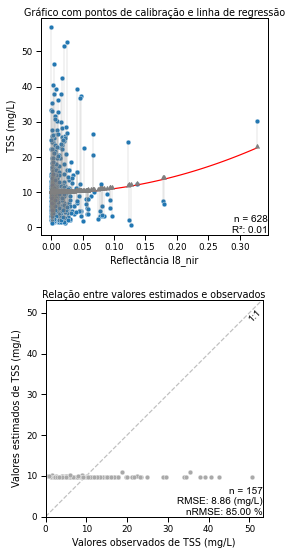


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0081
Squared-Pearson: 0.0041
R² Sklearn (RSS/TSS): 0.0081
Coeficiente(s): [12.34297897  0.46977008]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.85 (mg/L)
nRMSE: 85.00 %


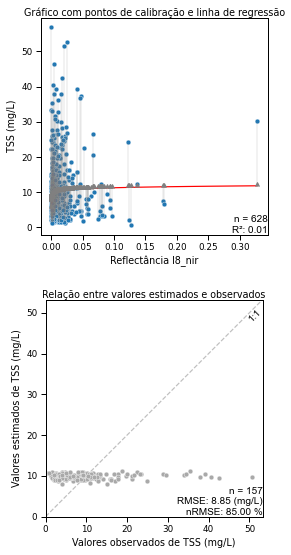


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0048
Squared-Pearson: 0.0041
R² Sklearn (RSS/TSS): 0.0048
Coeficiente(s): [9.53768271 2.09658205]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.86 (mg/L)
nRMSE: 85.00 %


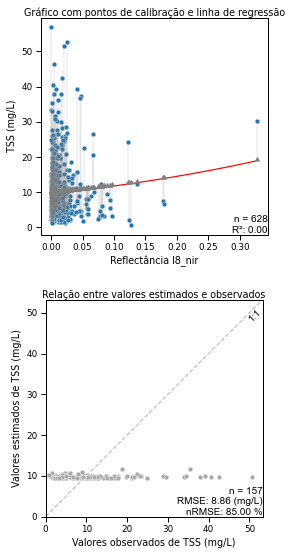

#------------- l8_swir1 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0013
Squared-Pearson: 0.0013
R² Sklearn (RSS/TSS): 0.0013
Coeficiente(s): [  9.96208626 -10.97907032]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.86 (mg/L)
nRMSE: 85.00 %


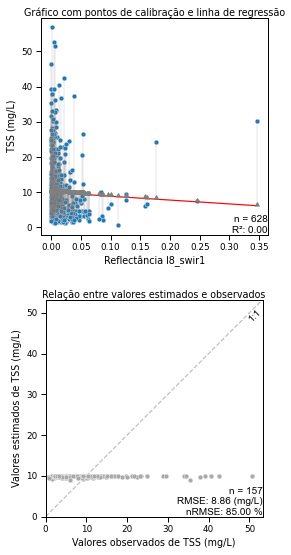


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0308
Squared-Pearson: 0.0013
R² Sklearn (RSS/TSS): 0.0308
Coeficiente(s): [ 10.73600687 437.57183336 -94.67735707]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.78 (mg/L)
nRMSE: 84.00 %


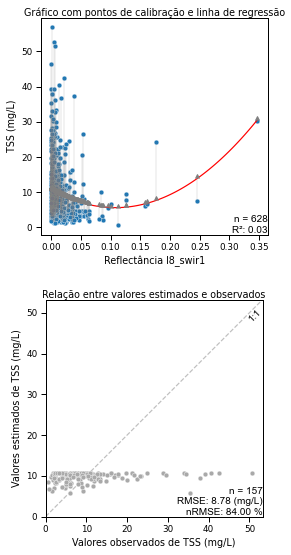


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0093
Squared-Pearson: 0.0013
R² Sklearn (RSS/TSS): 0.0093
Coeficiente(s): [ 7.383934   -0.45150397]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.73 (mg/L)
nRMSE: 84.00 %


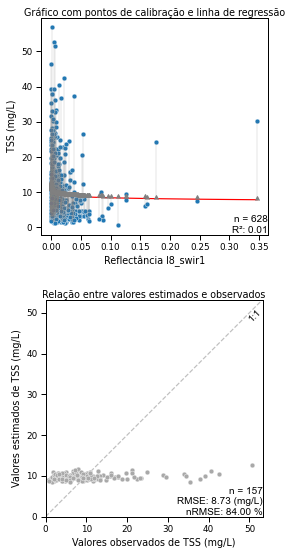


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0043
Squared-Pearson: 0.0013
R² Sklearn (RSS/TSS): 0.0043
Coeficiente(s): [10.40078245 -4.94824925]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.81 (mg/L)
nRMSE: 85.00 %


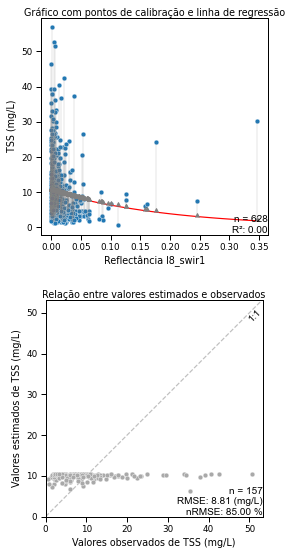

#------------- l8_swir2 ---------------#

#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0013
Squared-Pearson: 0.0013
R² Sklearn (RSS/TSS): 0.0013
Coeficiente(s): [  9.97663855 -12.3800798 ]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.85 (mg/L)
nRMSE: 85.00 %


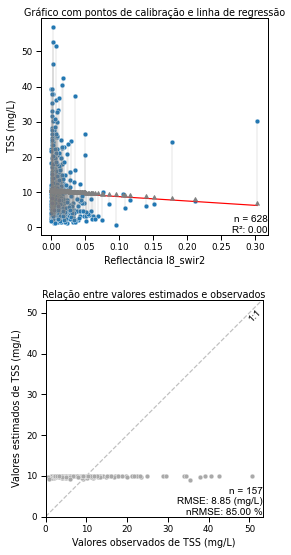


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0334
Squared-Pearson: 0.0013
R² Sklearn (RSS/TSS): 0.0334
Coeficiente(s): [  10.90065634  598.58361093 -113.33809211]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.78 (mg/L)
nRMSE: 84.00 %


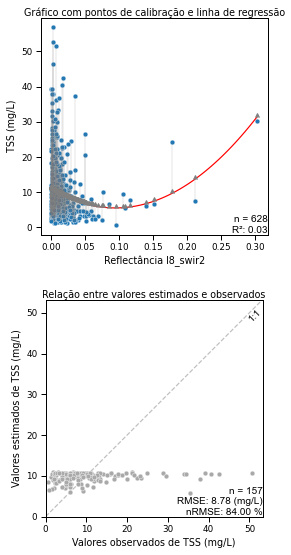


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0077
Squared-Pearson: 0.0013
R² Sklearn (RSS/TSS): 0.0077
Coeficiente(s): [ 6.99834401 -0.55325949]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.81 (mg/L)
nRMSE: 85.00 %


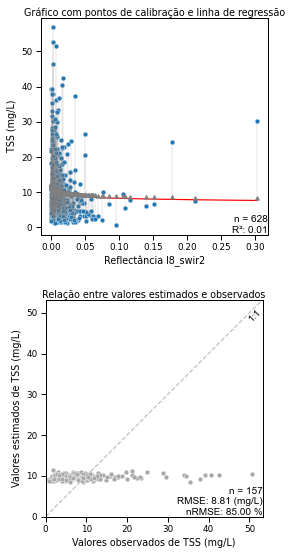


#-----------INFORMAÇÕES DA REGRESSÃO UNIVARIADA---------------#


#-------------------DADOS DE CALIBRAÇÃO-----------------------#

n: 628
R²: 0.0044
Squared-Pearson: 0.0013
R² Sklearn (RSS/TSS): 0.0044
Coeficiente(s): [10.49008445 -5.78930926]

#-------------------DADOS DE VALIDAÇÃO-----------------------#

n: 157.0000
RMSE: 8.81 (mg/L)
nRMSE: 85.00 %


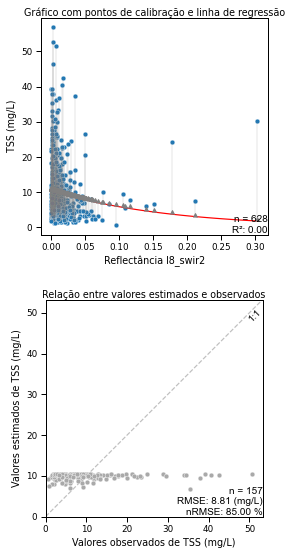

In [469]:
for x in X:
    X_train_temp = X_train.loc[:, x]
    X_test_temp = X_test.loc[:, x]
    print("#-------------", x, "---------------#")
    model_exec('linear', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('polynomial', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('log', X_train_temp, y_train, X_test_temp, y_test)
    model_exec('exp', X_train_temp, y_train, X_test_temp, y_test)

- Em geral os modelos não se ajustaram bem aos dados de forma univariada, sugerindo assim a necessidade de utilização de modelos mais robustos como modelos não lineares e multivariados

## 6.2 REGRESSÕES MULTIVARIADAS (1 VARIÁVEL DEPENDENTE X 6 VARIÁVEIS INDEPENDENTES)

### method

In [13]:
def r2(y_obs, y_pred):
    
    y_obs = np.array(y_obs)
    y_pred = np.array(y_pred)
    y_hat = (1/len(y_obs))*sum(y_obs)
    TSS = sum((y_obs-y_hat)**2)
    RSS = sum((y_obs - y_pred)**2)
    r2 = round(1 - RSS/TSS,2)
    return r2

def adj_r2(estimator, X, y_true):
    n, p = X.shape
    pred = estimator.predict(X)
    adj_r2 = round(1 - ((1 - r2(y_true, pred)) * (n - 1))/(n-p-1), 2)
    return adj_r2

def mae(y_obs, y_pred):
    mae = round((np.sum(abs(y_obs - y_pred))/len(y_pred)), 2)
    return mae

def mape(y_obs, y_pred):
    mape = round((np.sum(abs((y_obs - y_pred)/y_obs))/len(y_pred)), 2)
    return mape*100

def rmse(y_obs, y_pred):
    rmse = round((sum((np.subtract(y_obs, y_pred))**2)/len(y_obs))**0.5,2)
    return rmse

def nrmse(y_obs, y_pred):
    rmse = (sum((np.subtract(y_obs, y_pred))**2)/len(y_obs))**0.5
    nrmse = round(rmse/mean(y_obs),2)
    return nrmse*100

In [14]:
class Model():
    
    
    def __init__(self, X, y, gv=True, model=RandomForestRegressor(), wqp_unit={}):
        if X.shape[1] == 1:
            self.X = np.array(X).reshape(-1,1)
            self.y = y
            self.model = model
            self.wqp_unit = wqp_unit
        else:
            self.model = model
            self.X = X
            self.y = y
            self.wqp_unit = wqp_unit
      
    
    def boxplot_score(self, df, scores, palette):
        cm = 1/2.54
        sns.set_context('paper')
        fig, axs = plt.subplots(ncols = 2, nrows=3, figsize=(30*cm, 30*cm))
        row, col = 0, 0
        for letter, score in zip(['a', 'b', 'c', 'd', 'e', 'f'], scores):
            e = sns.boxplot(ax = axs[row, col], data=df.melt(value_vars=["train_"+score, "train_"+score+"_dummy", "test_"+score, "test_"+score+"_dummy"], value_name='score'), y='score', x='variable', palette=palette)
            e.set_xticklabels(['Train' + '\nn={:.0f}'.format(df["train_"+score].shape[0]) \
                               + '\nMedia: {:.2f}'.format(np.mean(df["train_"+score])) \
                               +'\nDesv. P.: {:.2f}'.format(np.std(df["train_"+score])),
                               'Train Dummy' + '\nn={:.0f}'.format(df["train_"+score].shape[0]) \
                               + '\nMedia: {:.2f}'.format(np.mean(df["train_"+score+"_dummy"])) \
                               +'\nDesv. P.: {:.2f}'.format(np.std(df["train_"+score+"_dummy"])),                                                     
                               'Test' + '\nn={:.0f}'.format(df["test_"+score].shape[0]) \
                               +'\nMedia: {:.2f}'.format(np.mean(df["test_"+score])) \
                               +'\nDesv. P.: {:.2f}'.format(np.std(df["test_"+score])),
                               'Test Dummy' + '\nn={:.0f}'.format(df["test_"+score].shape[0]) \
                               + '\nMedia: {:.2f}'.format(np.mean(df["test_"+score+"_dummy"])) \
                               +'\nDesv. P.: {:.2f}'.format(np.std(df["test_"+score+"_dummy"]))])
            if score.endswith("R²") or score.endswith("(%)"):
                e.set_ylabel(score)
            else:
                e.set_ylabel(score + " (" + self.wqp_unit + ")")
            
            e.set_xlabel('')
            e.spines['right'].set_visible(False)
            e.spines['left'].set_visible(True)
            e.spines['top'].set_visible(False)
            e.spines['bottom'].set_visible(True)
            e.yaxis.grid(color='gray', linestyle='dashed')
            e.yaxis.grid(color='gray', linestyle='dashed')
            e.set_title(letter)
            
            col +=1
    
            if col == 2:
                col = 0
                row+=1
                
        plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.3, 
                    hspace=0.4)
        
        return plt.show()
    
    
    def validation_plots(self, residuals, estimator, X, y_pred, y_obs):  
               
    
        def res_hist_plot(self, residuals):
            array = residuals
            cm = 1/2.54
            #fig, ax = plt.subplots(figsize=(10*cm ,10*cm))
            g = sns.histplot(ax = axs[0,0], x=array)
            g.set_xlabel('Resíduos')
            g.set_ylabel('Frequência')
            g.set_title('a')
            #plt.show()
            return g
            
        def res_lineplot(self, residuals):
            cm = 1/2.54
            #fig, ax = plt.subplots(figsize=(10*cm ,10*cm))
            g=sns.scatterplot(x = residuals.index, y = residuals, color='b', marker='.', ax = axs[0,1])
            g.axhline(y=0, c= 'red', linestyle='--')
            g.spines['right'].set_visible(False)
            g.spines['left'].set_visible(True)
            g.spines['top'].set_visible(False)
            g.spines['bottom'].set_visible(True)
            g.yaxis.grid(color='gray', linestyle='dashed')
            g.set_ylabel('∆ '+ g.get_ylabel())
            g.set_xlabel('Índice')
            g.set_title('b')
            g.set_xlim(g.get_xticks()[0]-0.5, g.get_xticks()[-1]+0.5)
            g.set_ylim(g.get_yticks()[0], g.get_yticks()[0] *-1)
            #plt.show()
            return g
    
            
            
        def res_qq_plot(self, residuals):
            
            array = residuals
            array_norm = (array - array.mean()) / array.std()
            array_norm=array_norm.sort_values(ascending=True)
            norm_dist = np.random.normal(loc=0, scale=1, size=len(array_norm))
            norm_dist.sort()
            cm = 1/2.54
            #fig, ax = plt.subplots(figsize=(10*cm, 10*cm))
            ax = sns.scatterplot(x = norm_dist, y = array_norm, marker='.', color='b', ax = axs[1,0])
            #h = sns.lineplot(ax=ax, x = norm_dist, y = norm_dist, color='r')
            ax.plot(norm_dist, norm_dist, c='red')
            lims = [norm_dist.min(), norm_dist.max()]
            ax.set_xlim(lims)
            ax.set_ylim(lims)
            ax.set_xlabel("Quantis da Distribuição Normal")
            ax.set_ylabel("Quantis Observados")
            ax.set_aspect('equal')
            ax.set_title('c')
            #plt.show()
            return ax
            
        def pred_obs_scatter(self, estimator, X, y_pred, y_obs):
            val_adj_r2 = adj_r2(estimator, X, y_obs)
            val_r2 = r2(y_obs, y_pred)
            val_mae = mae(y_obs, y_pred)
            val_mape = mape(y_obs, y_pred)
            val_rmse = rmse(y_obs, y_pred)
            val_nrmse = nrmse(y_obs, y_pred)
            #wqp_units = y_obs.name.split(" ")[-1].replace("(", "").replace(")", "") #change if necessary
            cm = 1/2.54
            #fig, ax = plt.subplots(figsize=(10*cm, 10*cm))
            h = sns.scatterplot(x = y_obs, y=y_pred, color='darkgrey', ax = axs[1,1])      
            h.spines['right'].set_visible(True)
            h.spines['left'].set_visible(True)
            h.spines['top'].set_visible(True)
            h.spines['bottom'].set_visible(True)
            h.set_ylabel('Valores estimados de '+ h.get_xlabel())
            h.set_xlabel('Valores observados de '+ h.get_xlabel())
            h.set_title('Correlação entre valores estimados e observados')
            lims = [
                np.min([h.get_xlim(), h.get_ylim()]),  # min of both axes
                np.max([h.get_xlim(), h.get_ylim()]),  # max of both axes
            ]
            if lims[0]<0:
                lims[0]=0
            else:
                pass
            # now plot both limits against eachother
            h.plot(lims, lims, '--', alpha=0.5, zorder=0, color='gray')
            h.text(0.93, 0.9,'1:1', fontdict={'family': 'arial', 'color':  'black', 'weight': 'light', 'size': 10, 'rotation': '45'}, transform=h.transAxes)
            h.set_title('d')
            h.set_xticks(h.get_yticks())
            h.set_xlim(lims)
            h.set_ylim(lims)
            h.set_aspect('equal')
            h.text(0.02,
                   0.98,
                   "n = {} | R²: {:.2f} | AdjR²: {:.2f}".format(y_obs.shape[0], val_r2, val_adj_r2),
                   fontdict={'ha': 'left', 'va': 'top', 'family': 'arial', 'color':  'black', 'weight': 'light', 'size': 10, 'rotation': '0'},
                   transform=h.transAxes)
            
            h.text(0.99,
                   0.01,
                   "MAE: " + "{:.1f} {} |".format(val_mae, self.wqp_unit) \
                   + " MAPE: " + "{:.0f} %".format(val_mape) \
                   + "\nRMSE: " + "{:.1f} {} |".format(val_rmse, self.wqp_unit) \
                   + " nRMSE: " + "{:.0f} %".format(val_nrmse),
                   fontdict={'ha': 'right', 'va': 'bottom', 'family': 'arial', 'color':  'black', 'weight': 'light', 'size': 10, 'rotation': '0'},
                   transform=h.transAxes)
            return h
        
        cm = 1/2.54
        fig, axs = plt.subplots(nrows= 2, ncols=2, figsize=(30*cm, 30*cm))
        res_hist_plot(self, residuals)
        res_lineplot(self, residuals)
        res_qq_plot(self, residuals)
        pred_obs_scatter(self, estimator, X, y_pred, y_obs)
        
        plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.2, 
                    hspace=0.2)
        
        return plt.show()
            
    def train_test_split_data(self):
        dict_random_state = {}
        for i in range(0, len(self.X)):
            X_train, X_test, y_train, y_test = train_test_split(self.X, self.y, test_size = 0.2, random_state=i)
            dict_random_state[i] = np.sum(abs(y_test - mean(y_test)))/len(y_test)
        
        final_i = max(dict_random_state)
        
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X, self.y, test_size = 0.2, random_state=final_i)
        
        del final_i, i, dict_random_state
        
        #return X_train, X_test, y_train, y_test              
        
    
    def grid_search(self, param_grid, scoring, refit, n_cv=5, r_t_c=True):
        '''
        Parameters
        ----------
        param_grid: dict
            Dictionary with model paramertes to be iterated
        scoring: dict
            All scoring methods to be used in model
        n_cv: int
            Number of Kfold in cross validation method
        refit: str
            Scoring method to return the best model
        r_t_c: bool
            Return train score
        '''
        print("\n#--------------INICIANDO O GRID SEARCH CV------------#")      
        self.scoring = scoring
        clf = GridSearchCV(self.model, 
                           param_grid = param_grid, 
                           scoring = self.scoring, 
                           cv = n_cv, 
                           refit = refit, 
                           return_train_score=r_t_c, 
                           verbose=0)
        clf.fit(self.X_train, self.y_train)
        temp_df=pd.DataFrame(clf.cv_results_, columns = sorted(clf.cv_results_.keys()))
        col = 'rank_test_' + refit
        self.params = temp_df.loc[temp_df[col].idxmin(), 'params']
        print("\nO GridSearchCV encontrou os melhores hiperparâmetros \
        para o modelo escolhido ({}), sendo eles: {}".format(self.model, self.params))
        del temp_df, clf
        print("\n#-----------FIM DO GRID SEARCH CV--------------#")
              
    def cv_model_results(self, n_cv=5, n_repeats=3):
        print("\n#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#")
        self.n_cv = n_cv
        self.n_repeats = n_repeats
        cv = RepeatedKFold(n_splits=n_cv, n_repeats=n_repeats)
        self.cv_results = cross_validate(self.model.set_params(**self.params), self.X_train, self.y_train, cv=cv,
                               scoring = self.scoring,
                               return_train_score = True,
                               verbose = 0,
                               return_estimator = True)
        dummy = DummyRegressor(strategy="mean")
        result_dummy = cross_validate(dummy,
                                      self.X_train,
                                      self.y_train,
                                      return_train_score = True,
                                      cv=cv,
                                      scoring=scoring,
                                      return_estimator = True)
        dummy_df = pd.DataFrame(result_dummy)
        dummy_df.columns = [i + "_dummy" for i in list(dummy_df.columns)]
        temp_df=pd.DataFrame(self.cv_results)
        temp_df = pd.concat([temp_df, dummy_df], axis=1)       
        


        ## arrumandos os valores negativos no dataframe
        for i in self.scoring.keys():
            if i == "R²" or i == "R2" or i == "r2" or i == "R_2" or i == "r_2" or i == "r2_score" or i =="Adjusted R²":
                pass
            else:
                temp_df.loc[:, "train_"+i] = temp_df.loc[:, "train_"+i] * -1
                temp_df.loc[:, "test_"+i] = temp_df.loc[:, "test_"+i] * -1
                temp_df.loc[:, "train_"+i+"_dummy"] = temp_df.loc[:, "train_"+i+"_dummy"] * -1
                temp_df.loc[:, "test_"+i+"_dummy"] = temp_df.loc[:, "test_"+i+"_dummy"] * -1
                
        print("\n#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#")                
        a = self.boxplot_score(df = temp_df, scores = self.scoring.keys(), palette=['#A84269', '#4A97A8'])
        
        return temp_df
        print("\n#-----------FIM DO CROSS VALIDATION--------------#")
    
    def model_left_out(self):
        print("\n#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#")
        best_model = self.model.set_params(**self.params)
        
        best_model.fit(self.X_train, self.y_train)
        
        y_pred = best_model.predict(self.X_test)
        
        self.y_pred = y_pred
        
        residuals = self.y_test - y_pred
        print("\n#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#")               
        self.validation_plots(residuals, best_model, self.X_test, y_pred, self.y_test)
        
        output = {}
        
        output['model'] = str(best_model).split("(")[0]
        output['params'] = str(self.params)
        output['train/validation']="{}/{}".format(str(self.X_train.shape[0]), str(self.X_test.shape[0]))
        output['KFoldRepeat']= "{}x{}".format(self.n_cv, self.n_repeats) 
        for idx, i in enumerate(self.scoring.keys()):
            if idx == 0:
                output['mean_train_'+i] = round(np.mean(self.cv_results["train_"+i]),2)
                output['mean_test_'+i] = round(np.mean(self.cv_results["test_"+i]),2)
                output['validation_'+i] = round(r2(self.y_test, y_pred),2)
                
            elif idx == 1:
                output['mean_train_'+i] = round(np.mean(self.cv_results["train_"+i]),2)
                output['mean_test_'+i] = round(np.mean(self.cv_results["test_"+i]),2)
                output['validation_'+i] = round(adj_r2(best_model, self.X_test, self.y_test),2)
                
            else:
                output['mean_train_'+i] = round(np.mean(self.cv_results["train_"+i]*-1),2)
                output['mean_test_'+i] = round(np.mean(self.cv_results["test_"+i]*-1),2)
                if i.startswith('MAE'):
                    output['validation_'+i] = round(mae(self.y_test, y_pred),2)
                elif i.startswith('MAPE'):
                    output['validation_'+i] = round(mape(self.y_test, y_pred),2)
                elif i.startswith('RMSE'):
                    output['validation_'+i] = round(rmse(self.y_test, y_pred),2)
                elif i.startswith('NRMSE'):
                    output['validation_'+i] = round(nrmse(self.y_test, y_pred),2)
        return output
 

### 6.2.1 Variável dependente: Turbidez

#### 6.2.1.1 Separação de X e Y

In [174]:
df_enh.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 648 entries, 641 to 985
Data columns (total 35 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   img_id                          648 non-null    object        
 1   satellite                       648 non-null    object        
 2   Site                            648 non-null    object        
 3   Latitude (decimal deg)          648 non-null    float64       
 4   Longitude (decimal deg)         648 non-null    float64       
 5   date                            648 non-null    datetime64[ns]
 6   timestamp                       648 non-null    datetime64[ns]
 7   l8_blue                         648 non-null    float64       
 8   l8_green                        648 non-null    float64       
 9   l8_red                          648 non-null    float64       
 10  l8_nir                          648 non-null    float64       
 11  l8_s

In [188]:
X_cols = list(df_enh.columns[7:12]) + list(df_enh.columns[30:])
y_col = 'Turbidity (NTU)'


scaler = StandardScaler()


X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

#X = X

#scoring
r2_score_t = make_scorer(r2, greater_is_better=True)
#adj_r2_score_t = make_scorer(adj_r2, greater_is_better=True)
rmse_score = make_scorer(rmse, greater_is_better=False)
nrmse_score = make_scorer(nrmse, greater_is_better=False)
mae_score = make_scorer(mae, greater_is_better=False)
mape_score = make_scorer(mape, greater_is_better=False)
scoring = {'R²': r2_score_t, 
           'Adjusted R²': adj_r2, 
           'MAE': mae_score, 
           'MAPE (%)': mape_score, 
           'RMSE': rmse_score, 
           'NRMSE (%)': nrmse_score}

#### 6.2.1.2 Regressão linear múltipla

- Recomendado utilizar o X escalonado


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (LinearRegression()), sendo eles: {'positive': False}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


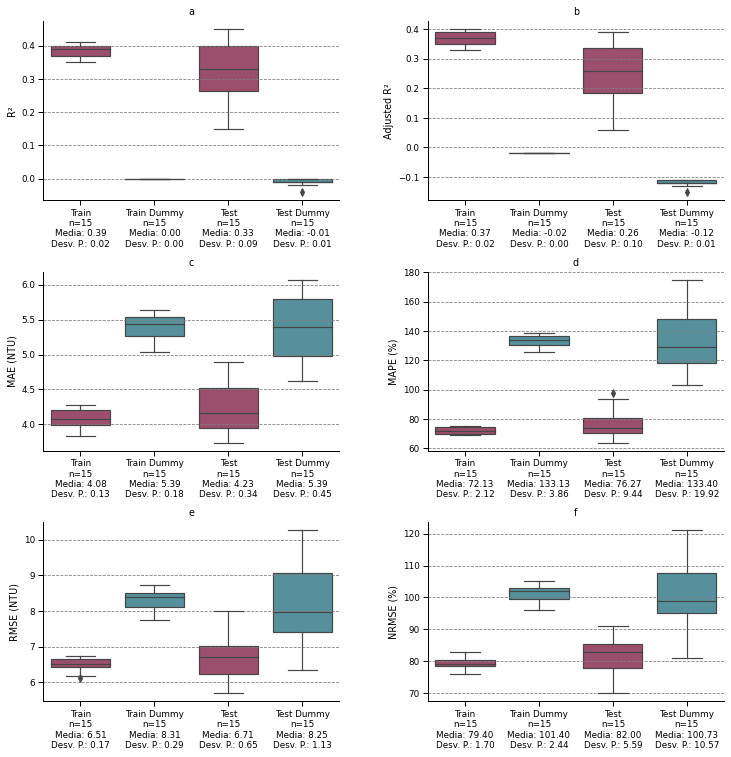


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


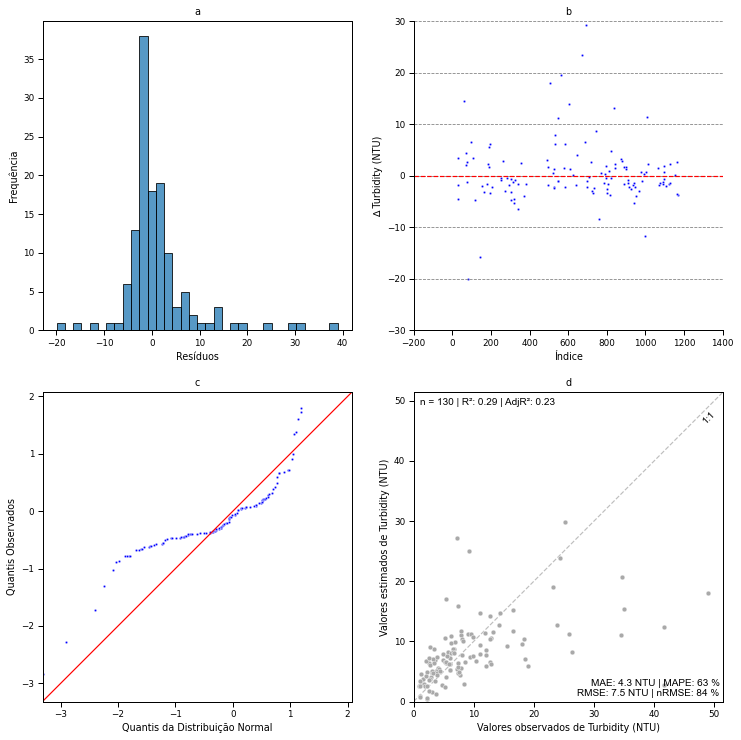

In [189]:
model_ = Model(X_scaled, y, model = LinearRegression(), wqp_unit='NTU')

model_.train_test_split_data()

#param_grid
param_grid={'positive': [False, True]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lr_result=model_.model_left_out()

#### 6.2.1.3 Lasso Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (Lasso()), sendo eles: {'alpha': 0.1}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


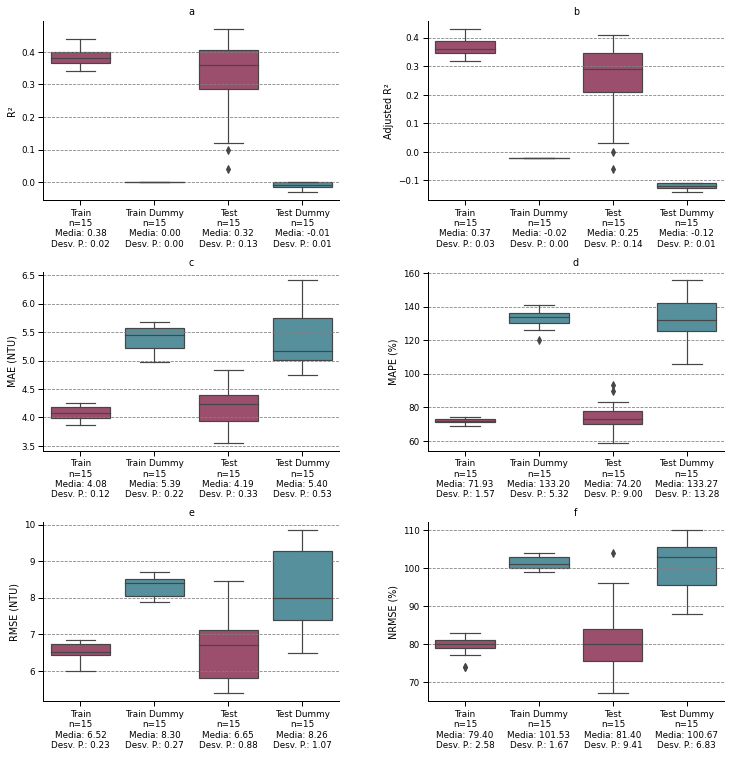


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


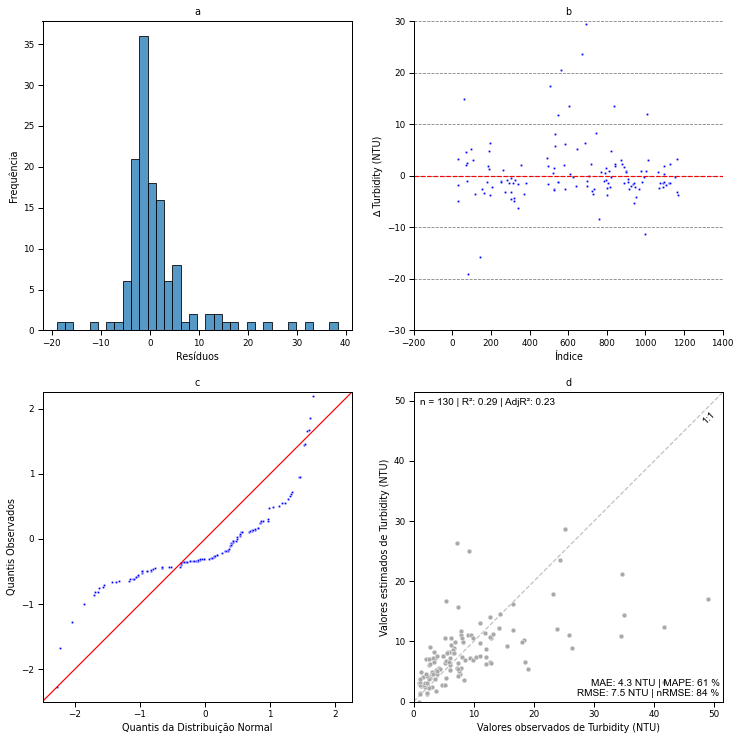

In [190]:
model_ = Model(X_scaled, y, model = Lasso(), wqp_unit='NTU')

model_.train_test_split_data()

#param_grid
param_grid={'alpha': [0.1, 0.5, 1, 10]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lasso_result=model_.model_left_out()

#### 6.2.1.4 SVM Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (SVR()), sendo eles: {'C': 1, 'epsilon': 2, 'gamma': 'scale', 'kernel': 'linear'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


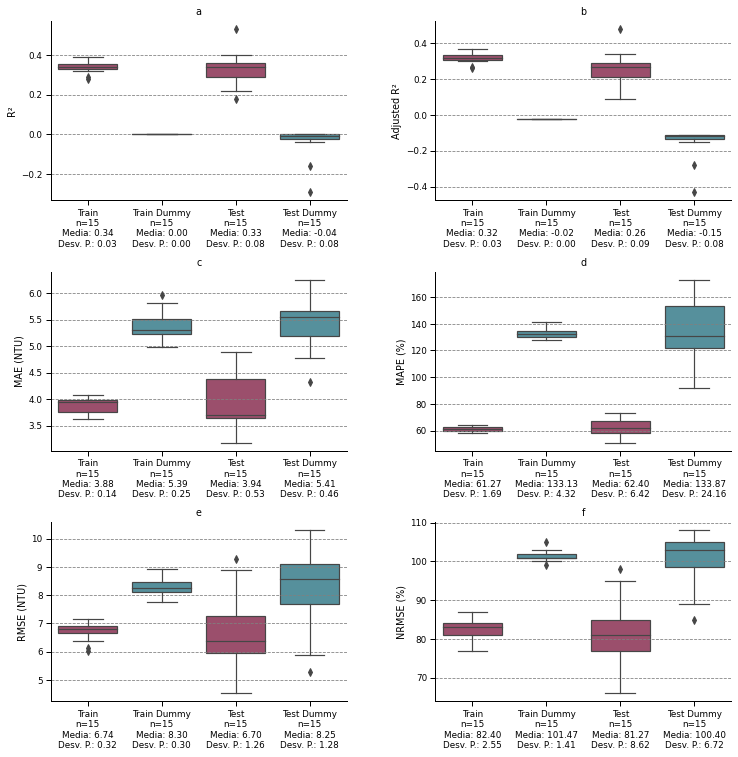


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


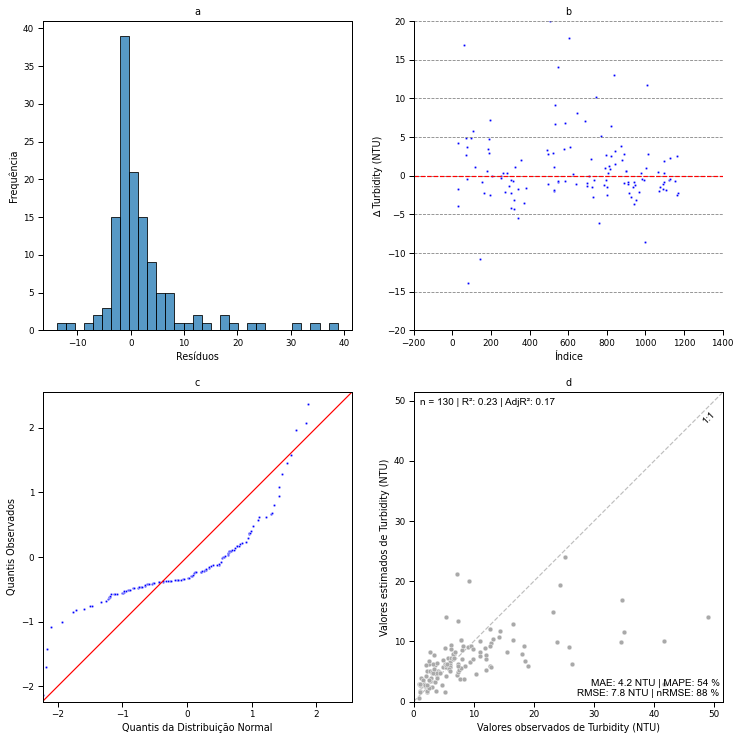

In [191]:
model_ = Model(X_scaled, y, model = SVR(), wqp_unit='NTU')

model_.train_test_split_data()

#param_grid
param_grid={'kernel': ['linear', 'poly', 'rbf', 'sigmoid'], 
            'C': [1, 100, 250, 500, 1000], 
            'epsilon': [0.01, 0.1, 1, 2, 5], 
            'gamma': ['scale', 'auto']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

svm_result=model_.model_left_out()

#### 6.2.1.5 Random Forest


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (RandomForestRegressor()), sendo eles: {'criterion': 'squared_error', 'max_depth': 50, 'n_estimators': 100}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


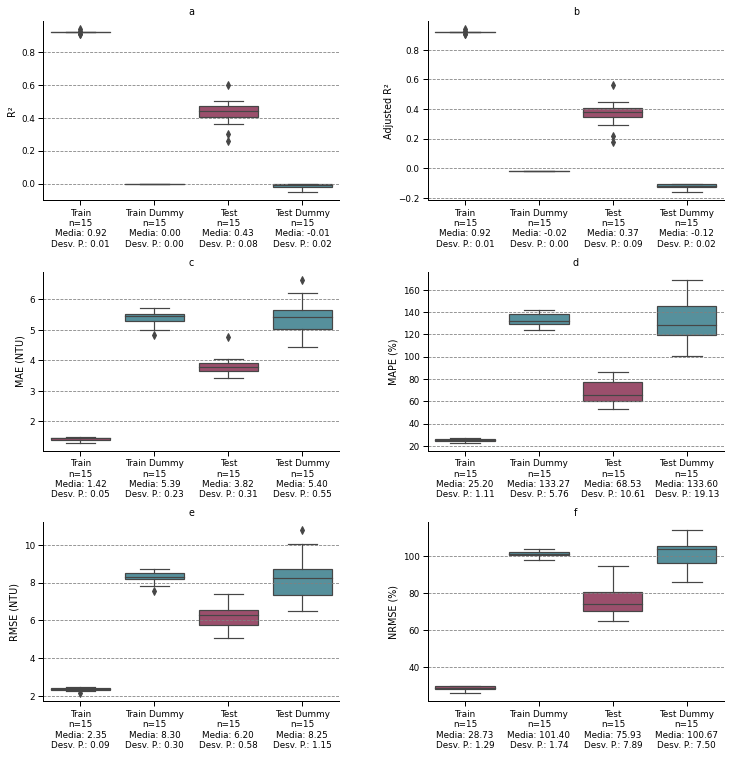


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


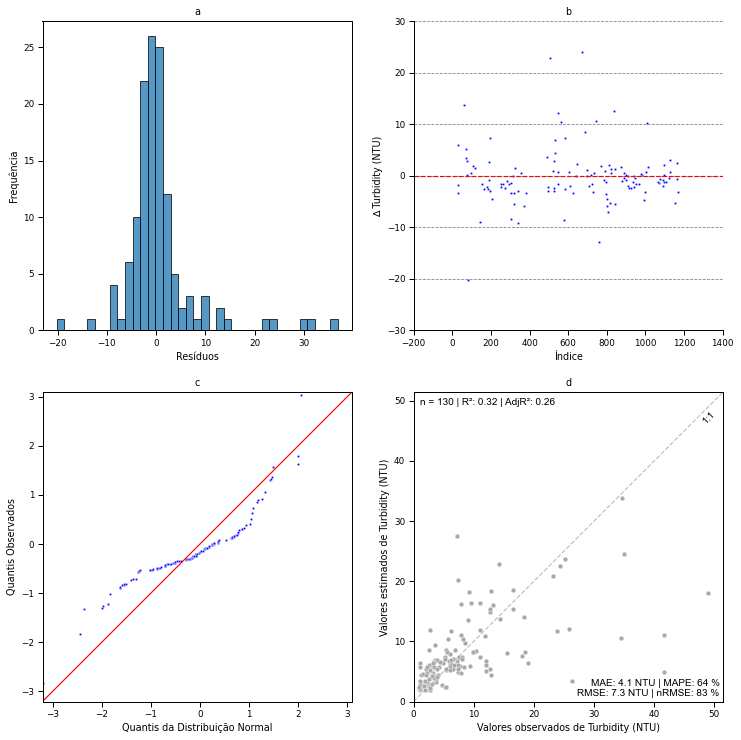

In [192]:
model_ = Model(X, y, model = RandomForestRegressor(), wqp_unit='NTU')

model_.train_test_split_data()

#param_grid

param_grid={'n_estimators': [10,30,50,70,100,200,500,1000],
            'criterion': ["squared_error"],
            'max_depth': [10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

rf_result=model_.model_left_out()

#### 6.2.1.6 XGBOOST


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, gamma=None,
             gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, predictor=None, random_state=None,
             reg_alpha=None, reg_lambda=None, ...)), sendo eles: {'max_depth': 10, 'n_estimators': 50}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO

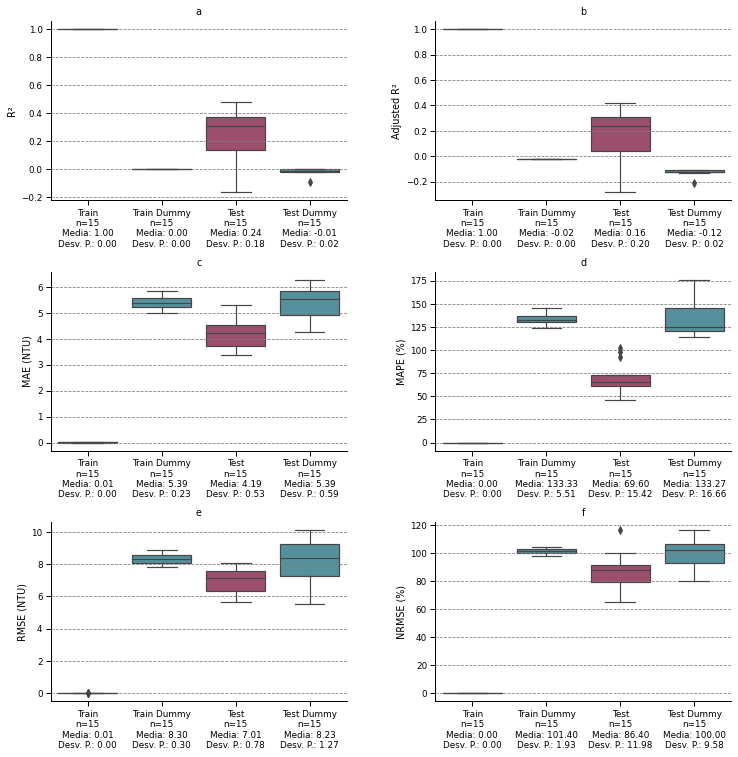


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


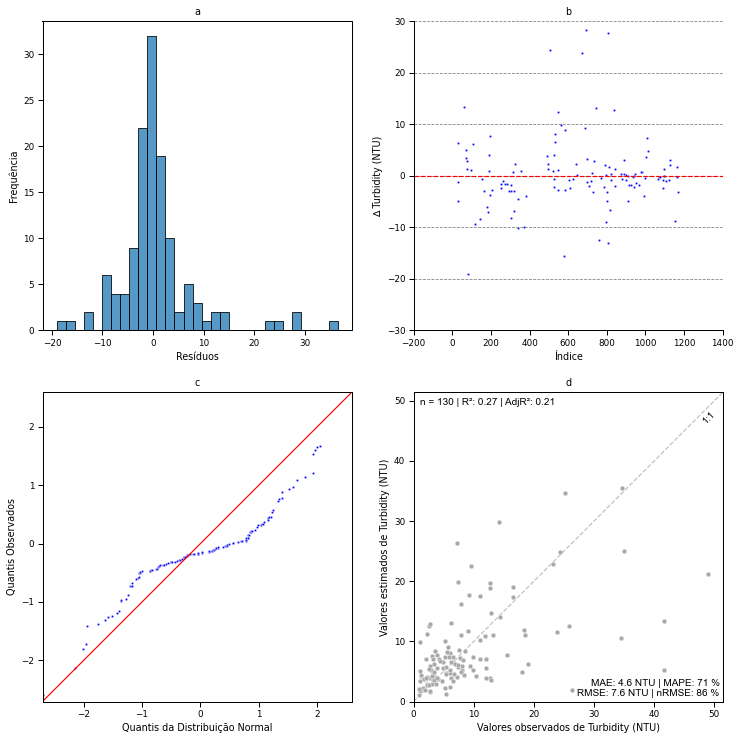

In [193]:
model_ = Model(X, y, model = XGBRegressor(), wqp_unit='NTU')

model_.train_test_split_data()

#param_grid
param_grid={'n_estimators': [10,30,50,70,100,200,500,1000], 
            'max_depth': [2, 5, 8, 10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

xgb_result=model_.model_left_out()

#### 6.2.1.7 MLP Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (MLPRegressor()), sendo eles: {'activation': 'tanh', 'hidden_layer_sizes': (6, 6), 'learning_rate': 'adaptive', 'max_iter': 100000, 'solver': 'sgd'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


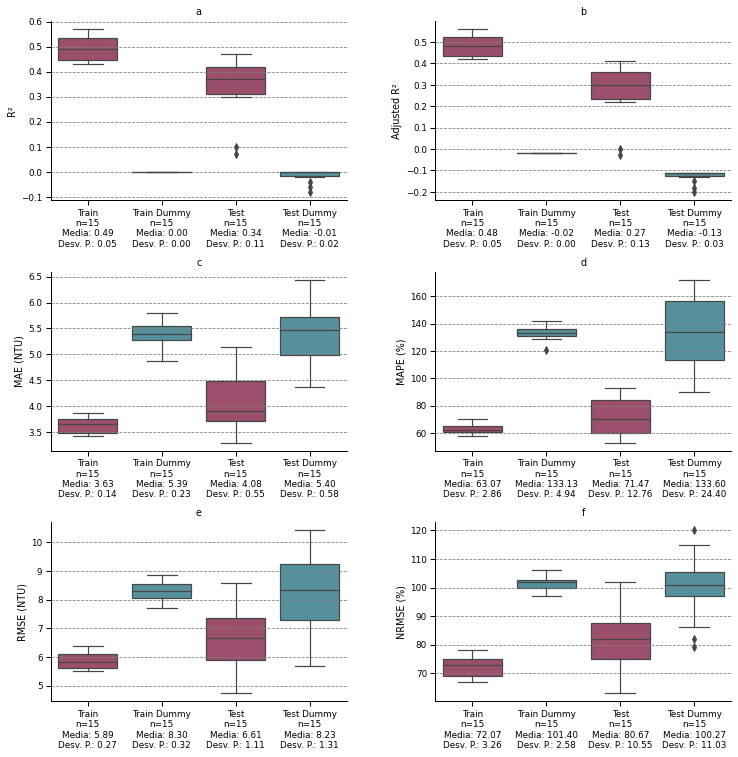


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


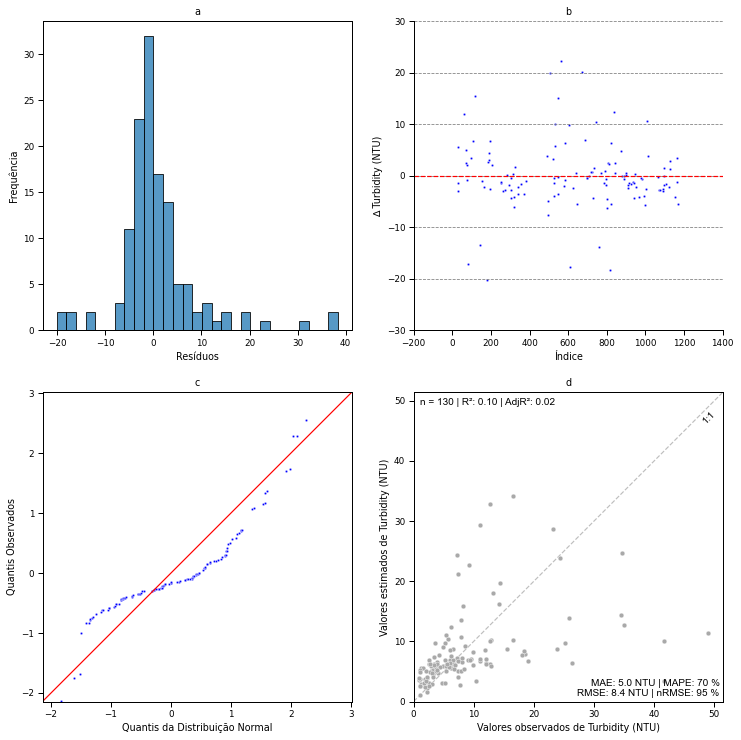

In [194]:
model_ = Model(X_scaled, y, model = MLPRegressor(), wqp_unit='NTU')

model_.train_test_split_data()

#param_grid
param_grid={'hidden_layer_sizes': [(6, ), (6, 6)], 
            'activation': ['tanh', 'relu'], 
            'solver': ['sgd'], 
            'max_iter': [100000], 
            'learning_rate': ['adaptive', 'invscaling']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

mlp_result=model_.model_left_out()

#### 6.2.1.8 Armazenando o resultado

In [195]:
turb_results = pd.DataFrame([lr_result, lasso_result, svm_result, rf_result, xgb_result, mlp_result])
turb_results.loc[:, 'index'] = 'Turbidity (NTU)'
turb_results.head()

,model,params,train/validation,KFoldRepeat,mean_train_R²,mean_test_R²,validation_R²,mean_train_Adjusted R²,mean_test_Adjusted R²,validation_Adjusted R²,...,mean_train_MAPE (%),mean_test_MAPE (%),validation_MAPE (%),mean_train_RMSE,mean_test_RMSE,validation_RMSE,mean_train_NRMSE (%),mean_test_NRMSE (%),validation_NRMSE (%),index
0,LinearRegression,{'positive': False},518/130,5x3,0.39,0.33,0.29,0.37,0.26,0.23,...,72.13,76.27,63.0,6.51,6.71,7.50,79.40,82.00,84.0,Turbidity (NTU)
1,Lasso,{'alpha': 0.1},518/130,5x3,0.38,0.32,0.29,0.37,0.25,0.23,...,71.93,74.20,61.0,6.52,6.65,7.49,79.40,81.40,84.0,Turbidity (NTU)
2,SVR,"{'C': 1, 'epsilon': 2, 'gamma': 'scale', 'kern...",518/130,5x3,0.34,0.33,0.23,0.32,0.26,0.17,...,61.27,62.40,54.0,6.74,6.70,7.79,82.40,81.27,88.0,Turbidity (NTU)
3,RandomForestRegressor,"{'criterion': 'squared_error', 'max_depth': 50...",518/130,5x3,0.92,0.43,0.32,0.92,0.37,0.26,...,25.20,68.53,64.0,2.35,6.20,7.35,28.73,75.93,83.0,Turbidity (NTU)
4,XGBRegressor,"{'max_depth': 10, 'n_estimators': 50}",518/130,5x3,1.00,0.24,0.27,1.00,0.16,0.21,...,0.00,69.60,71.0,0.01,7.01,7.59,0.00,86.40,86.0,Turbidity (NTU)


### 6.2.2 Variável dependente: Chla

#### 6.2.2.1 Separação de X e Y

In [196]:
df_enh.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 648 entries, 641 to 985
Data columns (total 35 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   img_id                          648 non-null    object        
 1   satellite                       648 non-null    object        
 2   Site                            648 non-null    object        
 3   Latitude (decimal deg)          648 non-null    float64       
 4   Longitude (decimal deg)         648 non-null    float64       
 5   date                            648 non-null    datetime64[ns]
 6   timestamp                       648 non-null    datetime64[ns]
 7   l8_blue                         648 non-null    float64       
 8   l8_green                        648 non-null    float64       
 9   l8_red                          648 non-null    float64       
 10  l8_nir                          648 non-null    float64       
 11  l8_s

In [197]:
X_cols = list(df_enh.columns[7:12]) + list(df_enh.columns[30:])
y_col = 'Chla (µg/L)'


scaler = StandardScaler()


X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

#X = X

#scoring
r2_score_t = make_scorer(r2, greater_is_better=True)
#adj_r2_score_t = make_scorer(adj_r2, greater_is_better=True)
rmse_score = make_scorer(rmse, greater_is_better=False)
nrmse_score = make_scorer(nrmse, greater_is_better=False)
mae_score = make_scorer(mae, greater_is_better=False)
mape_score = make_scorer(mape, greater_is_better=False)
scoring = {'R²': r2_score_t, 'Adjusted R²': adj_r2, 'MAE': mae_score, 'MAPE (%)': mape_score, 'RMSE': rmse_score, 'NRMSE (%)': nrmse_score}

#### 6.2.2.2 Regressão linear múltipla

- Recomendado utilizar o X escalonado


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (LinearRegression()), sendo eles: {'positive': False}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


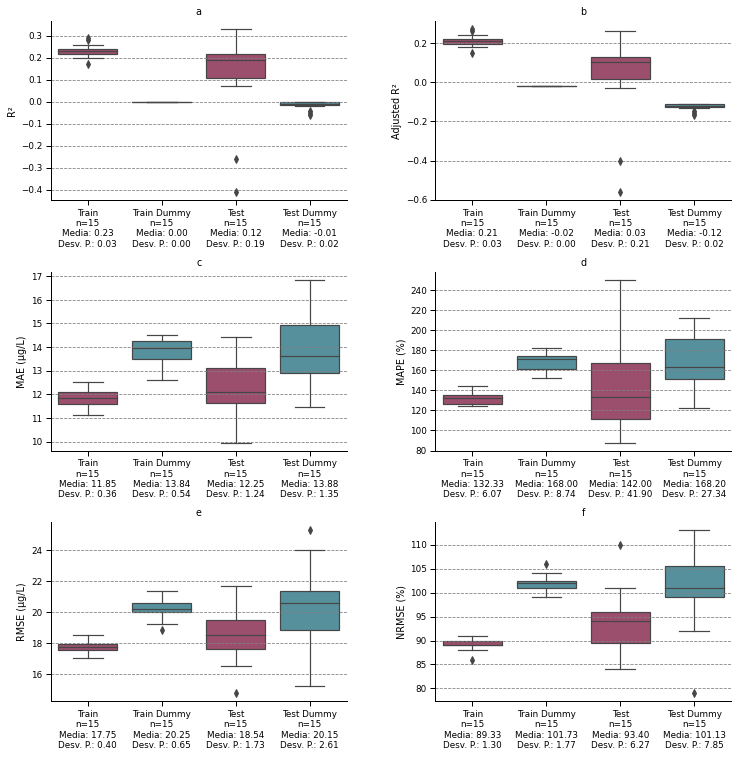


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


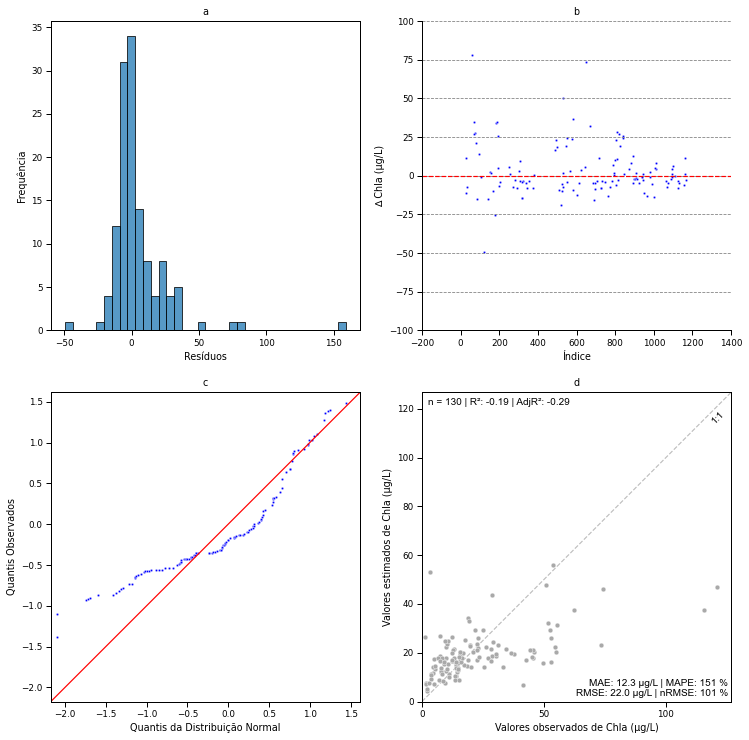

In [198]:
model_ = Model(X_scaled, y, model = LinearRegression(), wqp_unit='µg/L')

model_.train_test_split_data()

#param_grid
param_grid={'positive': [False, True]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lr_result=model_.model_left_out()

#### 6.2.2.3 Lasso Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (Lasso()), sendo eles: {'alpha': 0.5}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


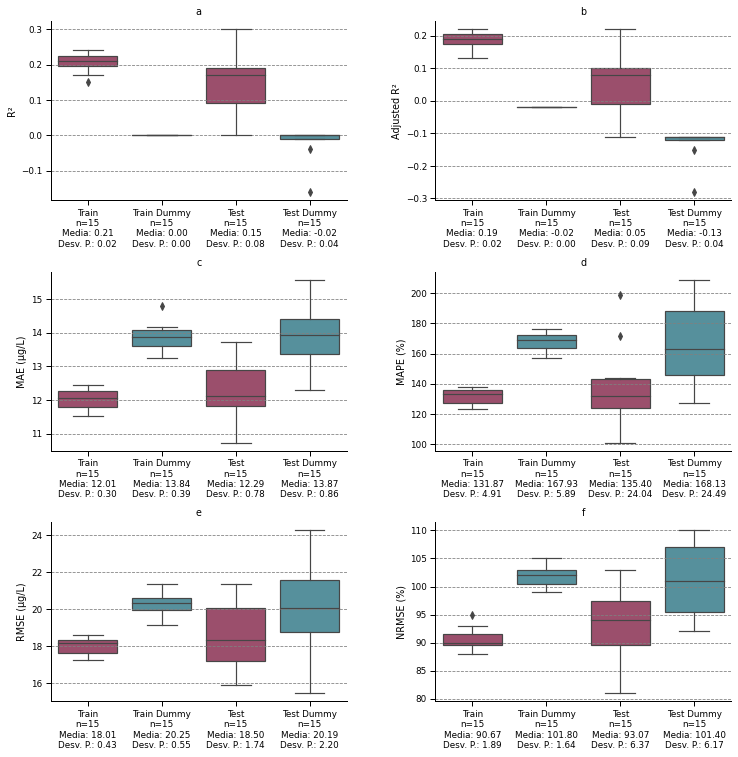


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


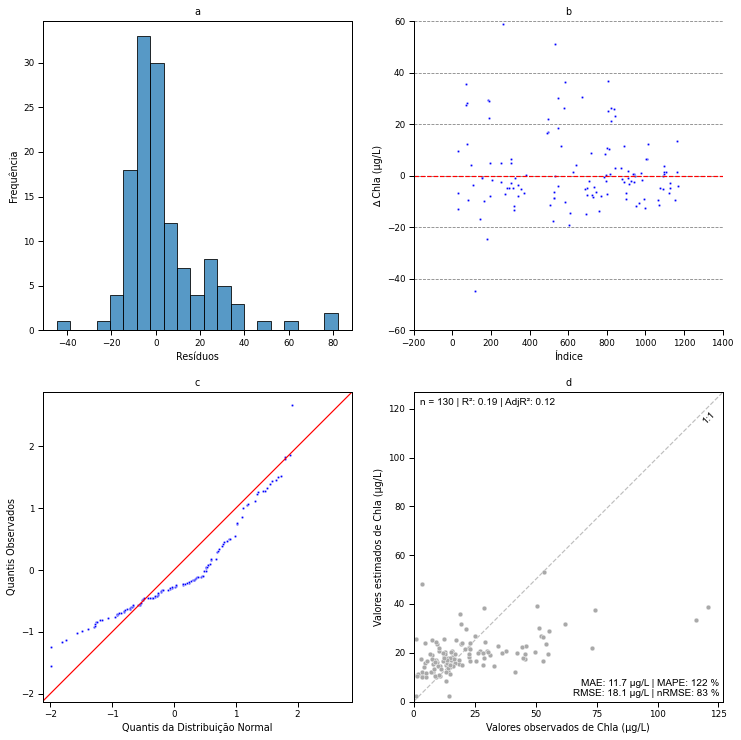

In [199]:
model_ = Model(X_scaled, y, model = Lasso(), wqp_unit='µg/L')

model_.train_test_split_data()

#param_grid
param_grid={'alpha': [0.1, 0.5, 1, 10]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lasso_result=model_.model_left_out()

#### 6.2.2.4 SVM Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (SVR()), sendo eles: {'C': 100, 'epsilon': 0.1, 'gamma': 'scale', 'kernel': 'rbf'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


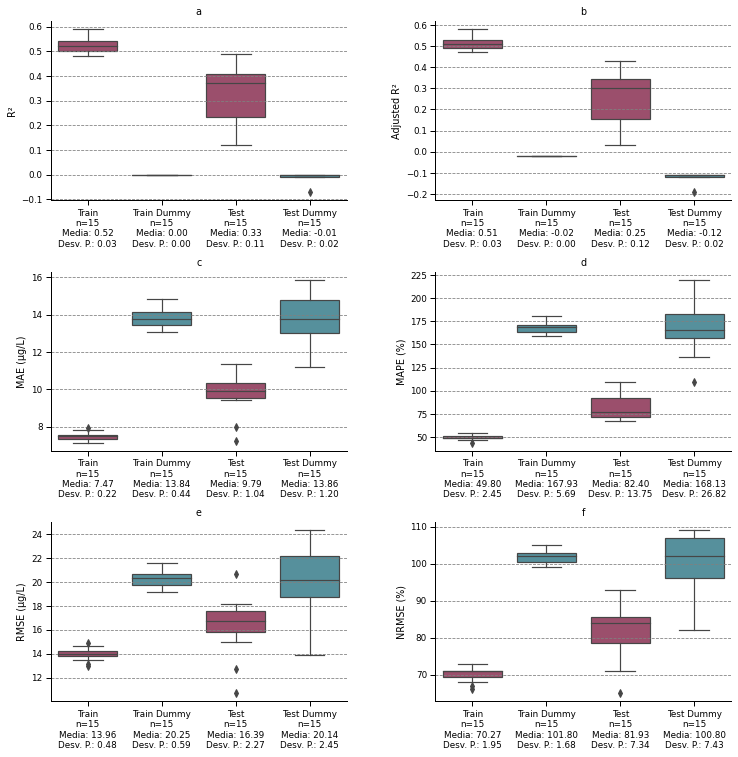


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


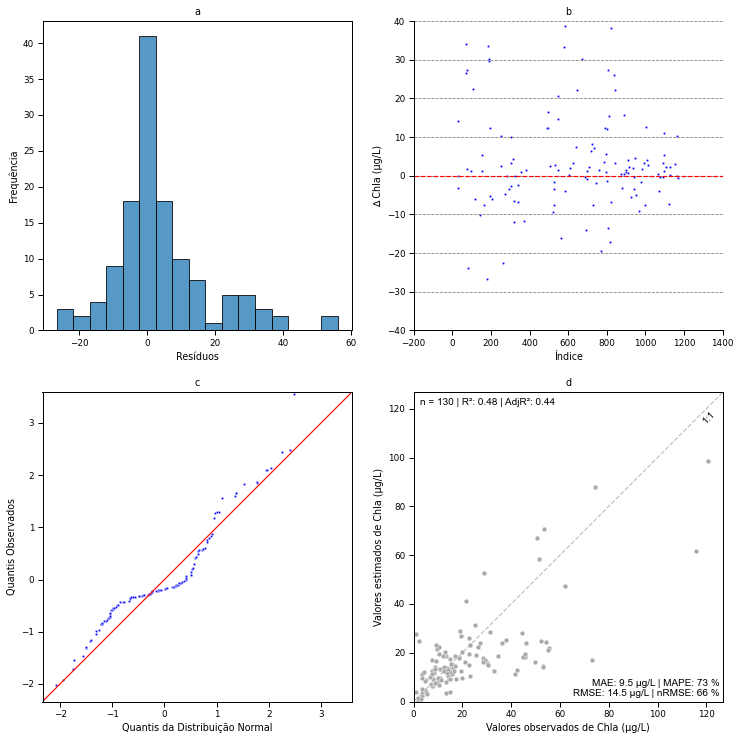

In [200]:
model_ = Model(X_scaled, y, model = SVR(), wqp_unit='µg/L')

model_.train_test_split_data()

#param_grid
param_grid={'kernel': ['linear', 'poly', 'rbf', 'sigmoid'], 'C': [1, 100, 250, 500, 1000], 'epsilon': [0.01, 0.1, 1, 2, 5], 'gamma': ['scale', 'auto']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

svm_result=model_.model_left_out()

#### 6.2.2.5 Random Forest


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (RandomForestRegressor()), sendo eles: {'criterion': 'squared_error', 'max_depth': 50, 'n_estimators': 30}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


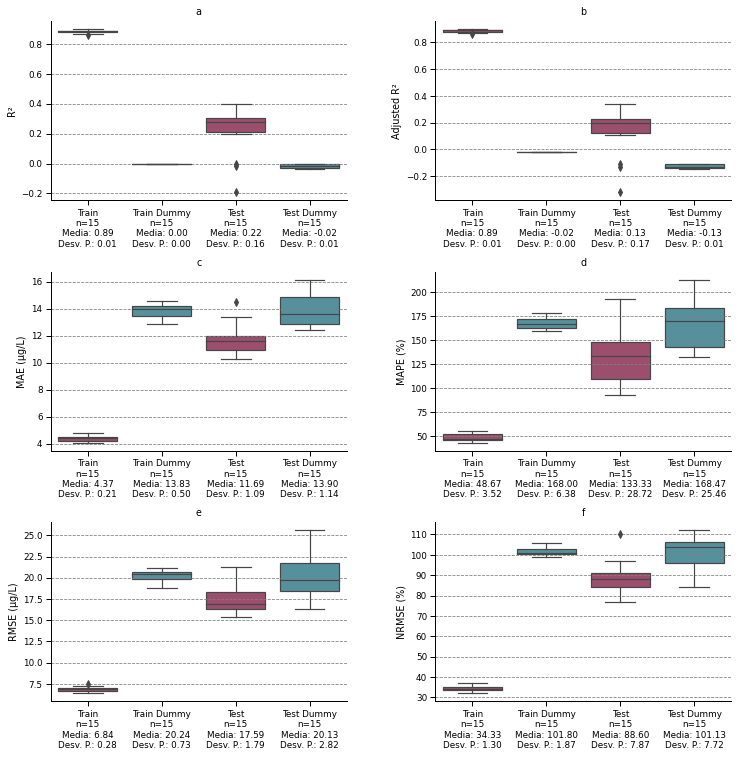


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


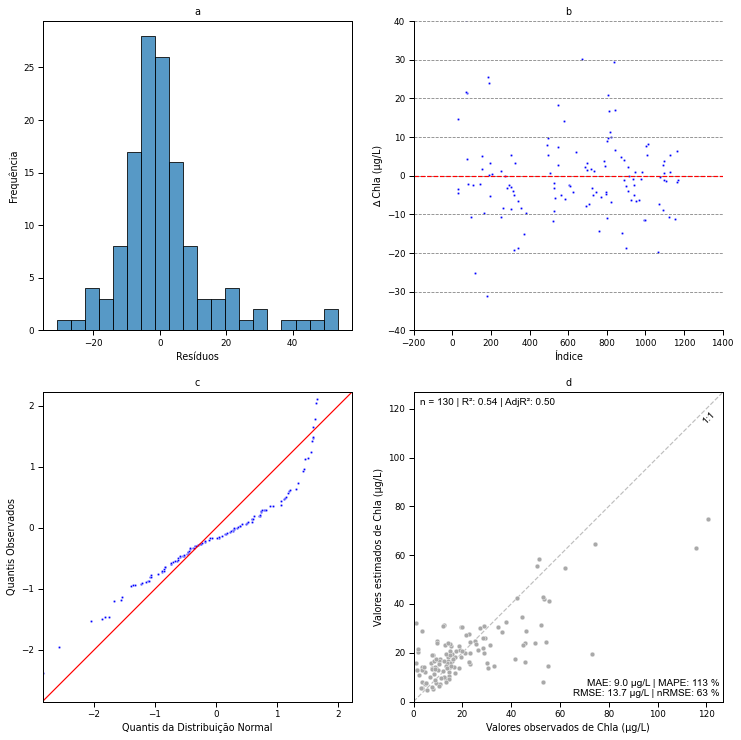

In [201]:
model_ = Model(X, y, model = RandomForestRegressor(), wqp_unit='µg/L')

model_.train_test_split_data()

#param_grid

param_grid={'n_estimators': [10,30,50,70,100,200,500,1000], 'criterion': ["squared_error"], 'max_depth': [10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

rf_result=model_.model_left_out()

#### 6.2.2.6 XGBOOST


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, gamma=None,
             gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, predictor=None, random_state=None,
             reg_alpha=None, reg_lambda=None, ...)), sendo eles: {'max_depth': 2, 'n_estimators': 30}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO 

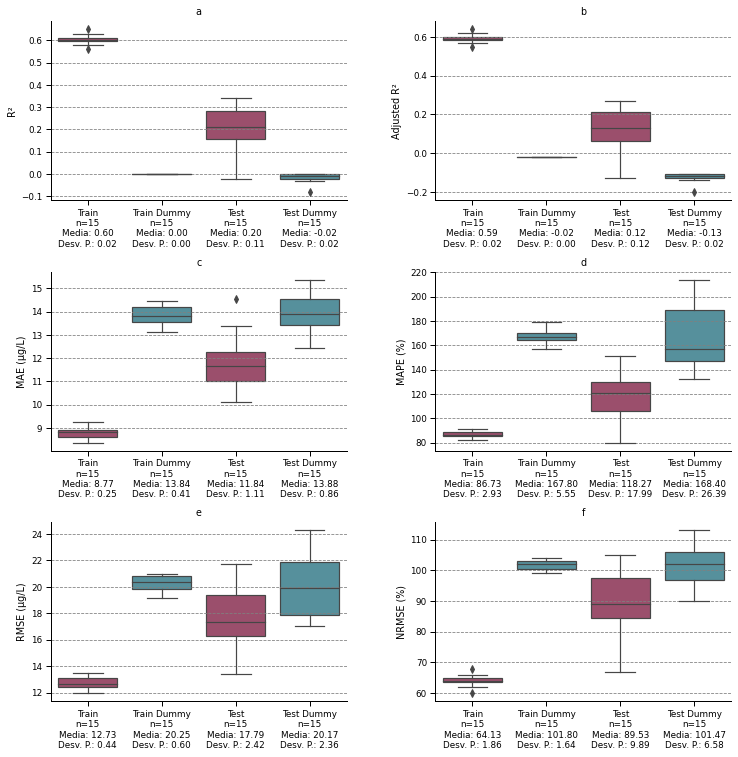


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


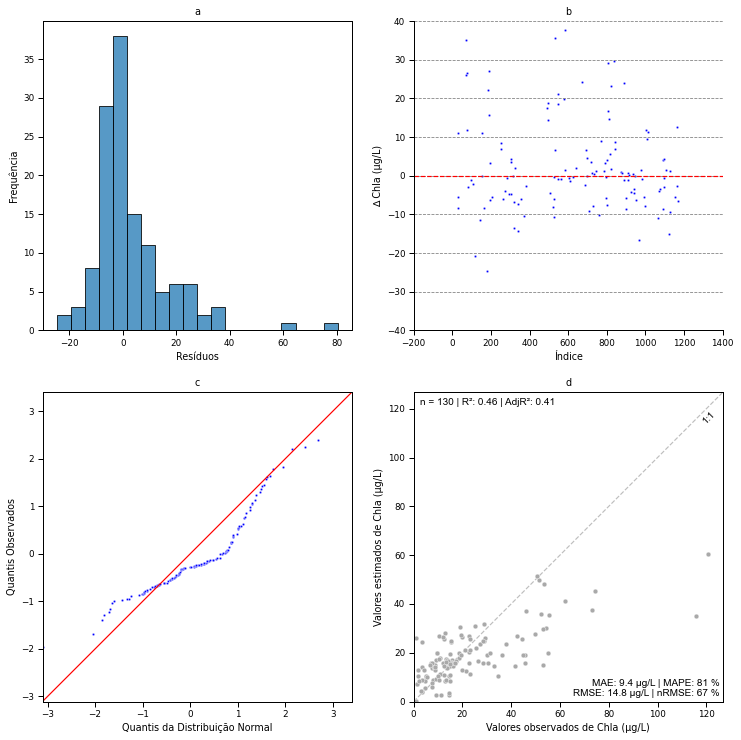

In [202]:
model_ = Model(X, y, model = XGBRegressor(), wqp_unit='µg/L')

model_.train_test_split_data()

#param_grid
param_grid={'n_estimators': [10,30,50,70,100,200,500,1000], 'max_depth': [2, 5, 8, 10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

xgb_result=model_.model_left_out()

#### 6.2.2.7 MLP Regressor


#--------------INICIANDO O GRID SEARCH CV------------#


C:\ProgramData\Anaconda3\envs\geo_env\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\ProgramData\Anaconda3\envs\geo_env\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\ProgramData\Anaconda3\envs\geo_env\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\ProgramData\Anaconda3\envs\geo_env\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Progr


O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (MLPRegressor()), sendo eles: {'activation': 'tanh', 'hidden_layer_sizes': (6,), 'learning_rate': 'adaptive', 'max_iter': 100000, 'solver': 'sgd'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


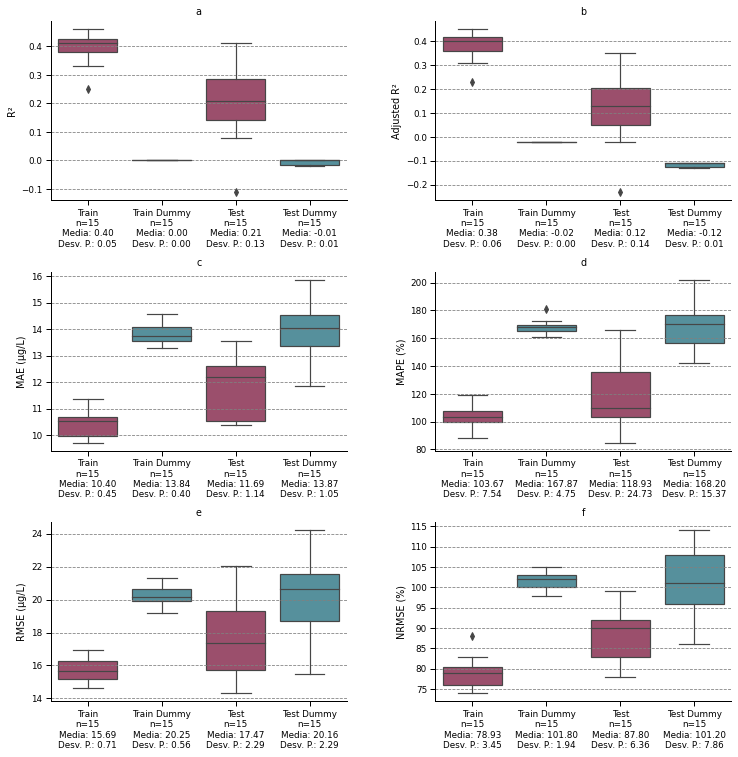


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


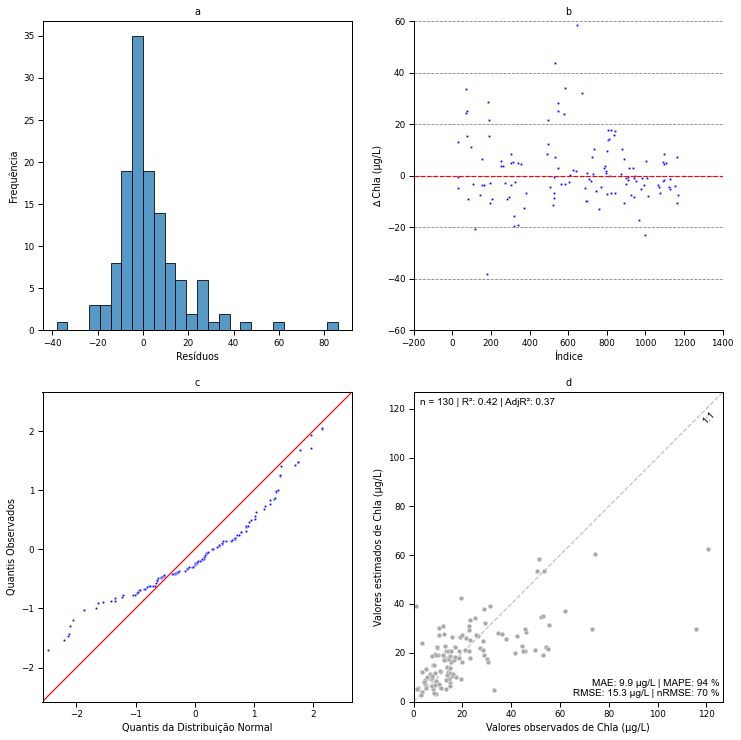

In [203]:
model_ = Model(X_scaled, y, model = MLPRegressor(), wqp_unit='µg/L')

model_.train_test_split_data()

#param_grid
param_grid={'hidden_layer_sizes': [(6, ), (6, 6)], 'activation': ['tanh', 'relu'], 'solver': ['sgd'], 'max_iter': [100000], 'learning_rate': ['adaptive', 'invscaling']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

mlp_result=model_.model_left_out()

#'max_iter': [100000]

#### 6.2.2.8 Armazenando o resultado

In [204]:
chla_results = pd.DataFrame([lr_result, lasso_result, svm_result, rf_result, xgb_result, mlp_result])
chla_results.loc[:, 'index'] = 'Chla (µg/L)'
chla_results.head()

,model,params,train/validation,KFoldRepeat,mean_train_R²,mean_test_R²,validation_R²,mean_train_Adjusted R²,mean_test_Adjusted R²,validation_Adjusted R²,...,mean_train_MAPE (%),mean_test_MAPE (%),validation_MAPE (%),mean_train_RMSE,mean_test_RMSE,validation_RMSE,mean_train_NRMSE (%),mean_test_NRMSE (%),validation_NRMSE (%),index
0,LinearRegression,{'positive': False},518/130,5x3,0.23,0.12,-0.19,0.21,0.03,-0.29,...,132.33,142.00,151.0,17.75,18.54,22.01,89.33,93.40,101.0,Chla (µg/L)
1,Lasso,{'alpha': 0.5},518/130,5x3,0.21,0.15,0.19,0.19,0.05,0.12,...,131.87,135.40,122.0,18.01,18.50,18.15,90.67,93.07,83.0,Chla (µg/L)
2,SVR,"{'C': 100, 'epsilon': 0.1, 'gamma': 'scale', '...",518/130,5x3,0.52,0.33,0.48,0.51,0.25,0.44,...,49.80,82.40,73.0,13.96,16.39,14.50,70.27,81.93,66.0,Chla (µg/L)
3,RandomForestRegressor,"{'criterion': 'squared_error', 'max_depth': 50...",518/130,5x3,0.89,0.22,0.54,0.89,0.13,0.50,...,48.67,133.33,113.0,6.84,17.59,13.68,34.33,88.60,63.0,Chla (µg/L)
4,XGBRegressor,"{'max_depth': 2, 'n_estimators': 30}",518/130,5x3,0.60,0.20,0.46,0.59,0.12,0.41,...,86.73,118.27,81.0,12.73,17.79,14.76,64.13,89.53,67.0,Chla (µg/L)


### 6.2.3 Variável dependente: CDOM

#### 6.2.3.1 Separação de X e Y

In [205]:
df_enh.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 648 entries, 641 to 985
Data columns (total 35 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   img_id                          648 non-null    object        
 1   satellite                       648 non-null    object        
 2   Site                            648 non-null    object        
 3   Latitude (decimal deg)          648 non-null    float64       
 4   Longitude (decimal deg)         648 non-null    float64       
 5   date                            648 non-null    datetime64[ns]
 6   timestamp                       648 non-null    datetime64[ns]
 7   l8_blue                         648 non-null    float64       
 8   l8_green                        648 non-null    float64       
 9   l8_red                          648 non-null    float64       
 10  l8_nir                          648 non-null    float64       
 11  l8_s

In [206]:
X_cols = list(df_enh.columns[7:12]) + list(df_enh.columns[30:])
y_col = 'CDOM 400 nm (m-1)'


scaler = StandardScaler()


X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

#X = X

#scoring
r2_score_t = make_scorer(r2, greater_is_better=True)
#adj_r2_score_t = make_scorer(adj_r2, greater_is_better=True)
rmse_score = make_scorer(rmse, greater_is_better=False)
nrmse_score = make_scorer(nrmse, greater_is_better=False)
mae_score = make_scorer(mae, greater_is_better=False)
mape_score = make_scorer(mape, greater_is_better=False)
scoring = {'R²': r2_score_t, 'Adjusted R²': adj_r2, 'MAE': mae_score, 'MAPE (%)': mape_score, 'RMSE': rmse_score, 'NRMSE (%)': nrmse_score}

#### 6.2.3.2 Regressão linear múltipla

- Recomendado utilizar o X escalonado


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (LinearRegression()), sendo eles: {'positive': False}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


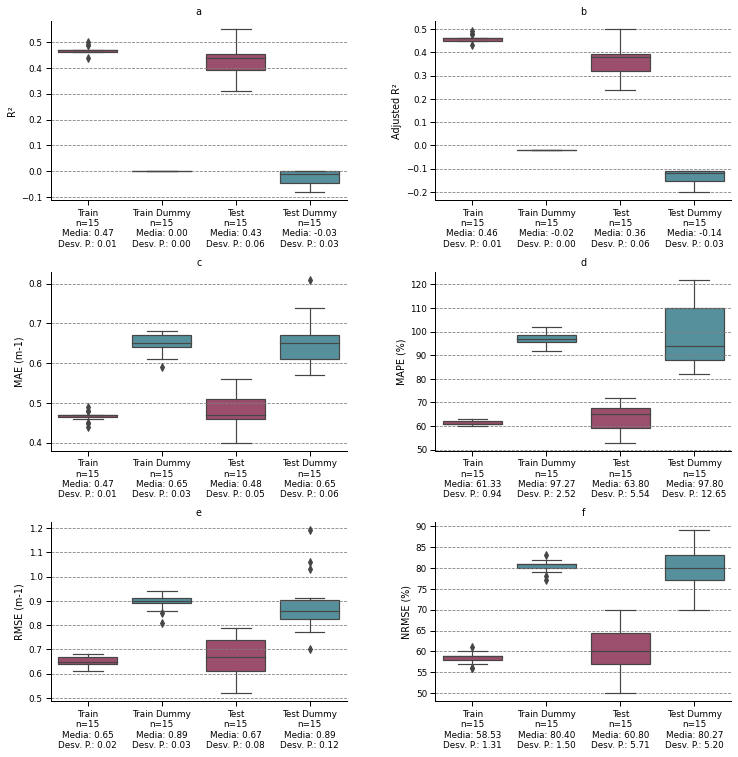


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


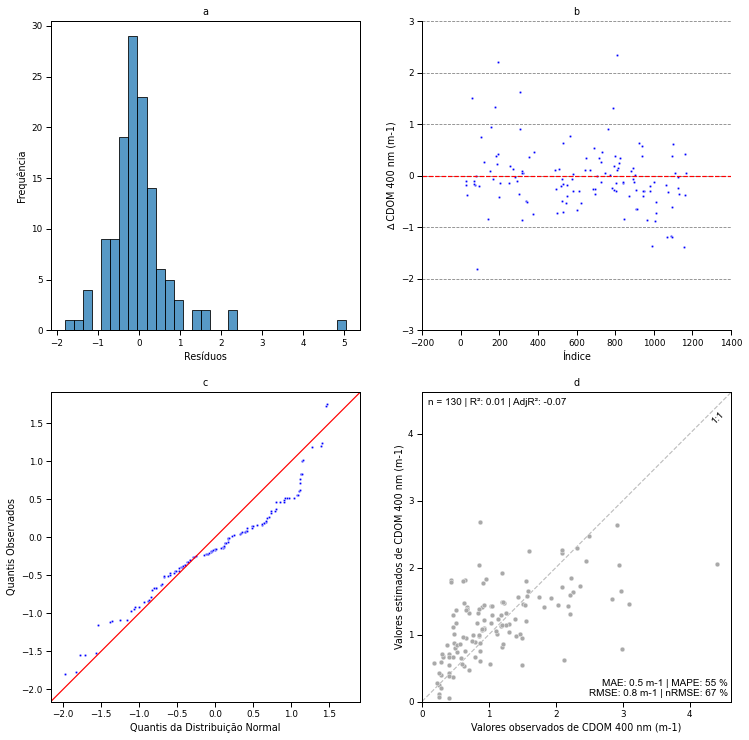

In [207]:
model_ = Model(X_scaled, y, model = LinearRegression(), wqp_unit='m-1')

model_.train_test_split_data()

#param_grid
param_grid={'positive': [False, True]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lr_result=model_.model_left_out()

#### 6.2.3.3 Lasso Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (Lasso()), sendo eles: {'alpha': 0.1}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


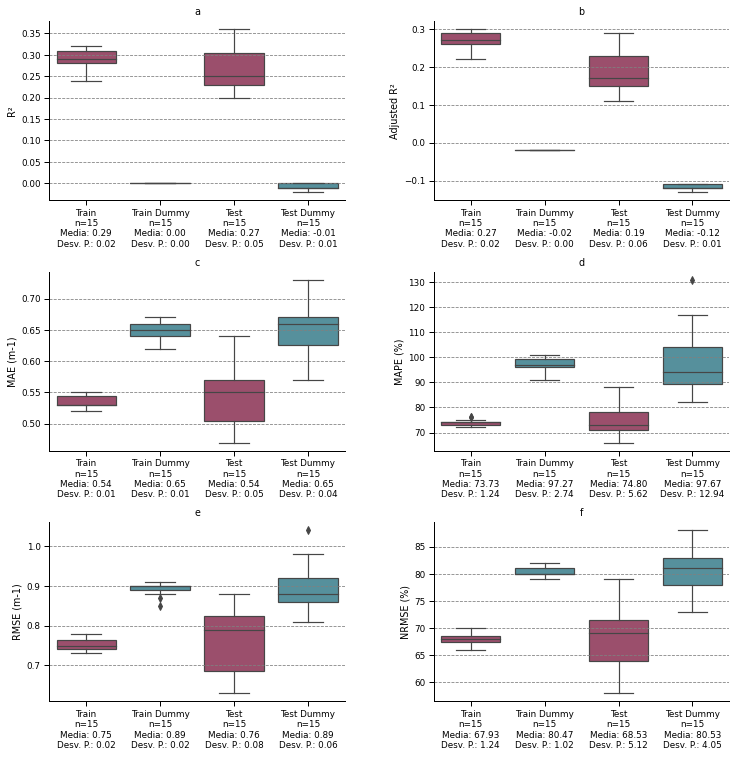


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


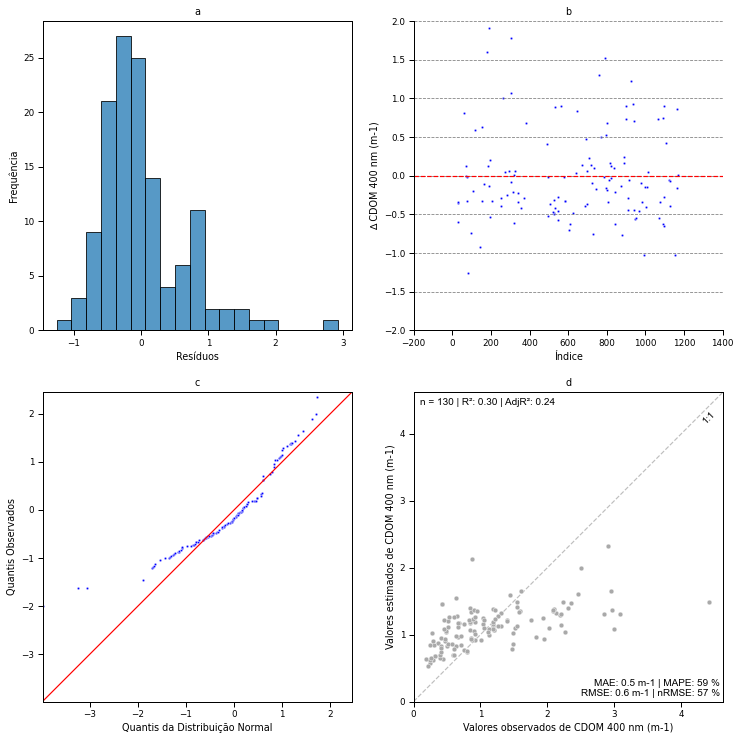

In [208]:
model_ = Model(X_scaled, y, model = Lasso(), wqp_unit='m-1')

model_.train_test_split_data()

#param_grid
param_grid={'alpha': [0.1, 0.5, 1, 10]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lasso_result=model_.model_left_out()

#### 6.2.3.4 SVM Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (SVR()), sendo eles: {'C': 100, 'epsilon': 0.1, 'gamma': 'scale', 'kernel': 'rbf'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


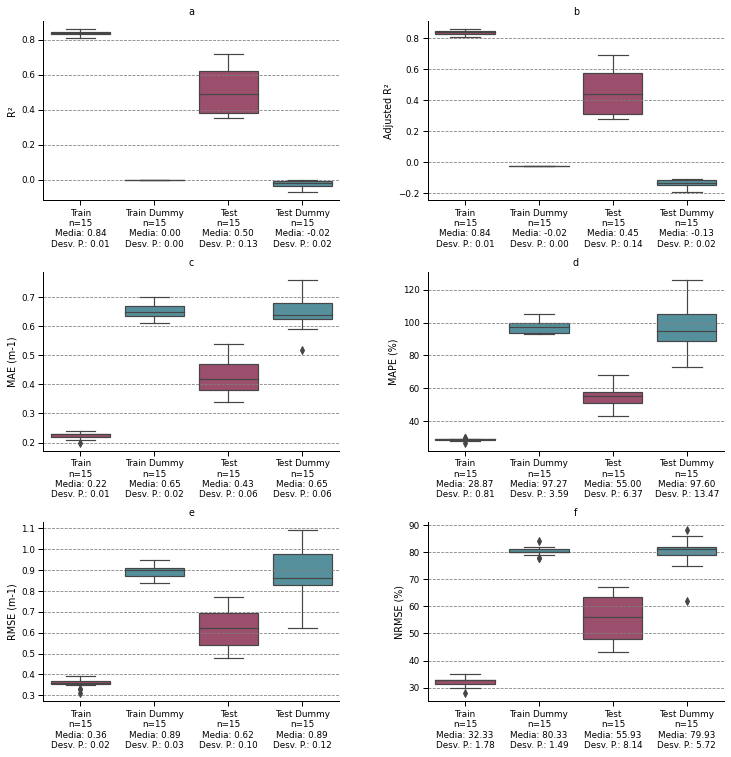


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


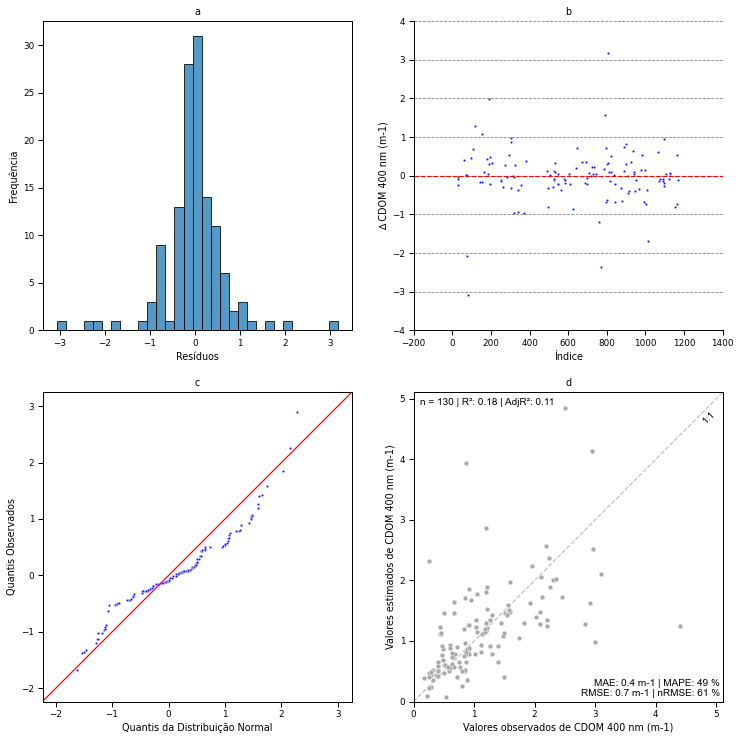

In [209]:
model_ = Model(X_scaled, y, model = SVR(), wqp_unit='m-1')

model_.train_test_split_data()

#param_grid
param_grid={'kernel': ['linear', 'poly', 'rbf', 'sigmoid'], 'C': [1, 100, 250, 500, 1000], 'epsilon': [0.01, 0.1, 1, 2, 5], 'gamma': ['scale', 'auto']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

svm_result=model_.model_left_out()

#### 6.2.3.5 Random Forest


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (RandomForestRegressor()), sendo eles: {'criterion': 'squared_error', 'max_depth': 25, 'n_estimators': 200}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


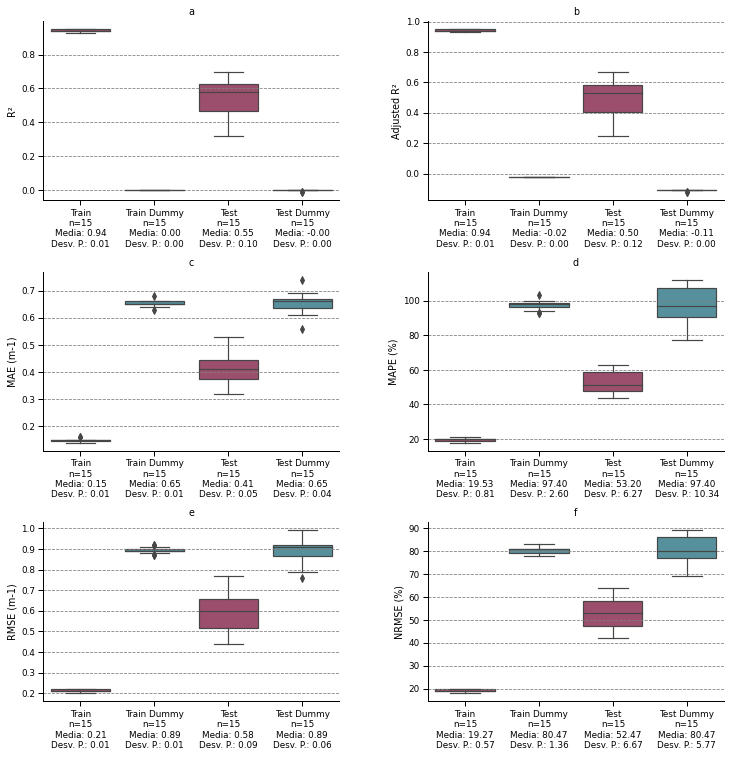


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


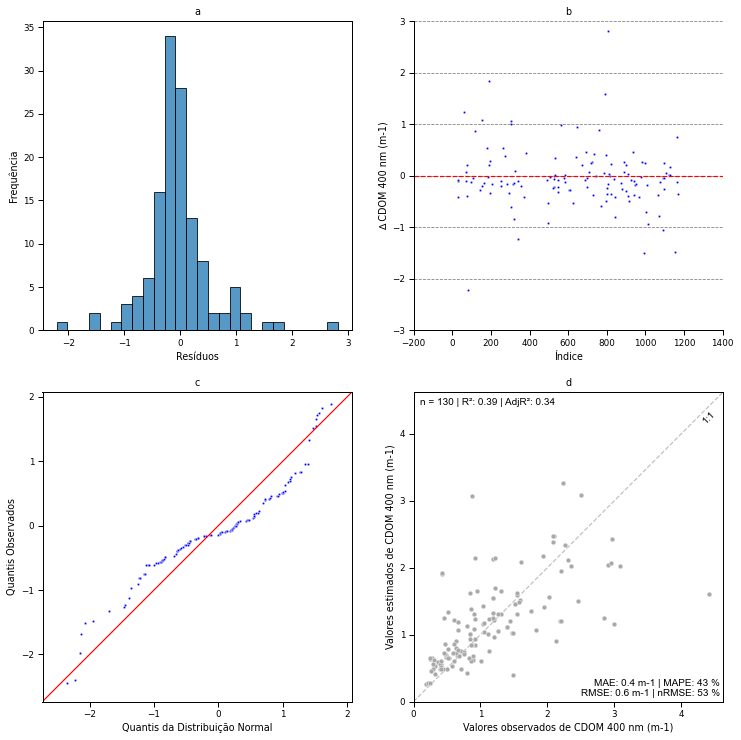

In [210]:
model_ = Model(X, y, model = RandomForestRegressor(), wqp_unit='m-1')

model_.train_test_split_data()

#param_grid

param_grid={'n_estimators': [10,30,50,70,100,200,500,1000], 'criterion': ["squared_error"], 'max_depth': [10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

rf_result=model_.model_left_out()

#### 6.2.3.6 XGBOOST


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, gamma=None,
             gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, predictor=None, random_state=None,
             reg_alpha=None, reg_lambda=None, ...)), sendo eles: {'max_depth': 5, 'n_estimators': 200}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO

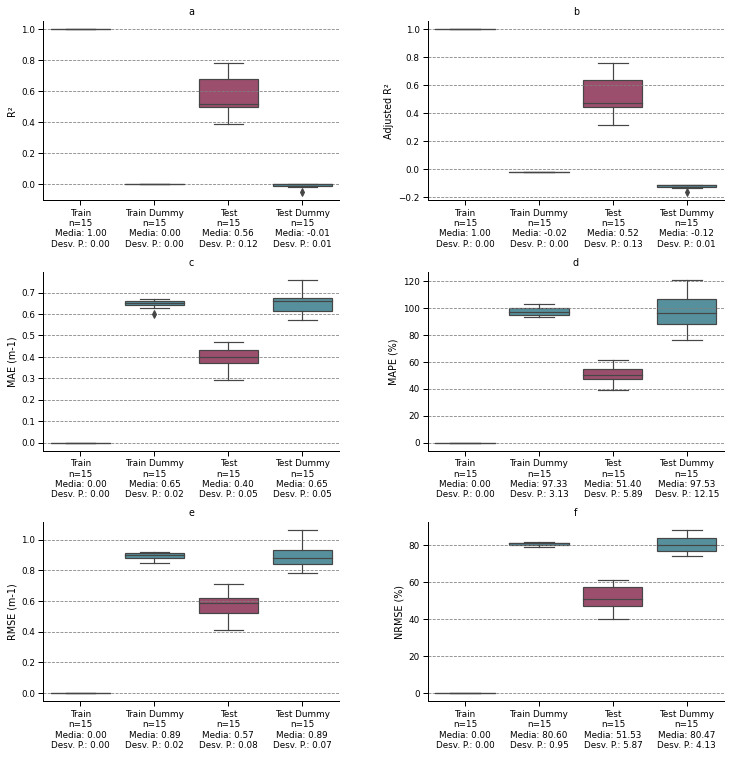


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


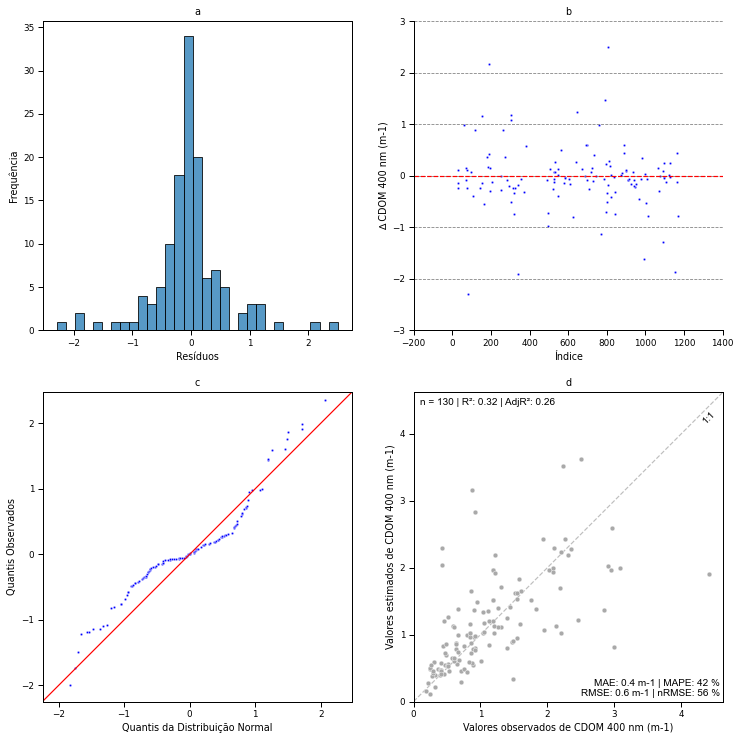

In [211]:
model_ = Model(X, y, model = XGBRegressor(), wqp_unit='m-1')

model_.train_test_split_data()

#param_grid
param_grid={'n_estimators': [10,30,50,70,100,200,500,1000], 'max_depth': [2, 5, 8, 10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

xgb_result=model_.model_left_out()

#### 6.2.3.7 MLP Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (MLPRegressor()), sendo eles: {'activation': 'tanh', 'hidden_layer_sizes': (6, 6), 'learning_rate': 'adaptive', 'max_iter': 100000, 'solver': 'sgd'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


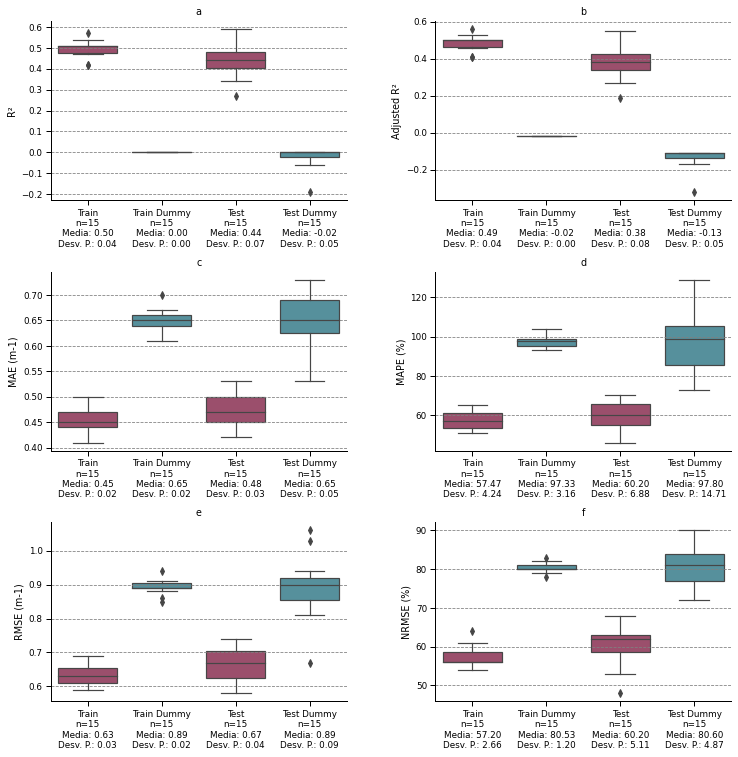


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


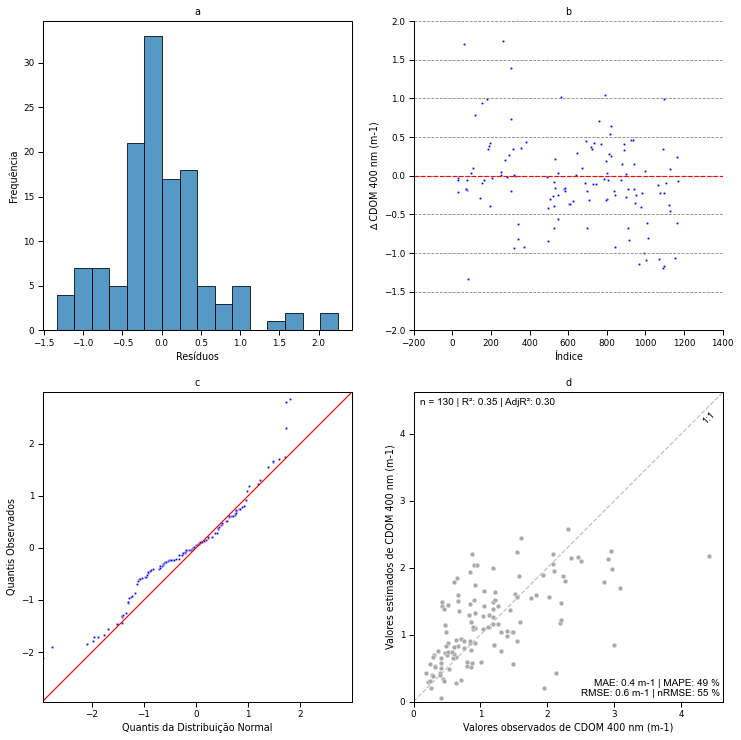

In [212]:
model_ = Model(X_scaled, y, model = MLPRegressor(), wqp_unit='m-1')

model_.train_test_split_data()

#param_grid
param_grid={'hidden_layer_sizes': [(6, ), (6, 6)], 'activation': ['tanh', 'relu'], 'solver': ['sgd'], 'max_iter': [100000], 'learning_rate': ['adaptive', 'invscaling']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

mlp_result=model_.model_left_out()

#### 6.2.3.8 Armazenando o resultado

In [213]:
cdom_results = pd.DataFrame([lr_result, lasso_result, svm_result, rf_result, xgb_result, mlp_result])
cdom_results.loc[:, 'index'] = 'CDOM at 400nm (m-1)'
cdom_results.head()

,model,params,train/validation,KFoldRepeat,mean_train_R²,mean_test_R²,validation_R²,mean_train_Adjusted R²,mean_test_Adjusted R²,validation_Adjusted R²,...,mean_train_MAPE (%),mean_test_MAPE (%),validation_MAPE (%),mean_train_RMSE,mean_test_RMSE,validation_RMSE,mean_train_NRMSE (%),mean_test_NRMSE (%),validation_NRMSE (%),index
0,LinearRegression,{'positive': False},518/130,5x3,0.47,0.43,0.01,0.46,0.36,-0.07,...,61.33,63.8,55.0,0.65,0.67,0.76,58.53,60.80,67.0,CDOM at 400nm (m-1)
1,Lasso,{'alpha': 0.1},518/130,5x3,0.29,0.27,0.30,0.27,0.19,0.24,...,73.73,74.8,59.0,0.75,0.76,0.64,67.93,68.53,57.0,CDOM at 400nm (m-1)
2,SVR,"{'C': 100, 'epsilon': 0.1, 'gamma': 'scale', '...",518/130,5x3,0.84,0.50,0.18,0.84,0.45,0.11,...,28.87,55.0,49.0,0.36,0.62,0.69,32.33,55.93,61.0,CDOM at 400nm (m-1)
3,RandomForestRegressor,"{'criterion': 'squared_error', 'max_depth': 25...",518/130,5x3,0.94,0.55,0.39,0.94,0.50,0.34,...,19.53,53.2,43.0,0.21,0.58,0.60,19.27,52.47,53.0,CDOM at 400nm (m-1)
4,XGBRegressor,"{'max_depth': 5, 'n_estimators': 200}",518/130,5x3,1.00,0.56,0.32,1.00,0.52,0.26,...,0.00,51.4,42.0,0.00,0.57,0.63,0.00,51.53,56.0,CDOM at 400nm (m-1)


### 6.2.4 Variável dependente: Profundidade do Disco de Secchi

#### 6.2.4.1 Separação de X e Y

In [214]:
df_enh.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 648 entries, 641 to 985
Data columns (total 35 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   img_id                          648 non-null    object        
 1   satellite                       648 non-null    object        
 2   Site                            648 non-null    object        
 3   Latitude (decimal deg)          648 non-null    float64       
 4   Longitude (decimal deg)         648 non-null    float64       
 5   date                            648 non-null    datetime64[ns]
 6   timestamp                       648 non-null    datetime64[ns]
 7   l8_blue                         648 non-null    float64       
 8   l8_green                        648 non-null    float64       
 9   l8_red                          648 non-null    float64       
 10  l8_nir                          648 non-null    float64       
 11  l8_s

In [215]:
X_cols = list(df_enh.columns[7:12]) + list(df_enh.columns[30:])
y_col = 'SDD (m)'


scaler = StandardScaler()


X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

#X = X

#scoring
r2_score_t = make_scorer(r2, greater_is_better=True)
#adj_r2_score_t = make_scorer(adj_r2, greater_is_better=True)
rmse_score = make_scorer(rmse, greater_is_better=False)
nrmse_score = make_scorer(nrmse, greater_is_better=False)
mae_score = make_scorer(mae, greater_is_better=False)
mape_score = make_scorer(mape, greater_is_better=False)
scoring = {'R²': r2_score_t, 'Adjusted R²': adj_r2, 'MAE': mae_score, 'MAPE (%)': mape_score, 'RMSE': rmse_score, 'NRMSE (%)': nrmse_score}

#### 6.2.4.2 Regressão linear múltipla

- Recomendado utilizar o X escalonado


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (LinearRegression()), sendo eles: {'positive': False}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


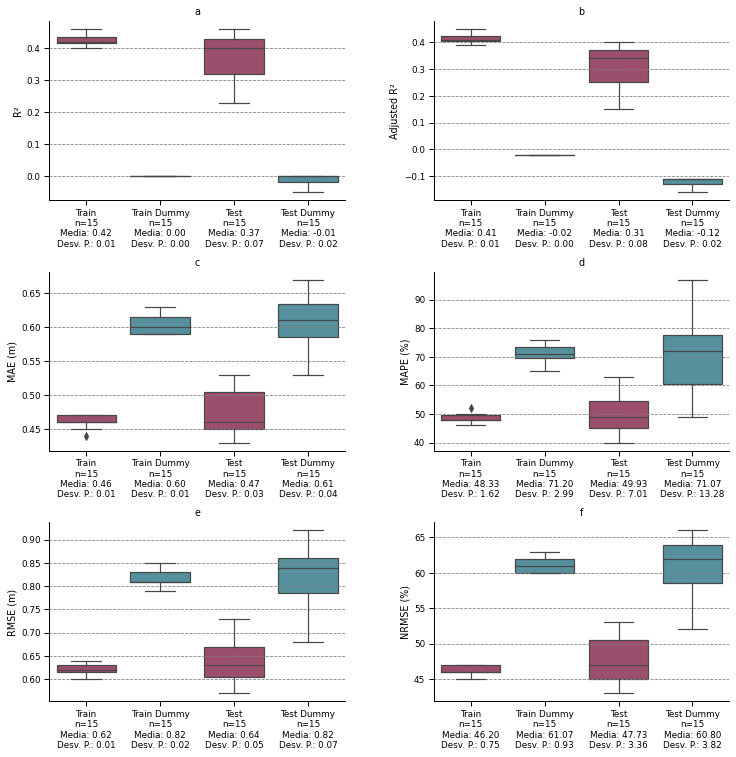


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


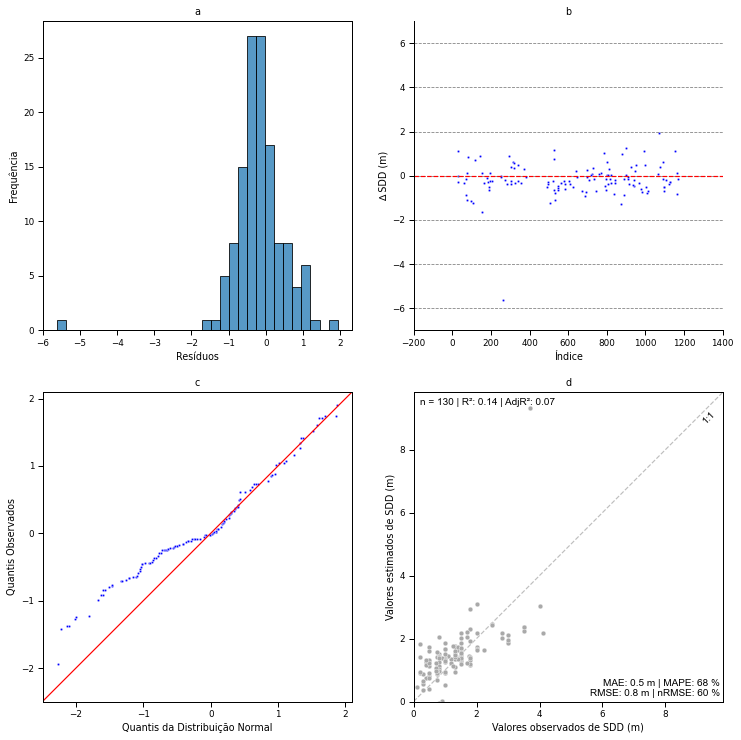

In [216]:
model_ = Model(X_scaled, y, model = LinearRegression(), wqp_unit='m')

model_.train_test_split_data()

#param_grid
param_grid={'positive': [False, True]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lr_result=model_.model_left_out()

#### 6.2.4.3 Lasso Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (Lasso()), sendo eles: {'alpha': 0.1}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


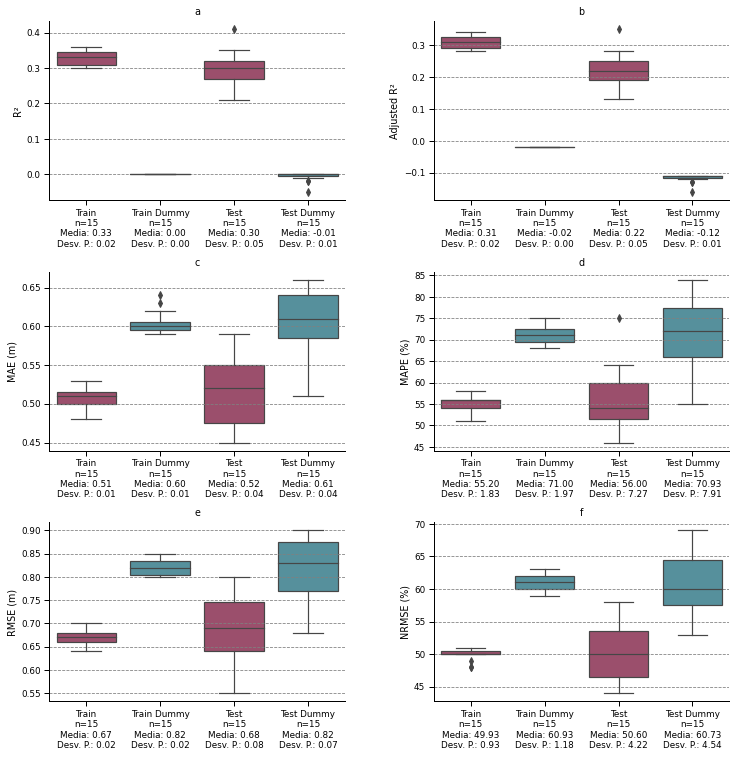


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


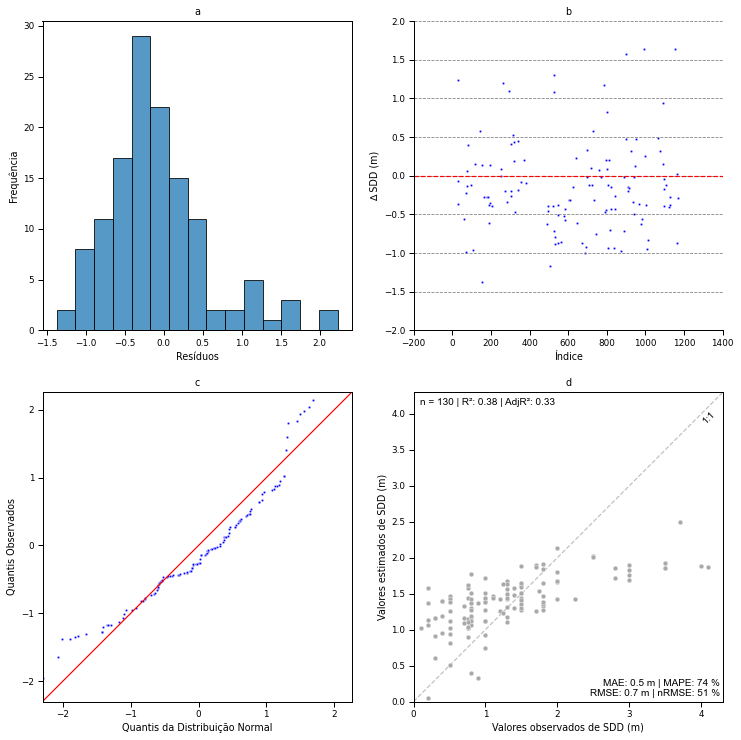

In [217]:
model_ = Model(X_scaled, y, model = Lasso(), wqp_unit='m')

model_.train_test_split_data()

#param_grid
param_grid={'alpha': [0.1, 0.5, 1, 10]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lasso_result=model_.model_left_out()

#### 6.2.4.4 SVM Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (SVR()), sendo eles: {'C': 1, 'epsilon': 0.1, 'gamma': 'auto', 'kernel': 'rbf'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


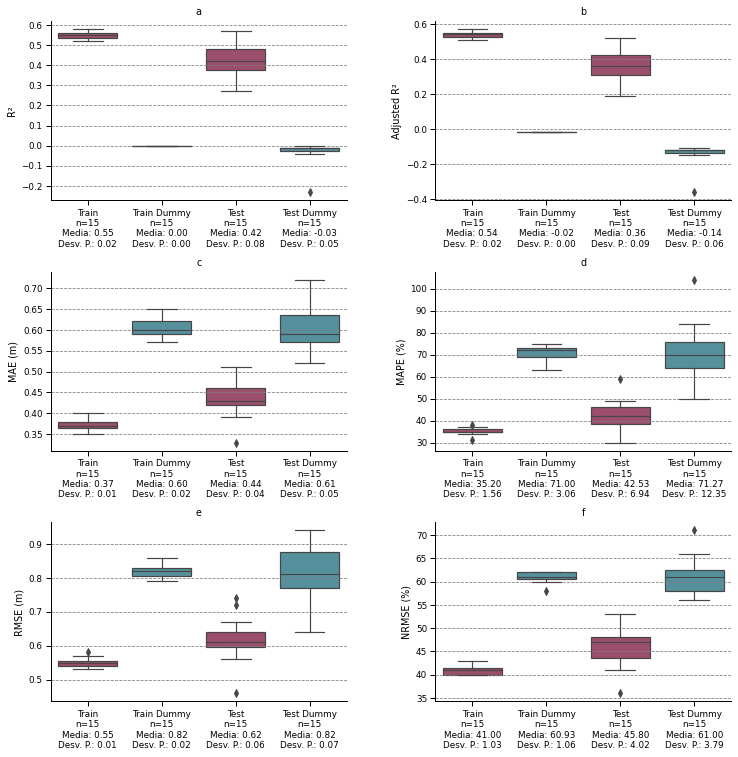


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


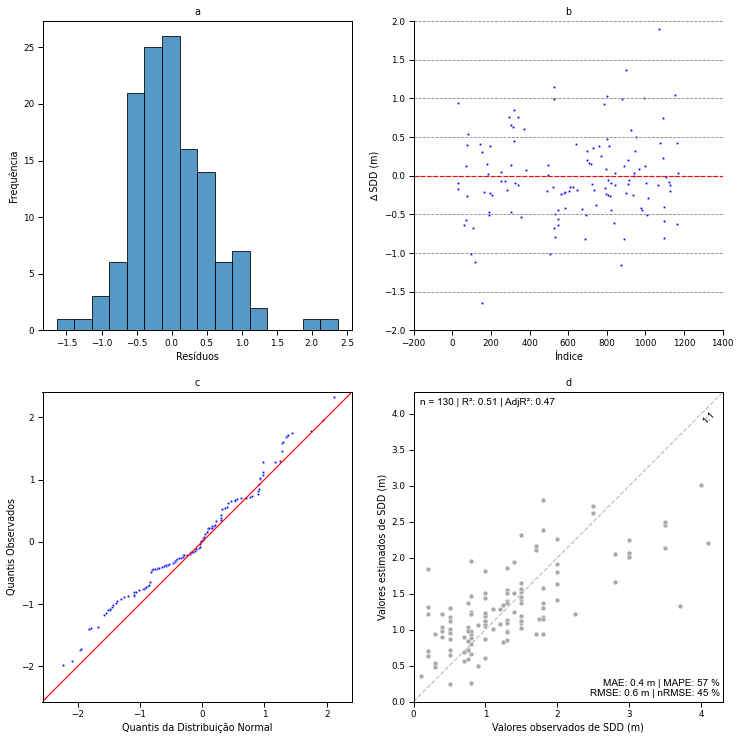

In [218]:
model_ = Model(X_scaled, y, model = SVR(), wqp_unit='m')

model_.train_test_split_data()

#param_grid
param_grid={'kernel': ['linear', 'poly', 'rbf', 'sigmoid'], 'C': [1, 100, 250, 500, 1000], 'epsilon': [0.01, 0.1, 1, 2, 5], 'gamma': ['scale', 'auto']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

svm_result=model_.model_left_out()

#### 6.2.4.5 Random Forest


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (RandomForestRegressor()), sendo eles: {'criterion': 'squared_error', 'max_depth': 10, 'n_estimators': 200}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


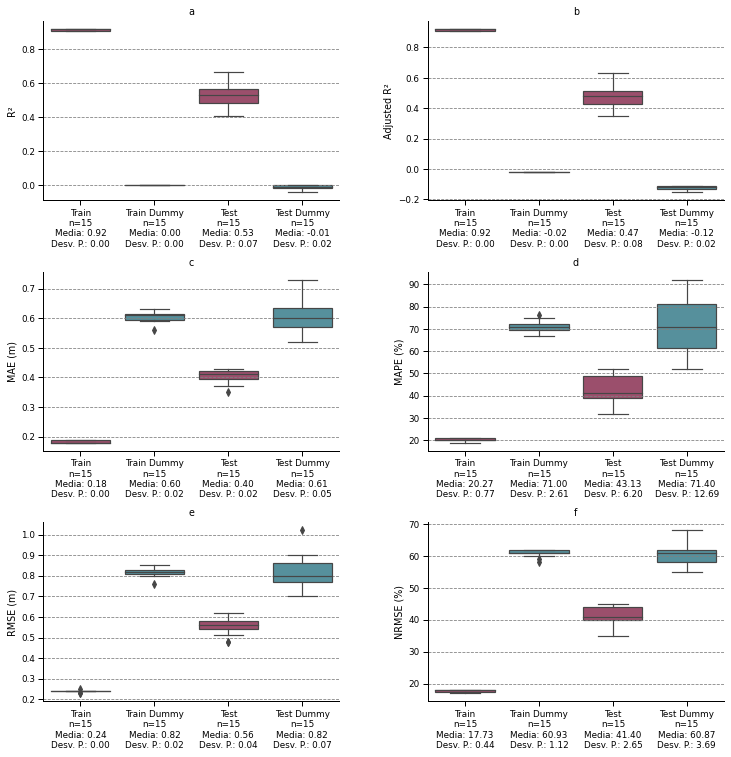


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


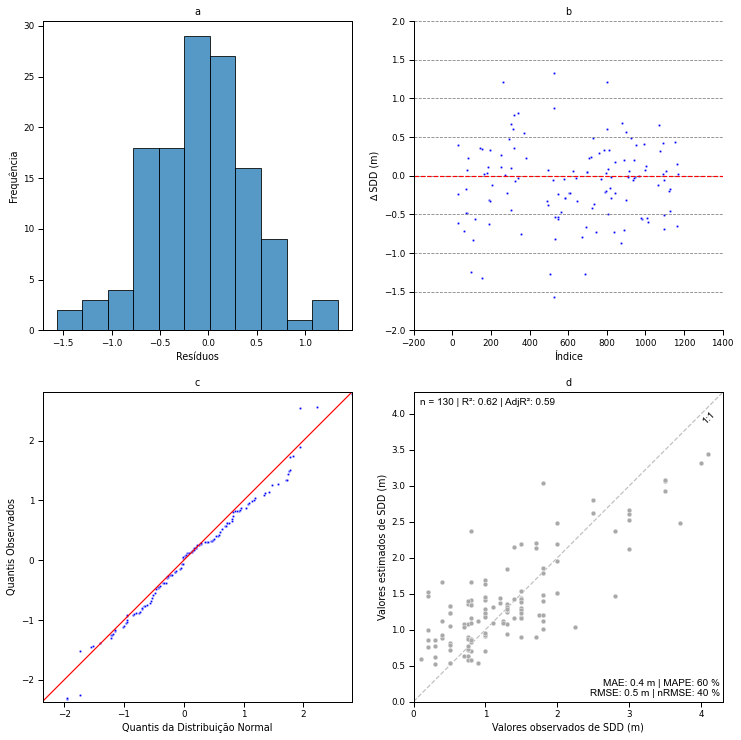

In [219]:
model_ = Model(X, y, model = RandomForestRegressor(), wqp_unit='m')

model_.train_test_split_data()

#param_grid

param_grid={'n_estimators': [10,30,50,70,100,200,500,1000], 'criterion': ["squared_error"], 'max_depth': [10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

rf_result=model_.model_left_out()

#### 6.2.4.6 XGBOOST


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, gamma=None,
             gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, predictor=None, random_state=None,
             reg_alpha=None, reg_lambda=None, ...)), sendo eles: {'max_depth': 2, 'n_estimators': 50}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO 

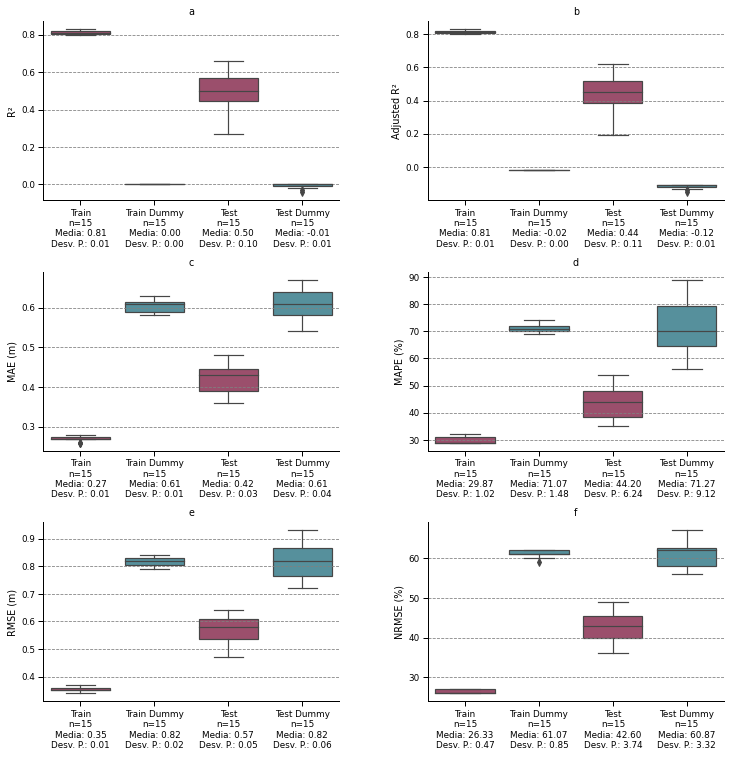


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


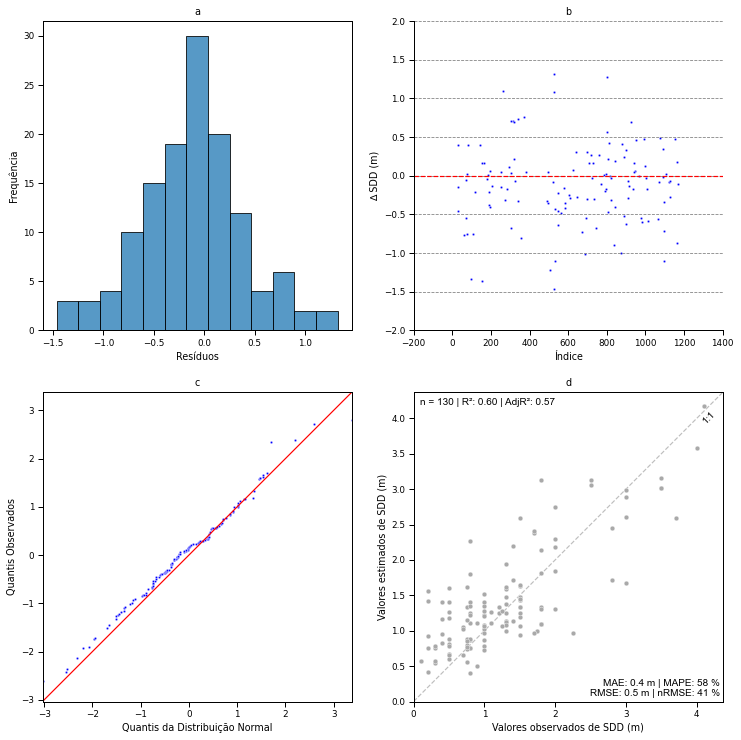

In [220]:
model_ = Model(X, y, model = XGBRegressor(), wqp_unit='m')

model_.train_test_split_data()

#param_grid
param_grid={'n_estimators': [10,30,50,70,100,200,500,1000], 'max_depth': [2, 5, 8, 10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

xgb_result=model_.model_left_out()

#### 6.2.4.7 MLP Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (MLPRegressor()), sendo eles: {'activation': 'tanh', 'hidden_layer_sizes': (6, 6), 'learning_rate': 'adaptive', 'max_iter': 100000, 'solver': 'sgd'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


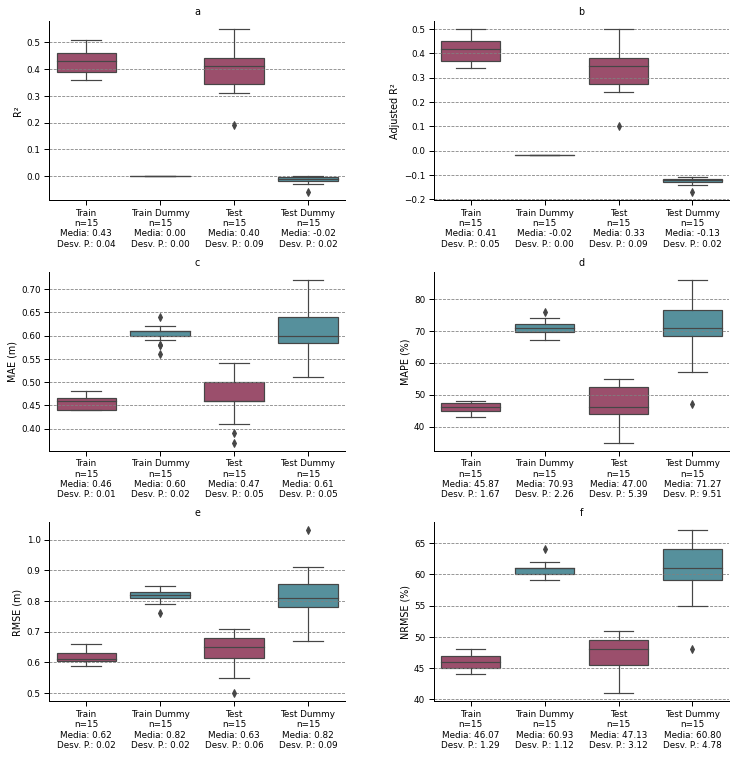


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


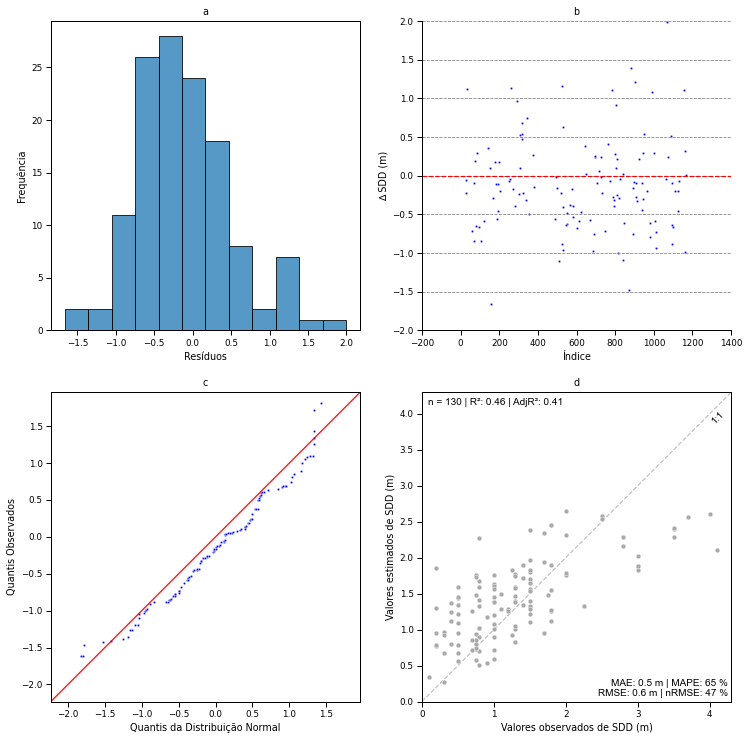

In [221]:
model_ = Model(X_scaled, y, model = MLPRegressor(), wqp_unit='m')

model_.train_test_split_data()

#param_grid
param_grid={'hidden_layer_sizes': [(6, ), (6, 6)], 'activation': ['tanh', 'relu'], 'solver': ['sgd'], 'max_iter': [100000], 'learning_rate': ['adaptive', 'invscaling']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

mlp_result=model_.model_left_out()

#'max_iter': [100000]

#### 6.2.4.8 Armazenando o resultado

In [222]:
sdd_results = pd.DataFrame([lr_result, lasso_result, svm_result, rf_result, xgb_result, mlp_result])
sdd_results.loc[:, 'index'] = 'SDD (m)'
sdd_results.head()

,model,params,train/validation,KFoldRepeat,mean_train_R²,mean_test_R²,validation_R²,mean_train_Adjusted R²,mean_test_Adjusted R²,validation_Adjusted R²,...,mean_train_MAPE (%),mean_test_MAPE (%),validation_MAPE (%),mean_train_RMSE,mean_test_RMSE,validation_RMSE,mean_train_NRMSE (%),mean_test_NRMSE (%),validation_NRMSE (%),index
0,LinearRegression,{'positive': False},518/130,5x3,0.42,0.37,0.14,0.41,0.31,0.07,...,48.33,49.93,68.0,0.62,0.64,0.78,46.20,47.73,60.0,SDD (m)
1,Lasso,{'alpha': 0.1},518/130,5x3,0.33,0.30,0.38,0.31,0.22,0.33,...,55.20,56.00,74.0,0.67,0.68,0.66,49.93,50.60,51.0,SDD (m)
2,SVR,"{'C': 1, 'epsilon': 0.1, 'gamma': 'auto', 'ker...",518/130,5x3,0.55,0.42,0.51,0.54,0.36,0.47,...,35.20,42.53,57.0,0.55,0.62,0.58,41.00,45.80,45.0,SDD (m)
3,RandomForestRegressor,"{'criterion': 'squared_error', 'max_depth': 10...",518/130,5x3,0.92,0.53,0.62,0.92,0.47,0.59,...,20.27,43.13,60.0,0.24,0.56,0.52,17.73,41.40,40.0,SDD (m)
4,XGBRegressor,"{'max_depth': 2, 'n_estimators': 50}",518/130,5x3,0.81,0.50,0.60,0.81,0.44,0.57,...,29.87,44.20,58.0,0.35,0.57,0.53,26.33,42.60,41.0,SDD (m)


### 6.2.5 Variável dependente: Sólidos totais em suspensão

#### 6.2.5.1 Separação de X e Y

In [223]:
df_enh.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 648 entries, 641 to 985
Data columns (total 35 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   img_id                          648 non-null    object        
 1   satellite                       648 non-null    object        
 2   Site                            648 non-null    object        
 3   Latitude (decimal deg)          648 non-null    float64       
 4   Longitude (decimal deg)         648 non-null    float64       
 5   date                            648 non-null    datetime64[ns]
 6   timestamp                       648 non-null    datetime64[ns]
 7   l8_blue                         648 non-null    float64       
 8   l8_green                        648 non-null    float64       
 9   l8_red                          648 non-null    float64       
 10  l8_nir                          648 non-null    float64       
 11  l8_s

In [224]:
X_cols = list(df_enh.columns[7:12]) + list(df_enh.columns[30:])
y_col = 'TSS (mg/L)'


scaler = StandardScaler()


X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

#X = X

#scoring
r2_score_t = make_scorer(r2, greater_is_better=True)
#adj_r2_score_t = make_scorer(adj_r2, greater_is_better=True)
rmse_score = make_scorer(rmse, greater_is_better=False)
nrmse_score = make_scorer(nrmse, greater_is_better=False)
mae_score = make_scorer(mae, greater_is_better=False)
mape_score = make_scorer(mape, greater_is_better=False)
scoring = {'R²': r2_score_t, 'Adjusted R²': adj_r2, 'MAE': mae_score, 'MAPE (%)': mape_score, 'RMSE': rmse_score, 'NRMSE (%)': nrmse_score}

#### 6.2.5.2 Regressão linear múltipla

- Recomendado utilizar o X escalonado


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (LinearRegression()), sendo eles: {'positive': False}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


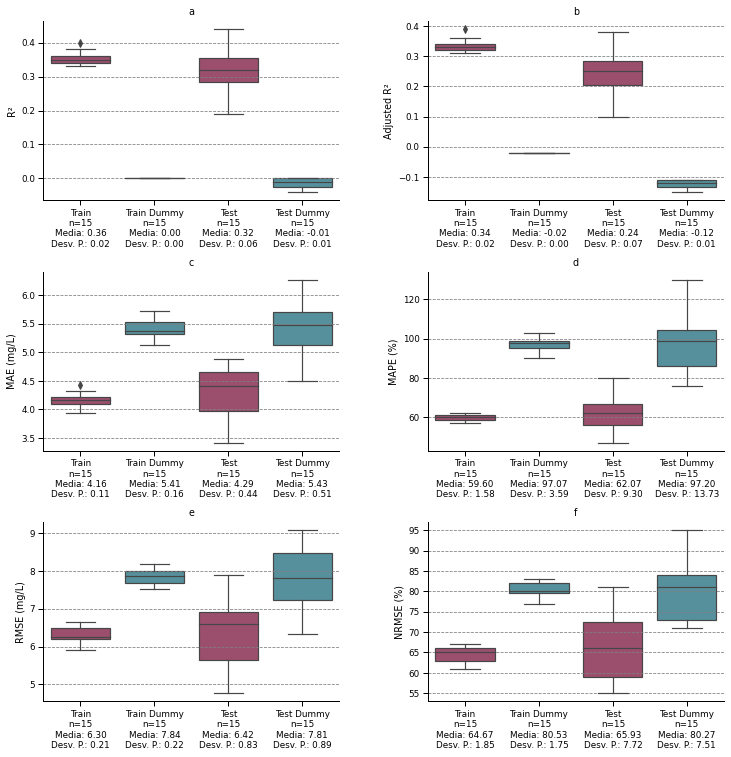


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


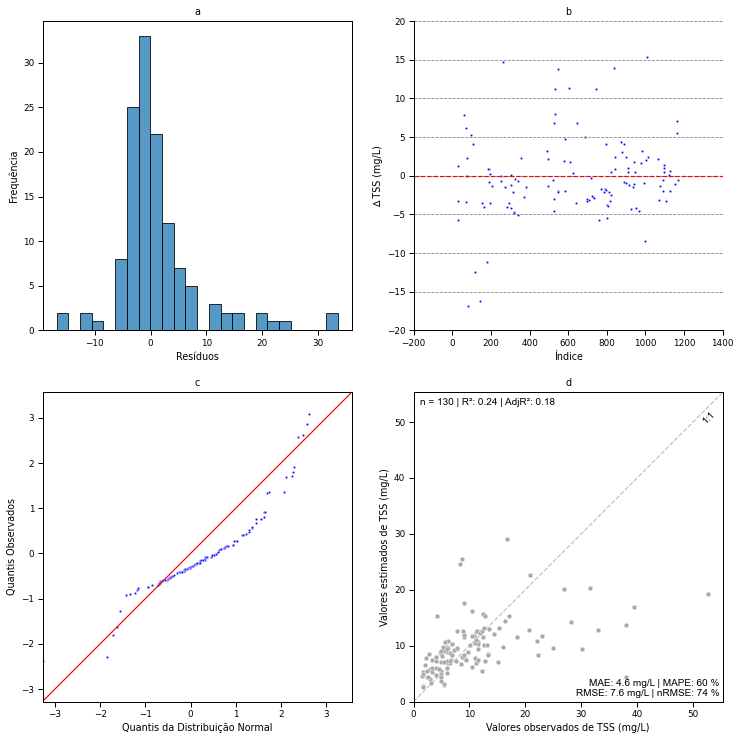

In [225]:
model_ = Model(X_scaled, y, model = LinearRegression(), wqp_unit='mg/L')

model_.train_test_split_data()

#param_grid
param_grid={'positive': [False, True]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lr_result=model_.model_left_out()

#### 6.2.5.3 Lasso Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (Lasso()), sendo eles: {'alpha': 0.1}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


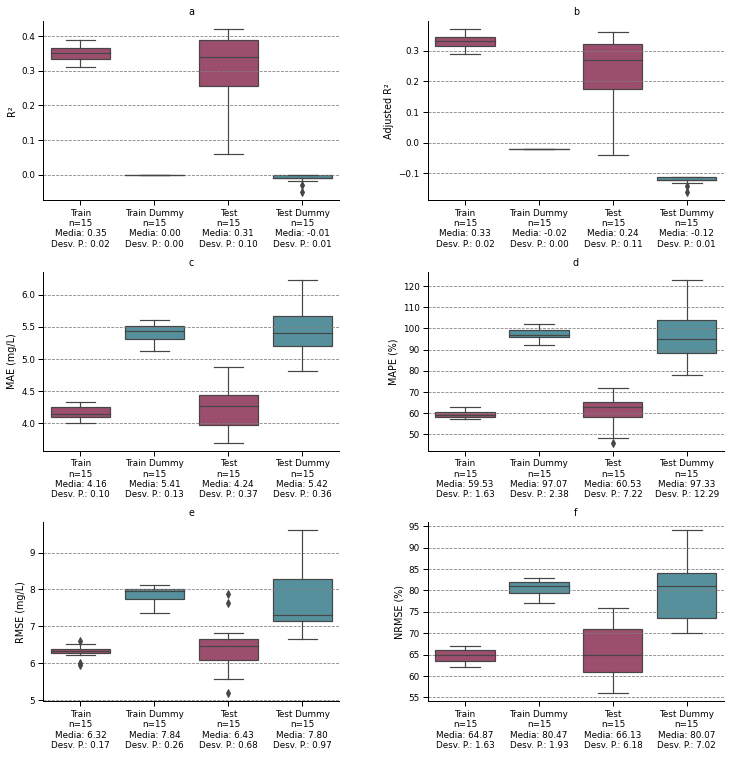


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


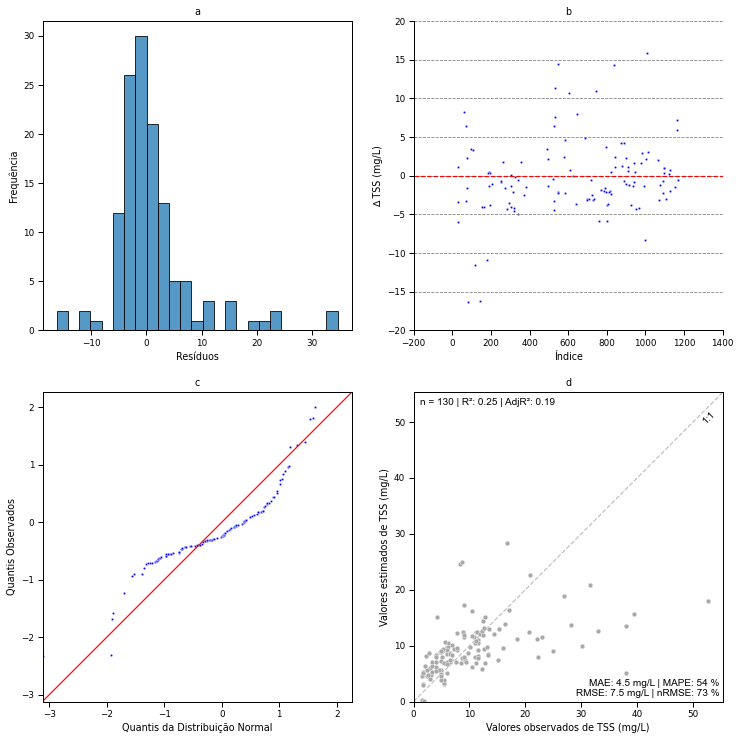

In [226]:
model_ = Model(X_scaled, y, model = Lasso(), wqp_unit='mg/L')

model_.train_test_split_data()

#param_grid
param_grid={'alpha': [0.1, 0.5, 1, 10]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

lasso_result=model_.model_left_out()

#### 6.2.5.4 SVM Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (SVR()), sendo eles: {'C': 1, 'epsilon': 5, 'gamma': 'scale', 'kernel': 'linear'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


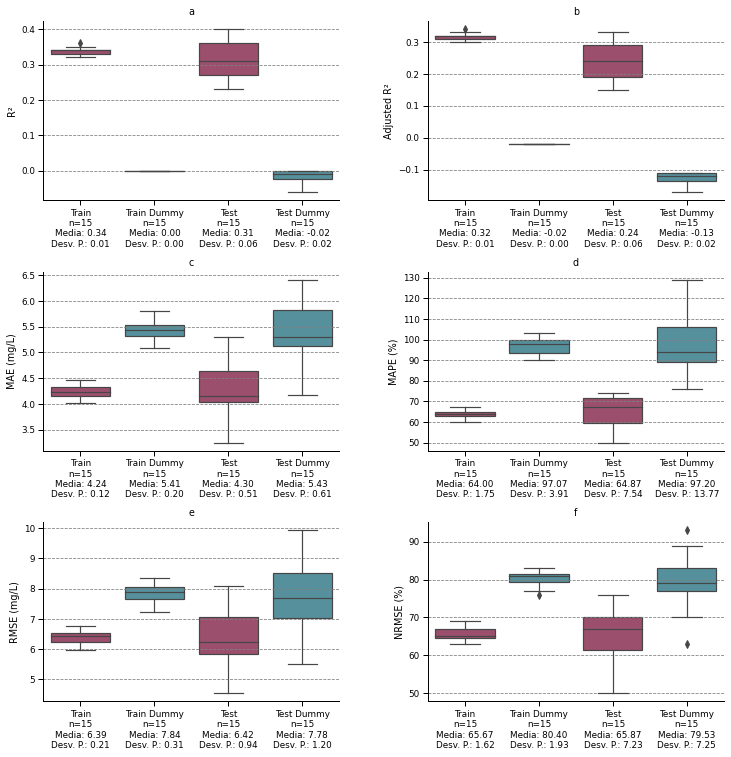


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


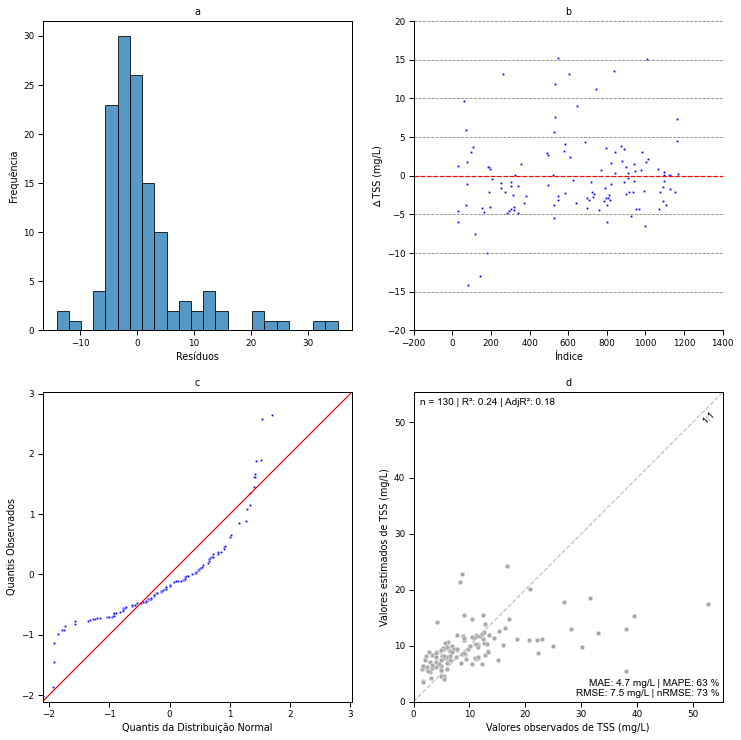

In [227]:
model_ = Model(X_scaled, y, model = SVR(), wqp_unit='mg/L')

model_.train_test_split_data()

#param_grid
param_grid={'kernel': ['linear', 'poly', 'rbf', 'sigmoid'], 'C': [1, 100, 250, 500, 1000], 'epsilon': [0.01, 0.1, 1, 2, 5], 'gamma': ['scale', 'auto']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

svm_result=model_.model_left_out()

#### 6.2.5.5 Random Forest


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (RandomForestRegressor()), sendo eles: {'criterion': 'squared_error', 'max_depth': 10, 'n_estimators': 500}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


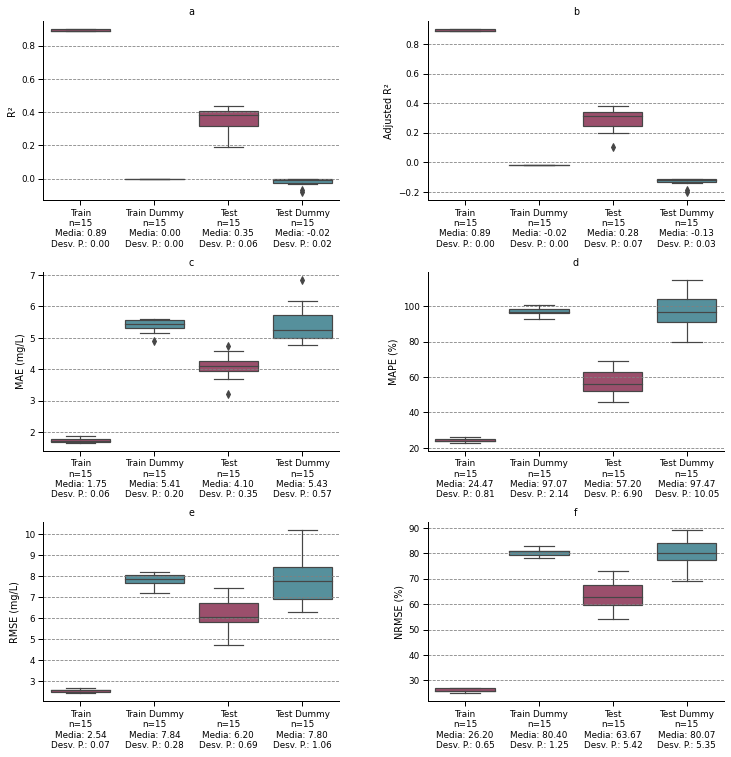


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


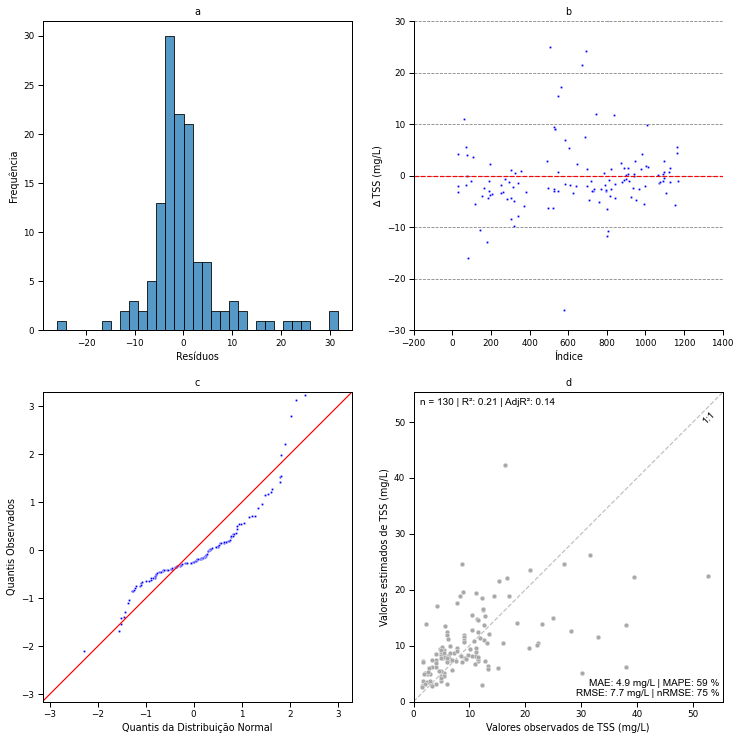

In [228]:
model_ = Model(X, y, model = RandomForestRegressor(), wqp_unit='mg/L')

model_.train_test_split_data()

#param_grid

param_grid={'n_estimators': [10,30,50,70,100,200,500,1000], 'criterion': ["squared_error"], 'max_depth': [10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

rf_result=model_.model_left_out()

#### 6.2.5.6 XGBOOST


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, gamma=None,
             gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
             max_leaves=None, min_child_weight=None, missing=nan,
             monotone_constraints=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, predictor=None, random_state=None,
             reg_alpha=None, reg_lambda=None, ...)), sendo eles: {'max_depth': 5, 'n_estimators': 10}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO 

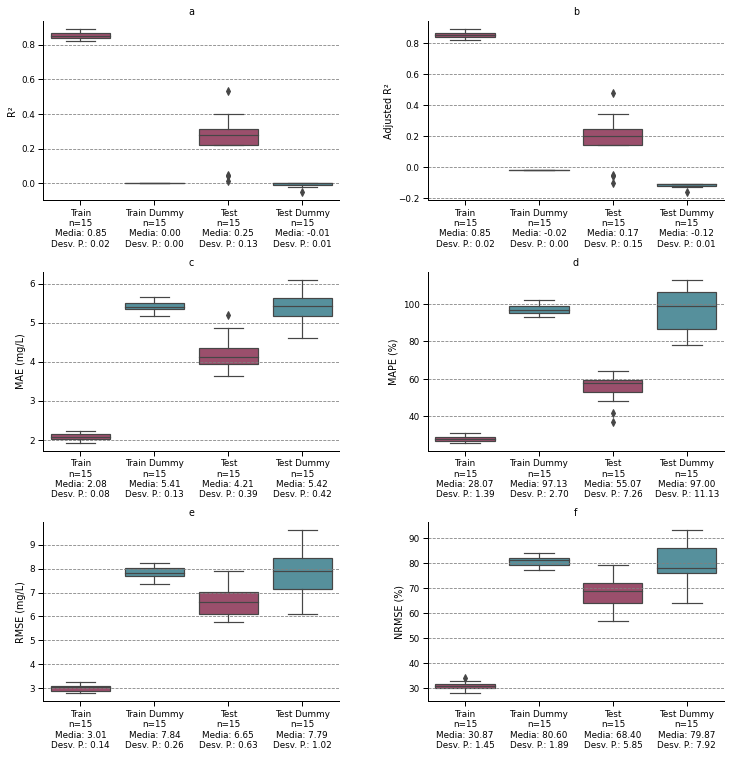


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


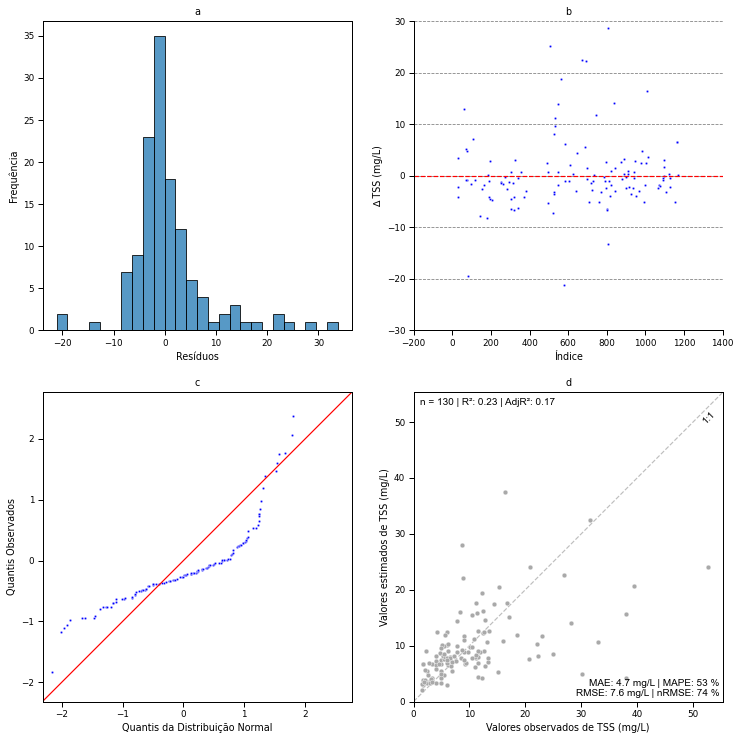

In [229]:
model_ = Model(X, y, model = XGBRegressor(), wqp_unit='mg/L')

model_.train_test_split_data()

#param_grid
param_grid={'n_estimators': [10,30,50,70,100,200,500,1000], 'max_depth': [2, 5, 8, 10, 25, 50]}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

xgb_result=model_.model_left_out()

#### 6.2.5.7 MLP Regressor


#--------------INICIANDO O GRID SEARCH CV------------#

O GridSearchCV encontrou os melhores hiperparâmetros         para o modelo escolhido (MLPRegressor()), sendo eles: {'activation': 'tanh', 'hidden_layer_sizes': (6, 6), 'learning_rate': 'adaptive', 'max_iter': 100000, 'solver': 'sgd'}

#-----------FIM DO GRID SEARCH CV--------------#

#--------------INICIANDO O CROSS VALIDATION PARA OS MELHORES HYPERPARAMETERS------------#

#-----------PLOTANDO GRÁFICOS COM MÉTRICAS DE TREINAMENTO E TESTE--------------#


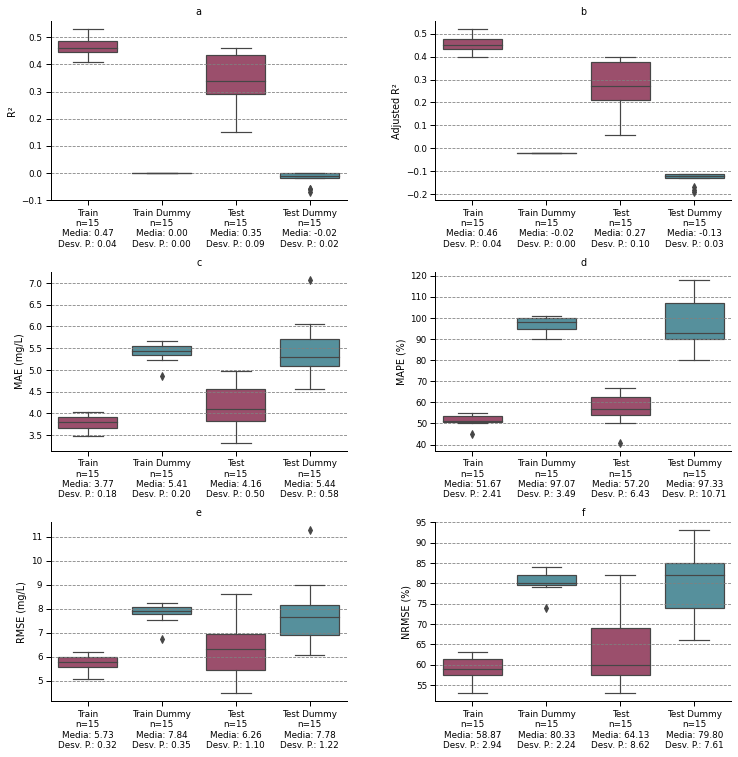


#-----------ETAPA DE VALIDAÇÃO DO MODELO - APLICAÇÃO DO MODELO EM 20% DOS DADOS NÃO CALIBRADOS--------------#

#-----------PLOTANDO GRÁFICOS DE VALIDAÇÃO--------------#


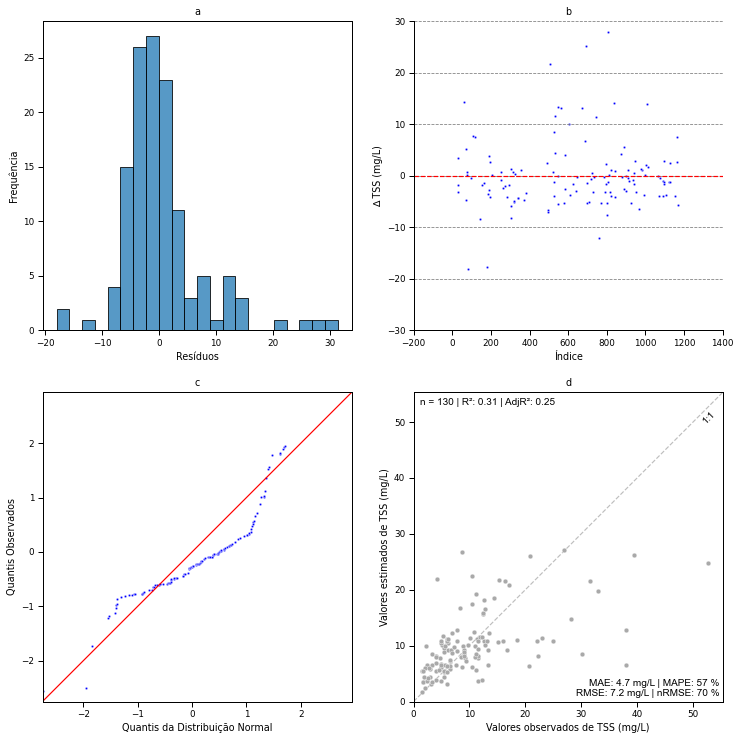

In [230]:
model_ = Model(X_scaled, y, model = MLPRegressor(), wqp_unit='mg/L')

model_.train_test_split_data()

#param_grid
param_grid={'hidden_layer_sizes': [(6, ), (6, 6)], 'activation': ['tanh', 'relu'], 'solver': ['sgd'], 'max_iter': [100000], 'learning_rate': ['adaptive', 'invscaling']}

model_.grid_search(param_grid = param_grid, scoring = scoring, n_cv=5, refit = 'RMSE')

model_.cv_model_results()

mlp_result=model_.model_left_out()

#### 6.2.5.8 Armazenando o resultado

In [231]:
tss_results = pd.DataFrame([lr_result, lasso_result, svm_result, rf_result, xgb_result, mlp_result])
tss_results.loc[:, 'index'] = 'TSS (mg/L)'
tss_results.head()

,model,params,train/validation,KFoldRepeat,mean_train_R²,mean_test_R²,validation_R²,mean_train_Adjusted R²,mean_test_Adjusted R²,validation_Adjusted R²,...,mean_train_MAPE (%),mean_test_MAPE (%),validation_MAPE (%),mean_train_RMSE,mean_test_RMSE,validation_RMSE,mean_train_NRMSE (%),mean_test_NRMSE (%),validation_NRMSE (%),index
0,LinearRegression,{'positive': False},518/130,5x3,0.36,0.32,0.24,0.34,0.24,0.18,...,59.60,62.07,60.0,6.30,6.42,7.56,64.67,65.93,74.0,TSS (mg/L)
1,Lasso,{'alpha': 0.1},518/130,5x3,0.35,0.31,0.25,0.33,0.24,0.19,...,59.53,60.53,54.0,6.32,6.43,7.49,64.87,66.13,73.0,TSS (mg/L)
2,SVR,"{'C': 1, 'epsilon': 5, 'gamma': 'scale', 'kern...",518/130,5x3,0.34,0.31,0.24,0.32,0.24,0.18,...,64.00,64.87,63.0,6.39,6.42,7.55,65.67,65.87,73.0,TSS (mg/L)
3,RandomForestRegressor,"{'criterion': 'squared_error', 'max_depth': 10...",518/130,5x3,0.89,0.35,0.21,0.89,0.28,0.14,...,24.47,57.20,59.0,2.54,6.20,7.67,26.20,63.67,75.0,TSS (mg/L)
4,XGBRegressor,"{'max_depth': 5, 'n_estimators': 10}",518/130,5x3,0.85,0.25,0.23,0.85,0.17,0.17,...,28.07,55.07,53.0,3.01,6.65,7.60,30.87,68.40,74.0,TSS (mg/L)


## 6.3 Salvando os resultados dos modelos em um dataframe

In [232]:
df_model = pd.concat([tss_results, sdd_results, cdom_results, chla_results, turb_results], axis=0)

In [63]:
df_model

,model,params,train/validation,KFoldRepeat,mean_train_R²,mean_test_R²,validation_R²,mean_train_Adjusted R²,mean_test_Adjusted R²,validation_Adjusted R²,...,mean_train_MAPE (%),mean_test_MAPE (%),validation_MAPE (%),mean_train_RMSE,mean_test_RMSE,validation_RMSE,mean_train_NRMSE (%),mean_test_NRMSE (%),validation_NRMSE (%),index
0,LinearRegression,{'positive': False},518/130,5x3,0.36,0.32,0.24,0.34,0.24,0.18,...,59.60,62.07,60.0,6.30,6.42,7.56,64.67,65.93,74.0,TSS (mg/L)
1,Lasso,{'alpha': 0.1},518/130,5x3,0.35,0.31,0.25,0.33,0.24,0.19,...,59.53,60.53,54.0,6.32,6.43,7.49,64.87,66.13,73.0,TSS (mg/L)
2,SVR,"{'C': 1, 'epsilon': 5, 'gamma': 'scale', 'kern...",518/130,5x3,0.34,0.31,0.24,0.32,0.24,0.18,...,64.00,64.87,63.0,6.39,6.42,7.55,65.67,65.87,73.0,TSS (mg/L)
3,RandomForestRegressor,"{'criterion': 'squared_error', 'max_depth': 10...",518/130,5x3,0.89,0.35,0.21,0.89,0.28,0.14,...,24.47,57.20,59.0,2.54,6.20,7.67,26.20,63.67,75.0,TSS (mg/L)
4,XGBRegressor,"{'max_depth': 5, 'n_estimators': 10}",518/130,5x3,0.85,0.25,0.23,0.85,0.17,0.17,...,28.07,55.07,53.0,3.01,6.65,7.60,30.87,68.40,74.0,TSS (mg/L)
5,MLPRegressor,"{'activation': 'tanh', 'hidden_layer_sizes': (...",518/130,5x3,0.47,0.35,0.31,0.46,0.27,0.25,...,51.67,57.20,57.0,5.73,6.26,7.18,58.87,64.13,70.0,TSS (mg/L)
0,LinearRegression,{'positive': False},518/130,5x3,0.42,0.37,0.14,0.41,0.31,0.07,...,48.33,49.93,68.0,0.62,0.64,0.78,46.20,47.73,60.0,SDD (m)
1,Lasso,{'alpha': 0.1},518/130,5x3,0.33,0.30,0.38,0.31,0.22,0.33,...,55.20,56.00,74.0,0.67,0.68,0.66,49.93,50.60,51.0,SDD (m)
2,SVR,"{'C': 1, 'epsilon': 0.1, 'gamma': 'auto', 'ker...",518/130,5x3,0.55,0.42,0.51,0.54,0.36,0.47,...,35.20,42.53,57.0,0.55,0.62,0.58,41.00,45.80,45.0,SDD (m)
3,RandomForestRegressor,"{'criterion': 'squared_error', 'max_depth': 10...",518/130,5x3,0.92,0.53,0.62,0.92,0.47,0.59,...,20.27,43.13,60.0,0.24,0.56,0.52,17.73,41.40,40.0,SDD (m)


## 6.4 Salvando o dataframe localmente

In [240]:
df_model.to_pickle('df_model_TCC.pkl')

## 6.5 Gráfico com principais métricas para os principais modelos

In [25]:
df_model = pd.read_pickle('df_model_TCC.pkl')
df_model.head()

,model,params,train/validation,KFoldRepeat,mean_train_R²,mean_test_R²,validation_R²,mean_train_Adjusted R²,mean_test_Adjusted R²,validation_Adjusted R²,...,mean_train_MAPE (%),mean_test_MAPE (%),validation_MAPE (%),mean_train_RMSE,mean_test_RMSE,validation_RMSE,mean_train_NRMSE (%),mean_test_NRMSE (%),validation_NRMSE (%),index
0,LinearRegression,{'positive': False},518/130,5x3,0.36,0.32,0.24,0.34,0.24,0.18,...,59.60,62.07,60.0,6.30,6.42,7.56,64.67,65.93,74.0,TSS (mg/L)
1,Lasso,{'alpha': 0.1},518/130,5x3,0.35,0.31,0.25,0.33,0.24,0.19,...,59.53,60.53,54.0,6.32,6.43,7.49,64.87,66.13,73.0,TSS (mg/L)
2,SVR,"{'C': 1, 'epsilon': 5, 'gamma': 'scale', 'kern...",518/130,5x3,0.34,0.31,0.24,0.32,0.24,0.18,...,64.00,64.87,63.0,6.39,6.42,7.55,65.67,65.87,73.0,TSS (mg/L)
3,RandomForestRegressor,"{'criterion': 'squared_error', 'max_depth': 10...",518/130,5x3,0.89,0.35,0.21,0.89,0.28,0.14,...,24.47,57.20,59.0,2.54,6.20,7.67,26.20,63.67,75.0,TSS (mg/L)
4,XGBRegressor,"{'max_depth': 5, 'n_estimators': 10}",518/130,5x3,0.85,0.25,0.23,0.85,0.17,0.17,...,28.07,55.07,53.0,3.01,6.65,7.60,30.87,68.40,74.0,TSS (mg/L)


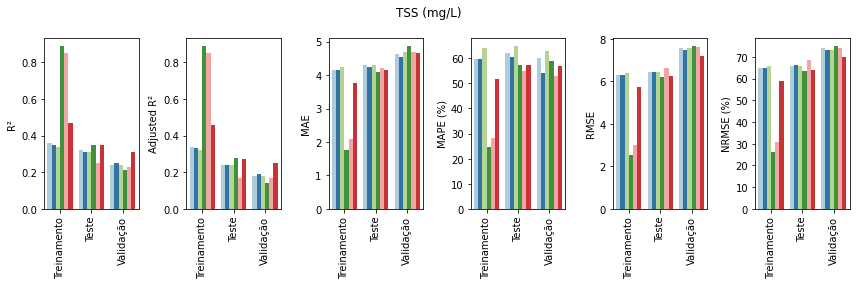

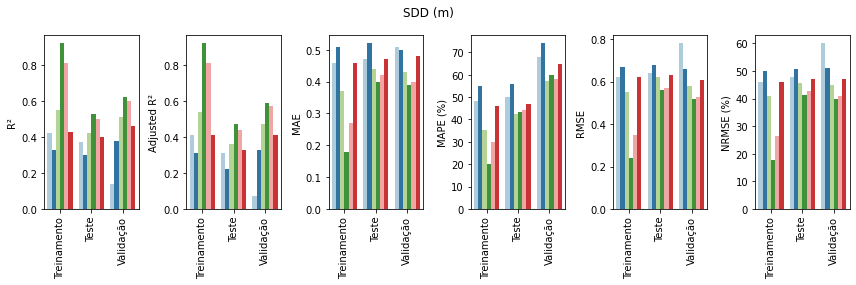

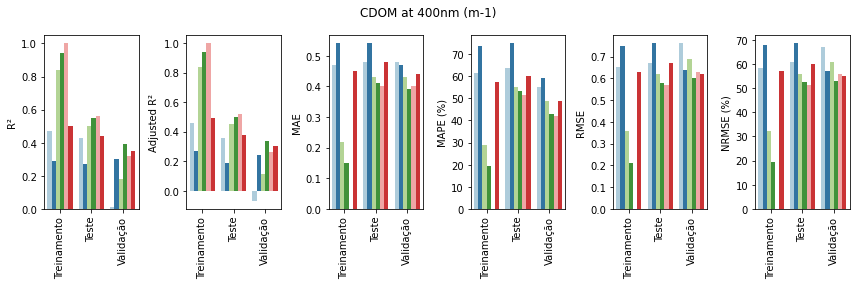

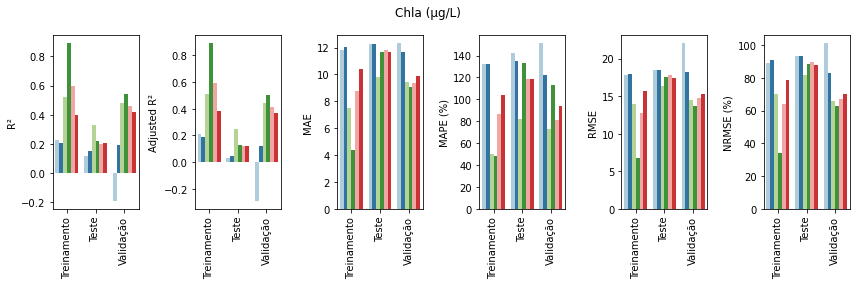

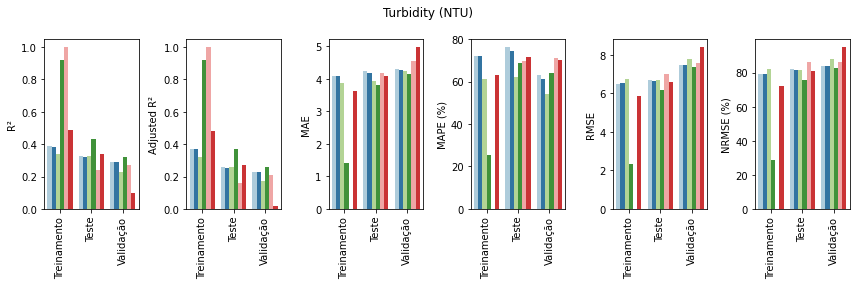

In [55]:
for index in df_model.loc[:, 'index'].unique():
    
    fig, axs = plt.subplots(nrows = 1, ncols = 6, figsize=(12, 4))
    
    
    a = pd.melt(frame = df_model.loc[df_model['index']==index], id_vars = 'model', value_name = "R²", value_vars = [x for x in df_model.columns if x.endswith('_R²')])
    sns.barplot(ax = axs[0], data = a, x = 'variable', y = 'R²', hue = 'model', palette="Paired")
    
    b = pd.melt(frame = df_model.loc[df_model['index']==index], id_vars = 'model', value_name = "Adjusted R²", value_vars = [x for x in df_model.columns if x.endswith('Adjusted R²')])
    sns.barplot(ax = axs[1], data = b, x = 'variable', y = 'Adjusted R²', hue = 'model', palette="Paired")
    
    c = pd.melt(frame = df_model.loc[df_model['index']==index], id_vars = 'model', value_name = "MAE", value_vars = [x for x in df_model.columns if x.endswith('_MAE')])
    sns.barplot(ax = axs[2], data = c, x = 'variable', y = 'MAE', hue = 'model', palette="Paired")
    
    d = pd.melt(frame = df_model.loc[df_model['index']==index], id_vars = 'model', value_name = "MAPE (%)", value_vars = [x for x in df_model.columns if x.endswith('_MAPE (%)')])
    sns.barplot(ax = axs[3], data = d, x = 'variable', y = 'MAPE (%)', hue = 'model', palette="Paired")
    
    e = pd.melt(frame = df_model.loc[df_model['index']==index], id_vars = 'model', value_name = "RMSE", value_vars = [x for x in df_model.columns if x.endswith('_RMSE')])
    sns.barplot(ax = axs[4], data = e, x = 'variable', y = 'RMSE', hue = 'model', palette="Paired")
    
    f = pd.melt(frame = df_model.loc[df_model['index']==index], id_vars = 'model', value_name = "NRMSE (%)", value_vars = [x for x in df_model.columns if x.endswith('_NRMSE (%)')])
    sns.barplot(ax = axs[5], data = f, x = 'variable', y = 'NRMSE (%)', hue = 'model', palette="Paired")
    
    for ax in axs:
        ax.set_xticklabels(['Treinamento', 'Teste', 'Validação'], rotation = 90)
        ax.set_xlabel('')
        ax.get_legend().remove()
    
    plt.suptitle(index)
    '''plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.5, 
                    hspace=0.5)'''
    plt.tight_layout()
    

In [8]:
df_model['index']

0             TSS (mg/L)
1             TSS (mg/L)
2             TSS (mg/L)
3             TSS (mg/L)
4             TSS (mg/L)
5             TSS (mg/L)
0                SDD (m)
1                SDD (m)
2                SDD (m)
3                SDD (m)
4                SDD (m)
5                SDD (m)
0    CDOM at 400nm (m-1)
1    CDOM at 400nm (m-1)
2    CDOM at 400nm (m-1)
3    CDOM at 400nm (m-1)
4    CDOM at 400nm (m-1)
5    CDOM at 400nm (m-1)
0            Chla (µg/L)
1            Chla (µg/L)
2            Chla (µg/L)
3            Chla (µg/L)
4            Chla (µg/L)
5            Chla (µg/L)
0        Turbidity (NTU)
1        Turbidity (NTU)
2        Turbidity (NTU)
3        Turbidity (NTU)
4        Turbidity (NTU)
5        Turbidity (NTU)
Name: index, dtype: object

In [13]:
for row in df_model.loc[df_model['index']=='TSS (mg/L)', 'params']:
    print(row)

{'positive': False}
{'alpha': 0.1}
{'C': 1, 'epsilon': 5, 'gamma': 'scale', 'kernel': 'linear'}
{'criterion': 'squared_error', 'max_depth': 10, 'n_estimators': 500}
{'max_depth': 5, 'n_estimators': 10}
{'activation': 'tanh', 'hidden_layer_sizes': (6, 6), 'learning_rate': 'adaptive', 'max_iter': 100000, 'solver': 'sgd'}


# 7. IMPLEMENTANDO MODELO EM UMA IMAGEM

## 7.1 Abrindo Imagem

In [2]:
dis = r'C:\Users\alex_\PUC - Ciencia de Dados\TCC\Dados'

names_cols = ['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2']

b={}
for name, i in zip(names_cols, range(2, 8)):
    b[name] = os.path.join(dis, 'LC08_L2SP_019031_20150728_20200908_02_T1_SR_B{}.tif'.format(i))

## 7.2 Plotando a imagem

### 7.2.1 Plot da imagem todo com a área de interesse

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


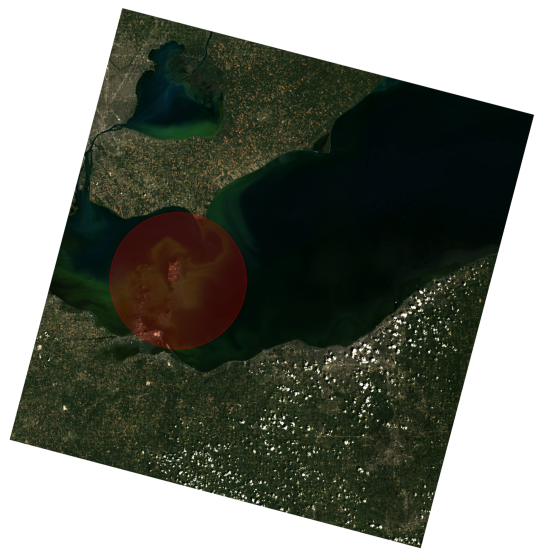

In [17]:
b4 = plt.imread(b.get('l8_red'))
b3 = plt.imread(b.get('l8_green'))
b2 = plt.imread(b.get('l8_blue'))

def scale_bands(array): 
    return array*2.75e-05 - 0.2    

b4 = scale_bands(b4)
b3 = scale_bands(b3)
b2 = scale_bands(b2)

b4_c = np.where(b4 == -0.2, 255, b4)
b3_c = np.where(b3 == -0.2, 255, b3)
b2_c = np.where(b2 == -0.2, 255, b2)
#b4 = b4*2.75e-05 - 0.2 
#b3 = b3*2.75e-05 - 0.2 
#b2 = b2*2.75e-05 - 0.2 

np_arr_b2 = np.expand_dims(b2_c, 2)
np_arr_b3 = np.expand_dims(b3_c, 2)
np_arr_b4 = np.expand_dims(b4_c, 2)

rgb_img = np.concatenate((np_arr_b4, np_arr_b3, np_arr_b2), 2)


fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(rgb_img*3, aspect='equal', cmap='gray')
ax.axis('off')
patch = patches.Circle((2500, 4000), radius=1000, transform=ax.transData, alpha=0.2, color='red')
ax.add_patch(patch)

In [18]:
del b2, b3, b4, b2_c, b3_c, b4_c, fig, ax, np_arr_b2, np_arr_b3, np_arr_b4

### 7.2.2 Plot com imagem original da área de interesse

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 1999.5, 1999.5, -0.5)

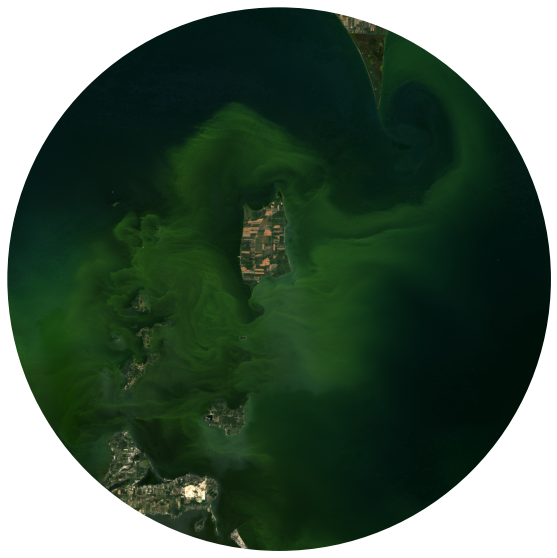

In [19]:
img_cropped = rgb_img[3000:5000, 1500:3500, :]
fig, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(img_cropped*4, aspect='equal', cmap='gray')
patch = patches.Circle((1000, 1000), radius=1000, transform=ax.transData)
im.set_clip_path(patch)
ax.axis('off')

## 7.3 Conversão das matrizes multidimensionais para dataframe

In [42]:
def scale_bands(array): 
    return array*2.75e-05 - 0.2 

c={}

for name in names_cols:
    arr = plt.imread(b.get(name))
    arr_tr = scale_bands(arr)
    crop_arr = arr_tr[3000:5000, 1500:3500]
    c[name] = crop_arr.flatten()
temp_df = pd.DataFrame(c)
a = WQP(temp_df, 0, 6, 1, 1)
temp_df = a.ndci(temp_df, 'l8_red', 'l8_nir')
temp_df = a.sabi(temp_df, 'l8_blue', 'l8_green', 'l8_red', 'l8_nir')
temp_df = a.two_three_band(temp_df, 'l8_green', 'l8_red', 'l8_nir')
temp_df = a.flh(temp_df, 'l8_blue', 'l8_green', 'l8_red')
temp_df.head()

,l8_blue,l8_green,l8_red,l8_nir,l8_swir1,l8_swir2,NDCI,SABI,2BDA,3BDA,FLH
0,0.010100,0.021265,-0.004282,-0.004998,0.003170,0.005123,0.077047,0.077047,1.166959,-1.401969,0.011165
1,0.010650,0.021375,-0.003787,-0.004530,0.003637,0.005480,0.089270,0.089270,1.196040,-1.407969,0.010725
2,0.012740,0.022585,-0.002303,-0.003183,0.004270,0.005645,0.160438,0.160438,1.382193,-1.523105,0.009845
3,0.014555,0.023960,-0.000625,-0.002138,0.004518,0.005397,0.547511,0.547511,3.420000,-3.509211,0.009405
4,0.015105,0.024537,0.000062,-0.001808,0.004215,0.005150,1.071633,1.071633,-28.920000,28.846337,0.009432


In [43]:
temp_df.shape

(4000000, 11)

In [44]:
temp_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4000000 entries, 0 to 3999999
Data columns (total 11 columns):
 #   Column    Dtype  
---  ------    -----  
 0   l8_blue   float64
 1   l8_green  float64
 2   l8_red    float64
 3   l8_nir    float64
 4   l8_swir1  float64
 5   l8_swir2  float64
 6   NDCI      float64
 7   SABI      float64
 8   2BDA      float64
 9   3BDA      float64
 10  FLH       float64
dtypes: float64(11)
memory usage: 335.7 MB


## 7.4 Modelos generalizados para os WQP

In [51]:
def img_wqp_plot(param_array, color, label, vmax):
    fig, ax = plt.subplots(figsize=(10, 10))
    im = ax.imshow(param_array.reshape(2000, 2000), aspect='equal', cmap=color, vmax=vmax)
    patch = patches.Circle((1000, 1000), radius=1000, transform=ax.transData)
    im.set_clip_path(patch)
    ax.axis('off')
    cbar = fig.colorbar(im, ax=ax, shrink=0.5, extend='both')
    cbar.ax.get_yaxis().labelpad = 15
    cbar.ax.set_ylabel(label, rotation=90)
    return plt.show()

### 7.4.1 Turbidez

In [54]:
X_cols = list(df_enh.columns[7:13]) + list(df_enh.columns[30:])
y_col = 'Turbidity (NTU)'


scaler = StandardScaler()

X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

rf_model = RandomForestRegressor()

params = df_model.loc[(df_model['index']=='Turbidity (NTU)') & (df_model['model']=='RandomForestRegressor'), 'params']

rf_model.set_params(**json.loads(params.values[0].replace("'", "\"")))

rf_model.fit(X, y)

X_predict = temp_df
y_pred = rf_model.predict(X_predict)

#temp_df['Turbidity (NTU)'] = y_pred

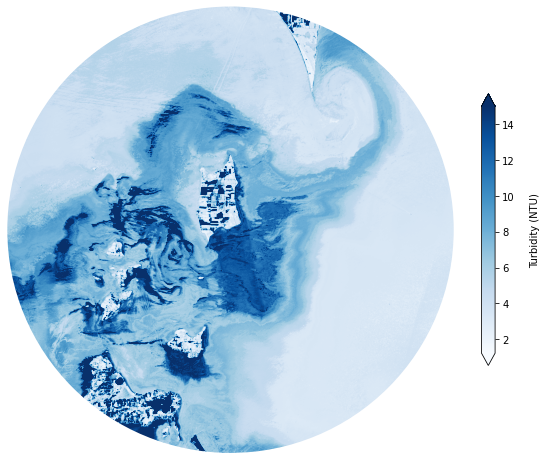

In [55]:
temp_arr = y_pred
img_wqp_plot(temp_arr, 'Blues', 'Turbidity (NTU)', 15)

### 7.4.2 CHLA

In [79]:
X_cols = list(df_enh.columns[7:13]) + list(df_enh.columns[30:])
y_col = 'Chla (µg/L)'


scaler = StandardScaler()

X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

svr_model = SVR()

params = df_model.loc[(df_model['index']=='Chla (µg/L)') & (df_model['model']=='SVR'), 'params']

svr_model.set_params(**json.loads(params.values[0].replace("'", "\"")))

svr_model.fit(X_scaled, y)

X_predict = temp_df
y_pred = svr_model.predict(X_predict)
#temp_df['Chla (µg/L)'] = y_pred

C:\ProgramData\Anaconda3\envs\geo_env\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but SVR was fitted without feature names
  warnings.warn(


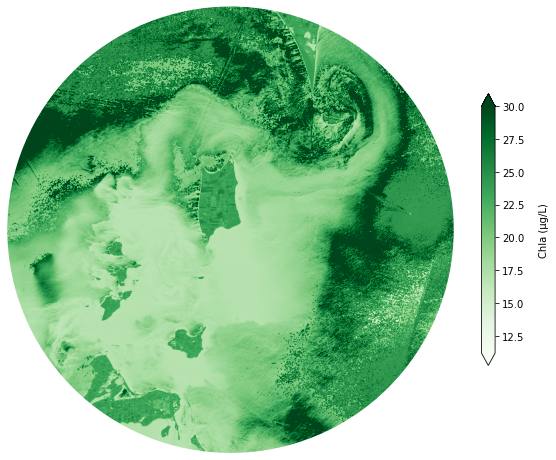

In [82]:
temp_arr = y_pred
img_wqp_plot(temp_arr, 'Greens', 'Chla (µg/L)', 30)

In [59]:
df_enh.columns

Index(['img_id', 'satellite', 'Site', 'Latitude (decimal deg)',
       'Longitude (decimal deg)', 'date', 'timestamp', 'l8_blue', 'l8_green',
       'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'l8_temp', 'l8_aerosol',
       'l8_pixel_qa', 'Date', 'Station Depth (m)', 'Sample Depth (m)',
       'Sample Depth (category)', 'Local Time (Eastern Time Zone)',
       'Wind speed (knots)', 'Wave Height (ft)', 'Sky', 'SDD (m)',
       'Turbidity (NTU)', 'Chla (µg/L)', 'CDOM 400 nm (m-1)', 'TSS (mg/L)',
       'geometry', 'NDCI', 'SABI', '2BDA', '3BDA', 'FLH'],
      dtype='object')

### 7.4.3 CDOM

In [65]:
X_cols = list(df_enh.columns[7:13]) + list(df_enh.columns[30:])
y_col = 'CDOM 400 nm (m-1)'


scaler = StandardScaler()

X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

xg_model = XGBRegressor()

params = df_model.loc[(df_model['index']=='CDOM at 400nm (m-1)') & (df_model['model']=='XGBRegressor'), 'params']

xg_model.set_params(**json.loads(params.values[0].replace("'", "\"")))

xg_model.fit(X, y)

X_predict = temp_df
y_pred = xg_model.predict(X_predict)



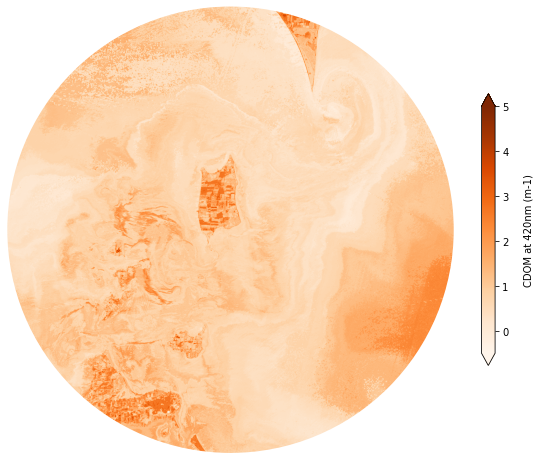

In [67]:
temp_arr = y_pred
img_wqp_plot(temp_arr, 'Oranges', 'CDOM at 420nm (m-1)', 5)

### 7.4.4 SDD

In [68]:
X_cols = list(df_enh.columns[7:13]) + list(df_enh.columns[30:])
y_col = 'SDD (m)'


scaler = StandardScaler()

X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

rf_model = RandomForestRegressor()

params = df_model.loc[(df_model['index']=='SDD (m)') & (df_model['model']=='RandomForestRegressor'), 'params']

rf_model.set_params(**json.loads(params.values[0].replace("'", "\"")))

rf_model.fit(X, y)

X_predict = temp_df
y_pred = rf_model.predict(X_predict)

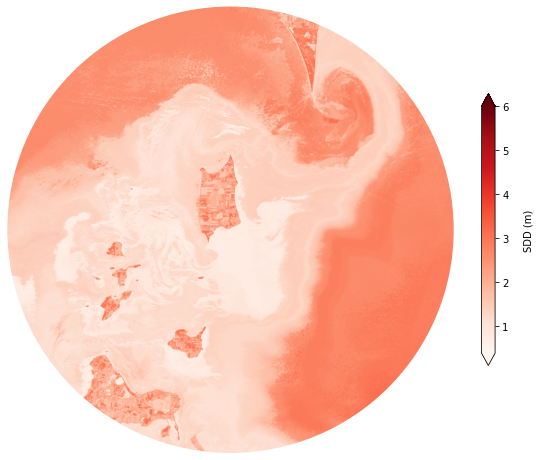

In [69]:
temp_arr = y_pred
img_wqp_plot(temp_arr, 'Reds', 'SDD (m)', 6)

### 7.4.5 TSS

In [75]:
X_cols = list(df_enh.columns[7:13]) + list(df_enh.columns[30:])
y_col = 'TSS (mg/L)'


scaler = StandardScaler()

X = df_enh.loc[:, X_cols]
X_scaled = scaler.fit_transform(X)
y = df_enh.loc[:, y_col]

mlp_model = MLPRegressor(hidden_layer_sizes = (6, 6), learning_rate='adaptive', max_iter=100000, solver='sgd', activation='tanh')

#params = df_model.loc[(df_model['index']=='TSS (mg/L)') & (df_model['model']=='MLPRegressor'), 'params']

#mlp_model.set_params(**json.loads(params.values[0].replace("'", "\"")))

mlp_model.fit(X_scaled, y)

X_predict = temp_df
y_pred = mlp_model.predict(X_predict)

C:\ProgramData\Anaconda3\envs\geo_env\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but MLPRegressor was fitted without feature names
  warnings.warn(


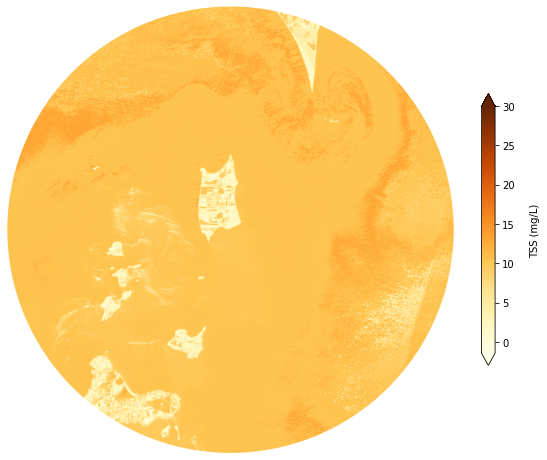

In [78]:
temp_arr = y_pred
img_wqp_plot(temp_arr, 'YlOrBr', 'TSS (mg/L)', 30)

## NÃO DEU CERTO -- TENTAR NOVAMENTE DEPOIS

In [233]:
'''import time



# Define parameters for the zonalStats function.
params_l8 = {
  'reducer': ee.Reducer.mean(),
  'scale': 30,
  'crs': 'EPSG:4326',
  'bands': ['SR_B2', 'SR_B3', 'SR_B4', 'SR_B5', 'SR_B6', 'SR_B7', 'ST_B10', 'SR_QA_AEROSOL', 'QA_PIXEL'],
  'bandsRename': ['l8_blue', 'l8_green', 'l8_red', 'l8_nir', 'l8_swir1', 'l8_swir2', 'l8_temp', 'l8_aerosol', 'l8_pixel_qa'],
  'imgProps': ['LANDSAT_PRODUCT_ID', 'SPACECRAFT_ID'],
  'imgPropsRename': ['img_id', 'satellite'],
  'datetimeName': 'date',
  'datetimeFormat': 'YYYY-MM-dd'
}


df_pull = pd.DataFrame()

for idx, s in df_m.iterrows():
    time.sleep(30)
    #defininig geometry

    geom=ee.Geometry.Point(json.loads("[{0}, {1}]".format(s['Longitude (decimal deg)'], s['Latitude (decimal deg)'])))

    ftr=ee.Feature(geom, json.loads("""{{"Site": "{0}", "index": "{1}"}}""".format(s['Site'], idx)))

    pts_mon = ee.FeatureCollection(ftr)

    pts_mon_buffer = pts_mon.map(lambda x: createBuffer(x, 900))

    # setting start and end date to look for images
    d_0 = pd.to_datetime(s.Date - pd.DateOffset(days=int(2)))
    d_1 = pd.to_datetime(s.Date + pd.DateOffset(days=int(2)))

    d_0 = str(d_0.year) + "-" + str(d_0.month) + "-" + str(d_0.day)
    d_1 = str(d_1.year) + "-" + str(d_1.month) + "-" + str(d_1.day)


    #setting image collection
    l8_col = ee.ImageCollection("LANDSAT/LC08/C02/T1_L2") \
                            .filterBounds(geom) \
                            .filterDate(d_0, d_1) \
                            .map(maskl8clouds)

    if l8_col.size().getInfo() == 0:
        print('No image')
        pass

    else:
        print('image')
        data_l8 = zonal_statistics(l8_col, pts_mon_buffer, params_l8)

    #print(data_l8.size().getInfo())
        if data_l8.size().getInfo() < 1:
            pass

        else:
            info = data_l8.getInfo()
            df_temp = pd.Series(info['features'][0]['properties']).to_frame().T
            df_pull = pd.concat([df_pull, df_temp], axis = 0)


df_pull'''

'import time\n\n\n\n# Define parameters for the zonalStats function.\nparams_l8 = {\n  \'reducer\': ee.Reducer.mean(),\n  \'scale\': 30,\n  \'crs\': \'EPSG:4326\',\n  \'bands\': [\'SR_B2\', \'SR_B3\', \'SR_B4\', \'SR_B5\', \'SR_B6\', \'SR_B7\', \'ST_B10\', \'SR_QA_AEROSOL\', \'QA_PIXEL\'],\n  \'bandsRename\': [\'l8_blue\', \'l8_green\', \'l8_red\', \'l8_nir\', \'l8_swir1\', \'l8_swir2\', \'l8_temp\', \'l8_aerosol\', \'l8_pixel_qa\'],\n  \'imgProps\': [\'LANDSAT_PRODUCT_ID\', \'SPACECRAFT_ID\'],\n  \'imgPropsRename\': [\'img_id\', \'satellite\'],\n  \'datetimeName\': \'date\',\n  \'datetimeFormat\': \'YYYY-MM-dd\'\n}\n\n\ndf_pull = pd.DataFrame()\n\nfor idx, s in df_m.iterrows():\n    time.sleep(30)\n    #defininig geometry\n\n    geom=ee.Geometry.Point(json.loads("[{0}, {1}]".format(s[\'Longitude (decimal deg)\'], s[\'Latitude (decimal deg)\'])))\n\n    ftr=ee.Feature(geom, json.loads("""{{"Site": "{0}", "index": "{1}"}}""".format(s[\'Site\'], idx)))\n\n    pts_mon = ee.FeatureCollecti